<hr style="border: solid 3px Indigo;">

# <center><span style="font-family:Arial; font-style: italic;">Term Project</span></center>

This notebook created by Team 14

***Team Members***  

*   Mohamed Bekheet Abdelall Mohamed 
*   Ali Amin El-Sayed Mahmoud El-Sherif
*   Omar Ashraf Fathy Ibrahim








## Table of Contents
* [Problem’s overview](#1)
* [Dataset’s overview](#2)
* [Exploratory Data Analysis (EDA)](#3)
* [Flowchart](#4)
* [Clean the dataset](#5)
* [Q1) Obtain a baseline performance](#6)
* [Q2) Compre dimensionality reduction to feature selection ](#7)
  - [Q2.1) Dimensionality reduction](#8)
  - [Q2.2) Feature selection](#9)
* [Q3) Vary the MLP parameters](#10)
  - [Q3.1) Batch size ](#11)
  - [Q3.2) Hidden layers vs. neurons/layer](#12)
  - [Q3.3) Learning rate and different optimizers](#13)
  - [Q3.4) Activation functions ](#14)
  - [Q3.5) Bonus question ](#15)
* [Conclusion](#16)






<hr style="border: solid 3px Brown;">
<a id="1"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Problem’s overview</span></center>


<hr style="border: solid 3px Brown;">
<a id="2"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Dataset’s overview</span></center>


<hr style="border: solid 3px Brown;">
<a id="3"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Exploratory Data Analysis (EDA)</span></center>


### import Liberaries 

In [ ]:
!pip install tensorflow
!pip install keras
!pip install tensorflow-addons

In [ ]:
import numpy as np
from numpy.ma.core import mean
import pandas as pd
import timeit
%matplotlib inline
import matplotlib.pyplot as plt 
import seaborn as sns
#import missingno as mn
import plotly.express as px
import plotly.graph_objects as go
from pandas_profiling import ProfileReport
from sklearn.linear_model import Perceptron 

from timeit import default_timer as timer

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report 
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

from sklearn.manifold import TSNE

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense
import tensorflow_addons as tfa
from sklearn.metrics import confusion_matrix
from sklearn import preprocessing
from sklearn.feature_selection import  mutual_info_classif
from sklearn.feature_selection import SelectKBest ,f_classif
from sklearn.decomposition import PCA
from tensorflow.keras.layers import LeakyReLU
import torch
from sklearn.preprocessing import MinMaxScaler
from keras.callbacks import EarlyStopping
from tqdm import tqdm
from imblearn.over_sampling import SMOTE

### load Dataset 

In [ ]:
df_train=pd.read_csv("/content/train.csv")
df_test=pd.read_csv("/content/test.csv")
df_val=pd.read_csv("/content/val.csv")

In [ ]:
df_train

,Switch ID,Port Number,Received Packets,Received Bytes,Sent Bytes,Sent Packets,Port alive Duration (S),Delta Received Packets,Delta Received Bytes,Delta Sent Bytes,Delta Sent Packets,Delta Port alive Duration (S),Connection Point,Total Load/Rate,Total Load/Latest,Unknown Load/Rate,Unknown Load/Latest,Latest bytes counter,Active Flow Entries,Packets Looked Up,Packets Matched,Label
0,of:0000000000000004,Port#:1,240,16586,12622603,467,126,0,0,280,2,5,1,0,0,0,0,0,4,819,757,TCP-SYN
1,of:0000000000000004,Port#:2,158,20530,35464,376,171,4,556,3407,43,5,2,0,0,0,0,0,5,1018,918,TCP-SYN
2,of:0000000000000008,Port#:3,1930,37881404,67857371,414333,1297,0,0,556,4,5,2,0,0,0,0,0,8,987400,987276,Normal
3,of:0000000000000001,Port#:4,903,18946410,17900326,98088,176,3,320,270280,5002,4,3,0,0,0,0,0,8,195879,195780,PortScan
4,of:000000000000000b,Port#:1,423,29020,19138042,1562,1451,0,0,560,4,5,1,0,0,0,0,0,4,4524,4411,Overflow
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2614,of:0000000000000008,Port#:1,646,18927937,26139,253,151,2,278,278,2,5,4,0,0,0,0,0,6,1563,1469,PortScan
2615,of:000000000000000b,Port#:2,3149,25488846,31784484,3205,2326,4,556,556,4,5,3,0,0,0,0,0,4,14774,14647,Blackhole
2616,of:000000000000000c,Port#:3,386,6324623,13285,97,101,27,526635,556,4,4,2,0,0,0,0,0,8,2688,2590,TCP-SYN
2617,of:000000000000000c,Port#:2,807,12638724,25268608,1238,366,47,3379,3939658,105,5,2,630355,6303550,630355,6303550,630355,6,3088,2976,Blackhole


In [ ]:
print("the number of rows are {} and number of columns are {} in train data ".format(df_train.shape[0],df_train.shape[1]))
print("the number of rows are {} and number of columns are {} in test data ".format(df_test.shape[0],df_test.shape[1]))
print("the number of rows are {} and number of columns are {} in validation data ".format(df_val.shape[0],df_val.shape[1]))


the number of rows are 2619 and number of columns are 22 in train data 
the number of rows are 561 and number of columns are 22 in test data 
the number of rows are 561 and number of columns are 22 in validation data 


In [ ]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2619 entries, 0 to 2618
Data columns (total 22 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   Switch ID                      2619 non-null   object
 1   Port Number                    2619 non-null   object
 2   Received Packets               2619 non-null   int64 
 3   Received Bytes                 2619 non-null   int64 
 4   Sent Bytes                     2619 non-null   int64 
 5   Sent Packets                   2619 non-null   int64 
 6   Port alive Duration (S)        2619 non-null   int64 
 7   Delta Received Packets         2619 non-null   int64 
 8   Delta Received Bytes           2619 non-null   int64 
 9   Delta Sent Bytes               2619 non-null   int64 
 10  Delta Sent Packets             2619 non-null   int64 
 11  Delta Port alive Duration (S)  2619 non-null   int64 
 12  Connection Point               2619 non-null   int64 
 13  Tot

### Nulls

In [ ]:
nulls=df_train.isnull().sum().to_dict()

In [ ]:
df_nulls=pd.DataFrame({'Features':nulls.keys(),'Numbers of nulls values':nulls.values()})

In [ ]:
df_nulls

,Features,Numbers of nulls values
0,Switch ID,0
1,Port Number,0
2,Received Packets,0
3,Received Bytes,0
4,Sent Bytes,0
5,Sent Packets,0
6,Port alive Duration (S),0
7,Delta Received Packets,0
8,Delta Received Bytes,0
9,Delta Sent Bytes,0


### Class distribution

In [ ]:
df_train.Label.value_counts()

PortScan     666
TCP-SYN      651
Blackhole    561
Diversion    414
Normal       254
Overflow      73
Name: Label, dtype: int64

In [ ]:
fig = go.Figure(data=[go.Pie(labels=df_train.Label.value_counts().keys(), values=df_train.Label.value_counts().values, hole=.3)],)
fig.show()

### Number of values for each column

In [ ]:
column_values={}
for col in df_train:
  column_values[col]=df_train[col].nunique()

In [ ]:
fig = go.Figure()
num_row=0
num_col=0
color=px.colors.qualitative.Plotly
for i in column_values:
  fig.add_trace(go.Indicator(
      mode = "number",
      value = column_values[i],
      title = {'text':i,'font': {'color':color[num_col] ,'size':10}},
      number={'font':{'color': color[num_col] ,'size':30}},
      domain = {'row': num_row, 'column': num_col}
  ))
  num_col+=1
  if num_col==5:
    num_row+=1
    num_col=0

fig.update_layout(
    grid = {'rows': 5, 'columns': 5, 'pattern': "independent"})
fig.show()

### Outliers

In [ ]:
def Outliers_num(X,remove=False):
    print('the columns has {} values'.format(X.shape[0]))
    if X.nunique()>5:
      Q1= X.quantile(0.25)
      Q3= X.quantile(0.75)

      iqr = Q3 - Q1

      range = iqr * 1.5
      
      min_value= Q1 - range
      max_value= Q3 + range
      print('The IQR is',iqr)
      print('The minimum bound value is', min_value)
      print('The upper bound value is', max_value)
      # Calculate the number of records below and above lower and above bound value respectively
      outliers_length=((X > max_value) | (X < min_value)).sum()
      print('numbers of outliers are', outliers_length)
      if remove: 
        X_r=X[(X < max_value) & (X > min_value)]
        return X_r
      return outliers_length
    else:
      print('the feature has less than 5 unique values :)')
      return 0


In [ ]:
numerical_column=list(df_train.iloc[:,2:-1].columns)

In [ ]:
outliers={}
lengthes=[]

for i in numerical_column:
  fig = px.histogram(df_train, x=i, marginal="box",title="histogram and Box plot to Detect the outliers of {} feature".format(i))
  
  fig.show()
  num=Outliers_num(df_train[i])
  outliers[i]=num
  lengthes.append(df_train[i].shape[0])

the columns has 2619 values
The IQR is 2947.0
The minimum bound value is -4099.0
The upper bound value is 7689.0
numbers of outliers are 312


the columns has 2619 values
The IQR is 37283203.5
The minimum bound value is -55840156.25
The upper bound value is 93292657.75
numbers of outliers are 186


the columns has 2619 values
The IQR is 31648577.5
The minimum bound value is -47419257.25
The upper bound value is 79175052.75
numbers of outliers are 222


the columns has 2619 values
The IQR is 3393.5
The minimum bound value is -4756.75
The upper bound value is 8817.25
numbers of outliers are 379


the columns has 2619 values
The IQR is 1585.0
The minimum bound value is -2241.5
The upper bound value is 4098.5
numbers of outliers are 0


the columns has 2619 values
The IQR is 4.0
The minimum bound value is -4.0
The upper bound value is 12.0
numbers of outliers are 649


the columns has 2619 values
The IQR is 553.0
The minimum bound value is -551.5
The upper bound value is 1660.5
numbers of outliers are 648


the columns has 2619 values
The IQR is 479.0
The minimum bound value is -438.5
The upper bound value is 1477.5
numbers of outliers are 604


the columns has 2619 values
The IQR is 3.0
The minimum bound value is -2.5
The upper bound value is 9.5
numbers of outliers are 604


the columns has 2619 values
the feature has less than 5 unique values :)


the columns has 2619 values
the feature has less than 5 unique values :)


the columns has 2619 values
The IQR is 0.0
The minimum bound value is 0.0
The upper bound value is 0.0
numbers of outliers are 396


the columns has 2619 values
The IQR is 0.0
The minimum bound value is 0.0
The upper bound value is 0.0
numbers of outliers are 501


the columns has 2619 values
The IQR is 0.0
The minimum bound value is 0.0
The upper bound value is 0.0
numbers of outliers are 396


the columns has 2619 values
The IQR is 0.0
The minimum bound value is 0.0
The upper bound value is 0.0
numbers of outliers are 501


the columns has 2619 values
The IQR is 0.0
The minimum bound value is 0.0
The upper bound value is 0.0
numbers of outliers are 396


the columns has 2619 values
The IQR is 3.0
The minimum bound value is 0.5
The upper bound value is 12.5
numbers of outliers are 152


the columns has 2619 values
The IQR is 19370.0
The minimum bound value is -26792.0
The upper bound value is 50688.0
numbers of outliers are 536


the columns has 2619 values
The IQR is 19261.0
The minimum bound value is -26744.5
The upper bound value is 50299.5
numbers of outliers are 536


In [ ]:
p=(np.array(list(outliers.values()),dtype='int')/np.array(lengthes))*100
output = [str(round(x,2))+' %' for x in p]

In [ ]:
df_outliers=pd.DataFrame({'column name': outliers.keys(),'number of values':lengthes,'number of outliers':outliers.values(),'percentage of outliers':output})

In [ ]:
df_outliers

,column name,number of values,number of outliers,percentage of outliers
0,Received Packets,2619,312,11.91 %
1,Received Bytes,2619,186,7.1 %
2,Sent Bytes,2619,222,8.48 %
3,Sent Packets,2619,379,14.47 %
4,Port alive Duration (S),2619,0,0.0 %
5,Delta Received Packets,2619,649,24.78 %
6,Delta Received Bytes,2619,648,24.74 %
7,Delta Sent Bytes,2619,604,23.06 %
8,Delta Sent Packets,2619,604,23.06 %
9,Delta Port alive Duration (S),2619,0,0.0 %


### Correlation between features

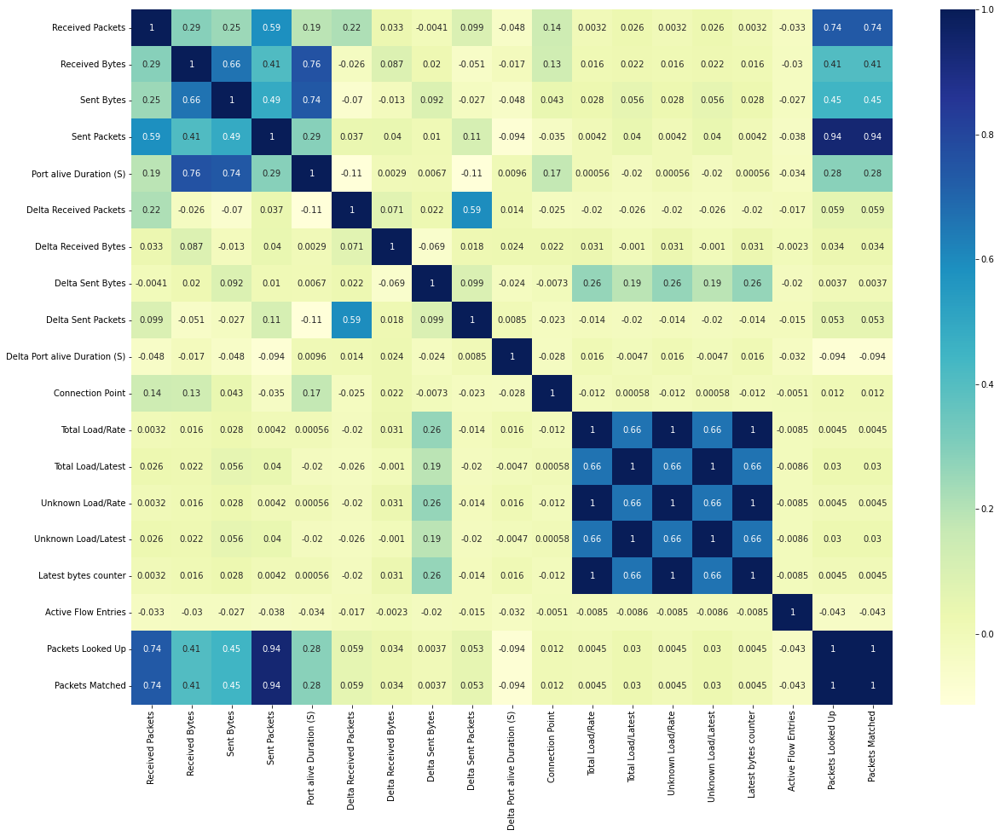

In [ ]:
plt.figure(figsize=(20, 15))
dataplot = sns.heatmap(df_train.iloc[:,2:-1].corr(), cmap="YlGnBu", annot=True)
  
# displaying heatmap
plt.show()

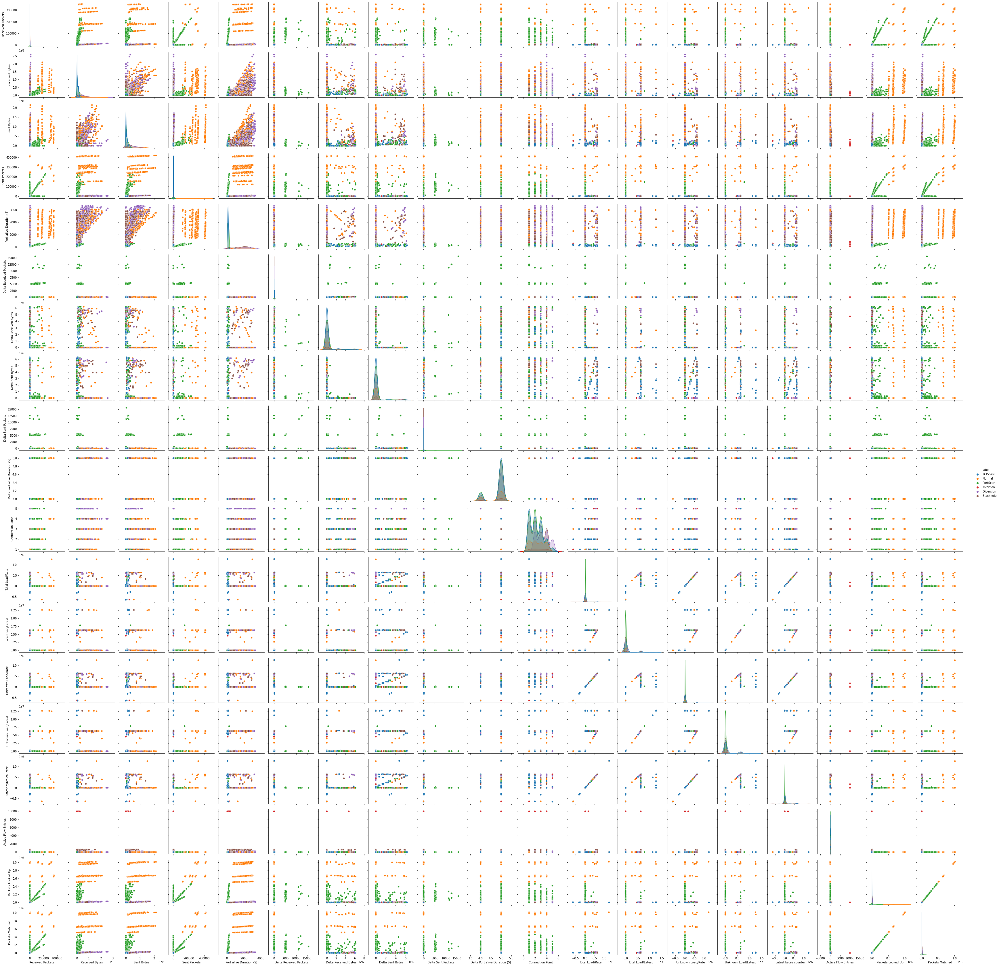

In [ ]:
sns.pairplot(df_train.iloc[:,2:], hue="Label")
plt.show()

### Statistical analysis for each feature

In [ ]:
des=df_train.describe().T
des[['min','max','mean','std']]

,min,max,mean,std
Received Packets,10.0,352584.0,1.992910e+04,6.181786e+04
Received Bytes,856.0,258942192.0,2.606639e+07,3.670801e+07
Sent Bytes,6025.0,213072768.0,2.372645e+07,3.309908e+07
Sent Packets,44.0,420806.0,3.367657e+04,9.056515e+04
Port alive Duration (S),26.0,3317.0,8.905391e+02,9.709168e+02
Delta Received Packets,0.0,15588.0,1.749488e+02,1.028908e+03
Delta Received Bytes,0.0,6171714.0,3.254661e+05,1.166624e+06
Delta Sent Bytes,278.0,6302910.0,2.957171e+05,1.107859e+06
Delta Sent Packets,2.0,15593.0,1.606079e+02,9.724840e+02
Delta Port alive Duration (S),4.0,5.0,4.831615e+00,3.742792e-01


### MinMax scaling

In [ ]:
scaler = MinMaxScaler()
df_train.iloc[:,2:-1] = scaler.fit_transform(df_train.iloc[:,2:-1])
df_val.iloc[:,2:-1] = scaler.transform(df_val.iloc[:,2:-1])
df_test.iloc[:,2:-1] = scaler.transform(df_test.iloc[:,2:-1])

In [ ]:
des=df_train.describe().T
des[['min','max','mean','std']]

,min,max,mean,std
Received Packets,0.0,1.0,0.056496,0.175333
Received Bytes,0.0,1.0,0.100662,0.141762
Sent Bytes,0.0,1.0,0.111329,0.155346
Sent Packets,0.0,1.0,0.079933,0.215241
Port alive Duration (S),0.0,1.0,0.262698,0.295022
Delta Received Packets,0.0,1.0,0.011223,0.066006
Delta Received Bytes,0.0,1.0,0.052735,0.189028
Delta Sent Bytes,0.0,1.0,0.046876,0.175777
Delta Sent Packets,0.0,1.0,0.010173,0.062375
Delta Port alive Duration (S),0.0,1.0,0.831615,0.374279


### Converting categorical features and labels into numeric values

In [ ]:
X_train=df_train.iloc[:,:-1]
y_train=df_train.iloc[:,-1]
X_val=df_val.iloc[:,:-1]
y_val=df_val.iloc[:,-1]
X_test=df_test.iloc[:,:-1]
y_test=df_test.iloc[:,-1]

In [ ]:
X_train=pd.get_dummies(X_train)
X_val=pd.get_dummies(X_val)
X_test=pd.get_dummies(X_test)

In [ ]:
X_train.shape


(2619, 35)

In [ ]:
l=y_train.unique()

In [ ]:
label_encoder = preprocessing.LabelEncoder()

In [ ]:
y_train= label_encoder.fit_transform(y_train)
y_val= label_encoder.transform(y_val)
y_test= label_encoder.transform(y_test)

In [ ]:
num_feature=35
num_class=6

In [ ]:
y_train=tf.keras.utils.to_categorical(
    y_train, num_classes=num_class, dtype='float32'
)
y_val=tf.keras.utils.to_categorical(
    y_val, num_classes=num_class, dtype='float32'
)
y_test=tf.keras.utils.to_categorical(
    y_test, num_classes=num_class, dtype='float32'
)

<hr style="border: solid 3px Brown;">
<a id="4"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Flowchart</span></center>


<hr style="border: solid 3px Brown;">
<a id="5"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Clean the dataset</span></center>


<hr style="border: solid 3px Brown;">
<a id="6"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Q1) Obtain a baseline performance</span></center>


In [ ]:
class MLP:
  def __init__(self,input_shape,num_class,epochs=10,num_hidden_layer=2,neurons_each_layer=10,act_f='relu',opt=None,batch_size=32,stop_early=False):
    self.input_shape=input_shape
    self.num_class=num_class
    self.epochs=epochs
    self.num_hidden_layer=num_hidden_layer
    self.neurons_each_layer=neurons_each_layer
    self.act_f=act_f
    if opt ==None:
      self.opt=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= 0.001)
    else:
      self.opt=opt
    self.batch_size=batch_size
    self.model=self.build_mlp()
    self.stop_early=stop_early

  def build_mlp(self):
    inputs = keras.Input(shape=self.input_shape)
    x = layers.Flatten()(inputs)
    for i in range(self.num_hidden_layer):
      if self.act_f=='LeakyRelu':

        x = layers.Dense(self.neurons_each_layer, activation=LeakyReLU())(x)
      else:
        x = layers.Dense(self.neurons_each_layer, activation=self.act_f)(x)

    outputs = layers.Dense(self.num_class, activation="softmax")(x)
    return keras.Model(inputs, outputs)
  def visualize(self):
    self.model.summary()
  def fit(self,X_train, y_train,x_valid=None,y_valid=None):
    # Compile model
    if x_valid is None:
      self.model.compile(loss="categorical_crossentropy", optimizer=self.opt, metrics=['accuracy'])
      self.train_hist=self.model.fit(X_train, y_train,epochs=self.epochs,batch_size=self.batch_size,verbose=1)
    else:
      self.model.compile(loss="categorical_crossentropy", optimizer=self.opt, metrics=['accuracy'])
      if self.stop_early:
        es = EarlyStopping(monitor='val_accuracy', mode='max', verbose=1, patience=40)
        self.train_hist=self.model.fit(X_train, y_train,epochs=self.epochs,batch_size=self.batch_size,verbose=1,validation_data=(x_valid,y_valid), callbacks=[es])
      else:
        self.train_hist=self.model.fit(X_train, y_train,epochs=self.epochs,batch_size=self.batch_size,verbose=1,validation_data=(x_valid,y_valid))

  
  def predict(self,X):
    return self.model.predict(X)

  def create_cm(self,y, y_pred,l):
    plt.figure(figsize=(15, 15))
    fig, ax = plt.subplots(figsize=(10, 10))
    ConfusionMatrixDisplay.from_predictions(
      y, y_pred,display_labels=list(l),ax=ax)

    plt.show()
  def tsne(self,X,y,title='TSNE plot'):
    plt.figure(figsize=(15, 15))
    tsne = TSNE(n_components=2, verbose=1, random_state=0)
    z = tsne.fit_transform(X)
    df = pd.DataFrame()
    df["y"] = y
    df["comp-1"] = z[:,0]
    df["comp-2"] = z[:,1]

    sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                  palette=sns.color_palette("hls", len(set(y))),
                  data=df).set(title=title)
    plt.show()
  def aggrate(self,ypred,y,l):
    y_pred_agg=np.array(ypred).sum(axis=0)
    y_pred=np.argmax(y_pred_agg,axis=1)
    y=np.argmax(y,axis=1)
    self.create_cm(y, y_pred,l)

  def trace(self):
    f=plt.subplot(1,2,1)
    f.figure.set_size_inches(20,10)
    plt.plot(self.train_hist.history['loss'],c='r')
    plt.plot(self.train_hist.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.grid()
    f=plt.subplot(1,2,2)
    f.figure.set_size_inches(20,10)
    plt.plot(self.train_hist.history['accuracy'],c='r')
    plt.plot(self.train_hist.history['val_accuracy'])
    plt.title('model Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.grid()  
    plt.show()

  def eval(self,X,y,l):
    y_pred=np.argmax(self.model.predict(X),axis=1)
    y=np.argmax(y,axis=1)
    acc=accuracy_score(y,y_pred)
    print("_________________________________________________________________________")
    print("The Test accuracy :",acc)
    print("_________________________________________________________________________")
    self.trace()
    self.create_cm(y, y_pred,l)
    print("_________________________________________________________________________")
    print(classification_report(y,y_pred,target_names=list(l)))
    print("_________________________________________________________________________")

  def acc(self,x,y):
    return 100*self.model.evaluate(x,y, verbose=0)[1]
    
  def over_multi_run(self,num,X_train, y_train,X_test,y_test,X_val,y_val,l):
    train_set=[]
    val_set=[]
    test_set=[]
    ypreds=[]
    names=['minimum Accuracy','maxmum Accuracy','average Accuracy']
    train=[]
    val=[]
    test=[]
    for i in range(num):
      self.model=self.build_mlp()
      if self.stop_early:
        self.fit(X_train, y_train,X_val,y_val)
      else:
        self.fit(X_train, y_train)
      acc=100*self.model.evaluate(X_train,y_train, verbose=0)[1]
      train_set.append(acc)
      y_pred=self.predict(X_test)   
      ypreds.append(y_pred)   
      acc=100*self.model.evaluate(X_test,y_test, verbose=0)[1]
      test_set.append(acc)
      acc=acc=100*self.model.evaluate(X_val,y_val, verbose=0)[1]
      val_set.append(acc)
    
    train.append(min(train_set))
    val.append(min(val_set))
    test.append(min(test_set))

    train.append(max(train_set))
    val.append(max(val_set))
    test.append(max(test_set))
    train.append(mean(train_set))
    val.append(mean(val_set))
    test.append(mean(test_set))

    f=plt.subplot(1,3,1)
    f.figure.set_size_inches(30,10)
    plt.plot(train_set, marker='o')
    plt.plot(range(0,num),[train[2]]*num,'r')

    plt.title('Accuracy over {} runs on validation set'.format(num))
    plt.ylabel('Accuracy')
    plt.xlabel('RUN')

    plt.legend(['train Accuracy', 'average train Accuracy']) 
    plt.grid()

    f=plt.subplot(1,3,2)
    f.figure.set_size_inches(30,10)
    plt.plot(test_set,marker='o')
    plt.plot(range(0,num),[test[2]]*num,'r')

    plt.title('Accuracy over {} runs on test set'.format(num))
    plt.ylabel('Accuracy')
    plt.xlabel('RUN')


    plt.legend(['Test Accuracy', 'average test Accuracy']) 
    plt.grid()

    f=plt.subplot(1,3,3)
    f.figure.set_size_inches(30,10)
    plt.plot(val_set,marker='o')
    plt.plot(range(0,num),[val[2]]*num,'r')

    plt.title('Accuracy over {} runs on validation set'.format(num))
    plt.ylabel('Accuracy')
    plt.xlabel('RUN')

    plt.legend(['Validation Accuracy', 'average Validation Accuracy']) 
    plt.grid()
    di = {'Accuracy': names, 'Train': train, 'Test': test,'Validation':val}  
    df = pd.DataFrame(di) 
    display(df)
    self.aggrate(ypreds,y_test,l)
    return df


### mlp baseline

In [ ]:
admw=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= 0.001)
base_model=MLP(num_feature,num_class,epochs=500,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=1,act_f='relu')

In [ ]:
base_model.fit(X_train,y_train,X_test,y_test)

Epoch 1/500
2619/2619 [==============================] - 4s 1ms/step - loss: 1.5133 - accuracy: 0.4131 - val_loss: 1.3576 - val_accuracy: 0.5633
Epoch 2/500
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3256 - accuracy: 0.5094 - val_loss: 1.3089 - val_accuracy: 0.4439
Epoch 3/500
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3119 - accuracy: 0.5204 - val_loss: 1.3097 - val_accuracy: 0.5971
Epoch 4/500
2619/2619 [==============================] - 4s 2ms/step - loss: 1.3127 - accuracy: 0.5284 - val_loss: 1.3106 - val_accuracy: 0.5882
Epoch 5/500
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3106 - accuracy: 0.5136 - val_loss: 1.3162 - val_accuracy: 0.6132
Epoch 6/500
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3144 - accuracy: 0.5170 - val_loss: 1.3068 - val_accuracy: 0.5865
Epoch 7/500
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3118 - accuracy: 0.5208 - val_loss: 1.3052 - val_ac

_________________________________________________________________________
The Test accuracy : 0.48128342245989303
_________________________________________________________________________
_________________________________________________________________________
              precision    recall  f1-score   support

     TCP-SYN       0.55      0.63      0.59       122
      Normal       1.00      0.07      0.12        90
    PortScan       1.00      1.00      1.00        49
    Overflow       0.00      0.00      0.00        17
   Diversion       0.36      0.99      0.53       127
   Blackhole       0.80      0.08      0.14       156

    accuracy                           0.48       561
   macro avg       0.62      0.46      0.40       561
weighted avg       0.67      0.48      0.39       561

_________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



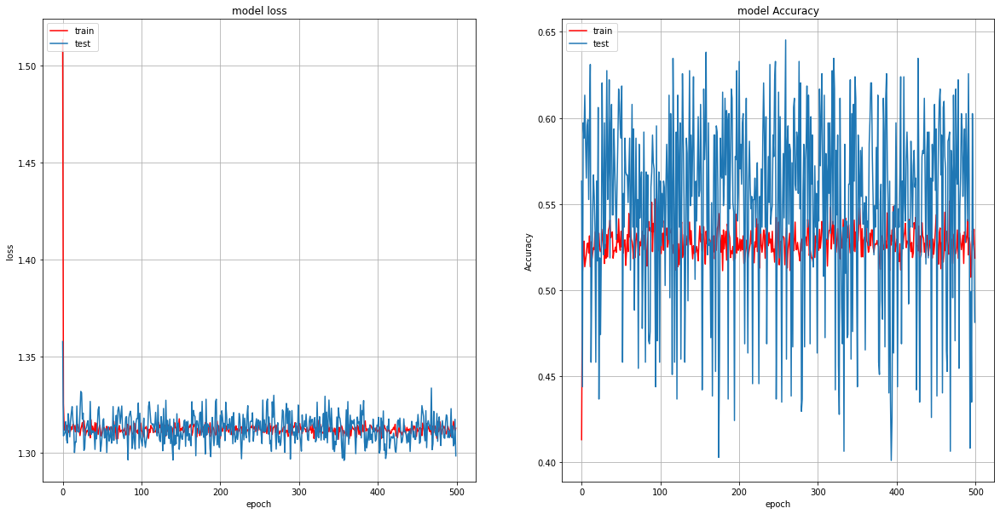

<Figure size 1080x1080 with 0 Axes>

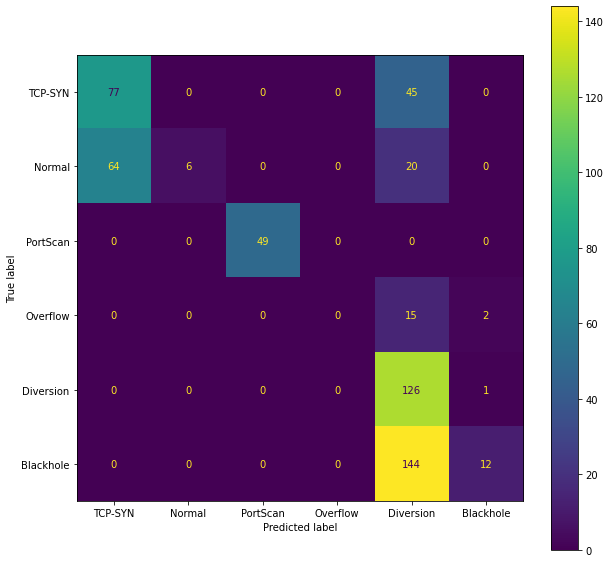

In [ ]:
base_model.eval(X_test,y_test,l)

In [ ]:
base_acc = base_model.acc(X_test,y_test)
base_acc

48.128342628479004

Streaming output truncated to the last 5000 lines.
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3699 - accuracy: 0.5300
Epoch 2/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3229 - accuracy: 0.5300
Epoch 3/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3241 - accuracy: 0.5246
Epoch 4/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3169 - accuracy: 0.5288
Epoch 5/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3153 - accuracy: 0.5128
Epoch 6/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3134 - accuracy: 0.5300
Epoch 7/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3109 - accuracy: 0.5395
Epoch 8/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3115 - accuracy: 0.5349
Epoch 9/500
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3099 - accuracy: 0.5315
Epoch 10/500
2619/2619 [==========

,Accuracy,Train,Test,Validation
0,minimum Accuracy,48.224512,51.158643,45.811051
1,maxmum Accuracy,57.617414,62.745100,57.219249
2,average Accuracy,53.463154,56.720144,52.156862


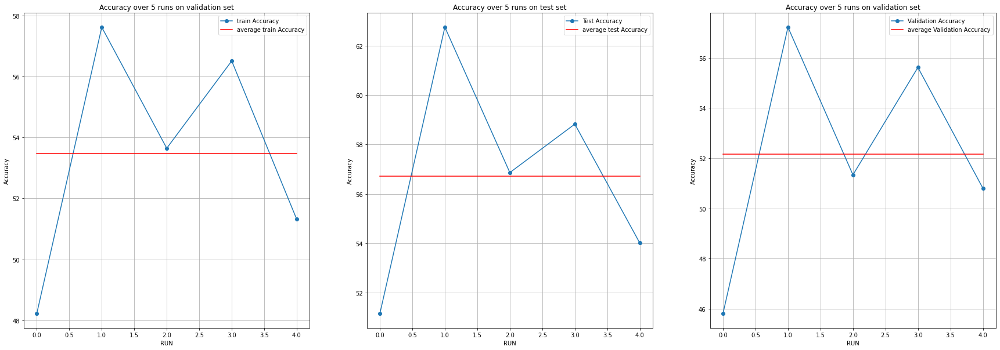

<Figure size 1080x1080 with 0 Axes>

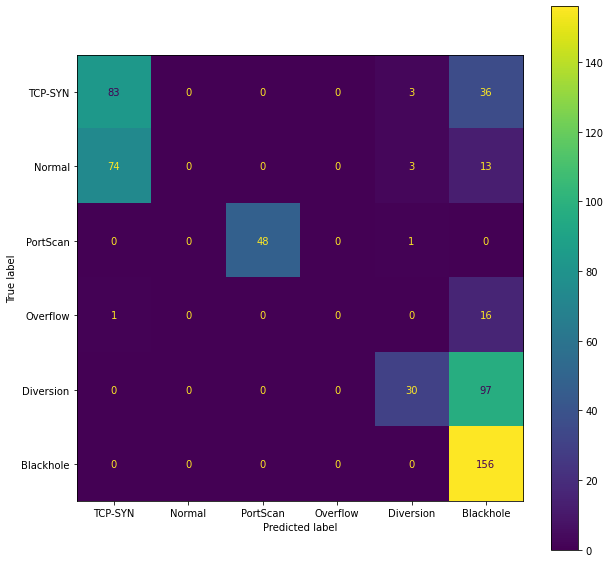

In [ ]:
base_model_multi=MLP(num_feature,num_class,epochs=500,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=1,act_f='relu')
df=base_model_multi.over_multi_run(5,X_train,y_train,X_test,y_test,X_val,y_val,l)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2619 samples in 0.000s...
[t-SNE] Computed neighbors for 2619 samples in 0.358s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2619
[t-SNE] Computed conditional probabilities for sample 2000 / 2619
[t-SNE] Computed conditional probabilities for sample 2619 / 2619
[t-SNE] Mean sigma: 0.431192
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.052834
[t-SNE] KL divergence after 1000 iterations: 0.230727


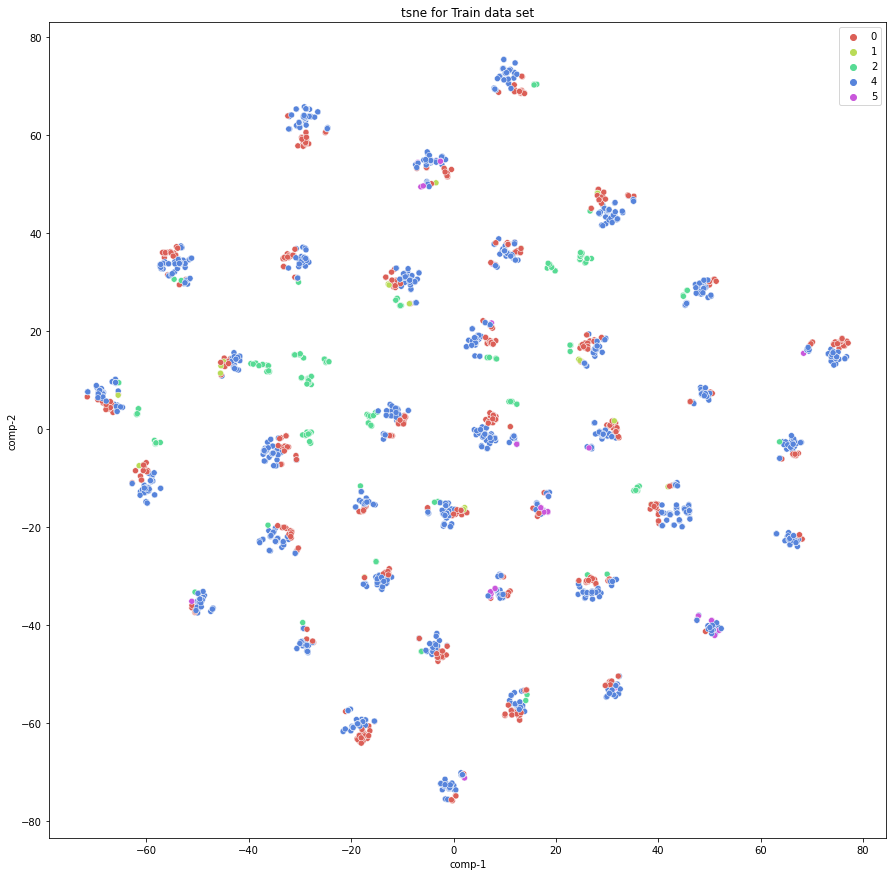

In [ ]:
y_pred=base_model.predict(X_train)
base_model.tsne(X_train,np.argmax(y_pred,axis=1),'tsne for Train data set')

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 561 samples in 0.000s...
[t-SNE] Computed neighbors for 561 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 561 / 561
[t-SNE] Mean sigma: 0.784796
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.907745
[t-SNE] KL divergence after 1000 iterations: 0.382885


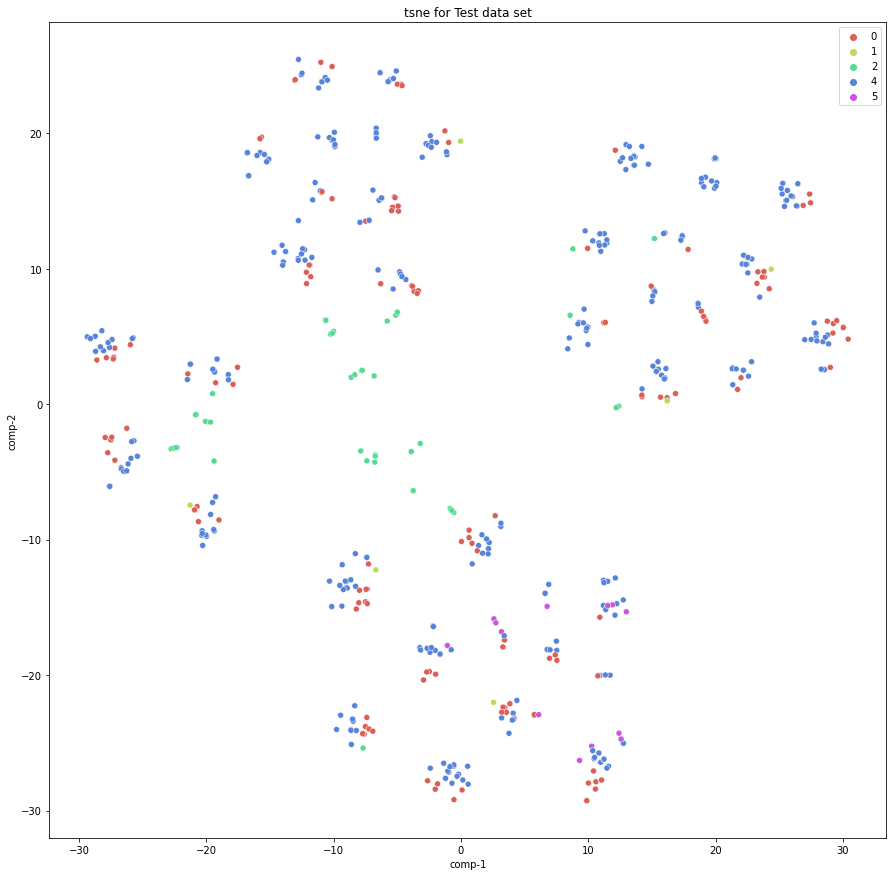

In [ ]:
y_pred=base_model.predict(X_test)
base_model.tsne(X_test,np.argmax(y_pred,axis=1),'tsne for Test data set')

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 561 samples in 0.001s...
[t-SNE] Computed neighbors for 561 samples in 0.013s...
[t-SNE] Computed conditional probabilities for sample 561 / 561
[t-SNE] Mean sigma: 0.774080
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.163902
[t-SNE] KL divergence after 1000 iterations: 0.370290


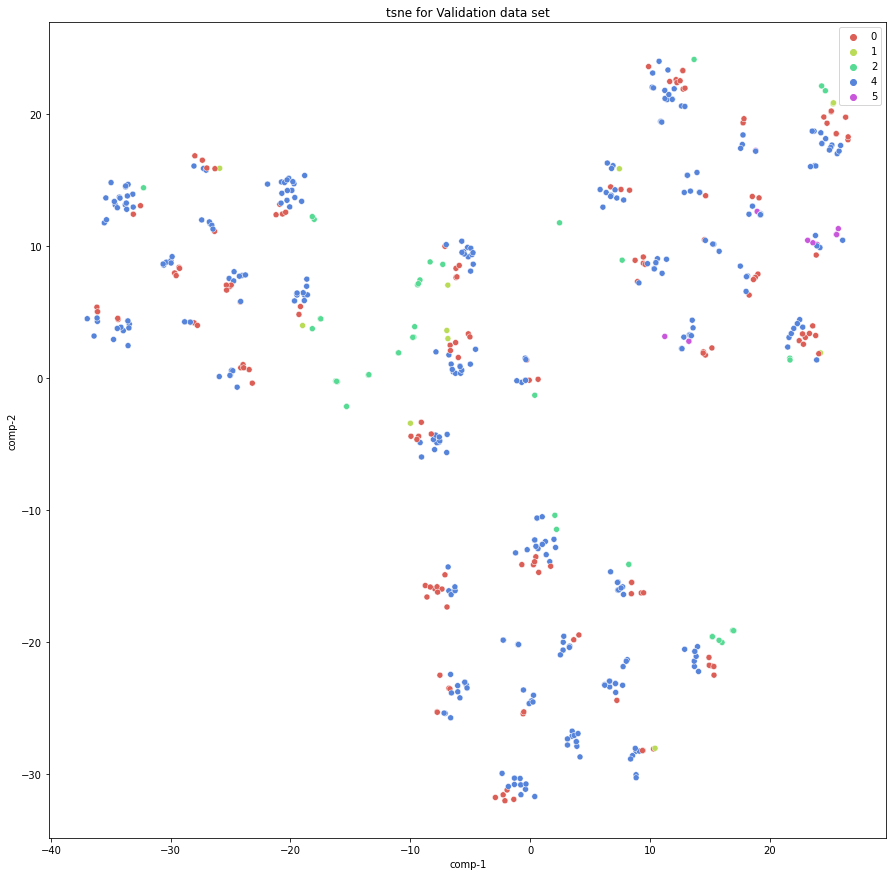

In [ ]:
y_pred=base_model.predict(X_val)
base_model.tsne(X_val,np.argmax(y_pred,axis=1),'tsne for Validation data set')

<hr style="border: solid 3px Brown;">
<a id="7"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Q2) Compre dimensionality reduction to feature selection</span></center>


## PCA

In [ ]:
def pca_methods(x_train,y_train,x_test,y_test,num_feature,old_acc):
  accuracy_scores= {}
  for i in range(1,num_feature+1):
    print("Run #{}".format(i))
    pca = PCA(n_components= i, random_state=0)
    x_train_pca = pca.fit_transform(X_train)
    x_test_pca = pca.transform(X_test)
    model=MLP(i,num_class,epochs=200,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=1,act_f='relu')
    model.fit(x_train_pca,y_train)
    acc_test=model.acc(x_test_pca,y_test)
    acc_train=model.acc(x_train_pca,y_train)
    accuracy_scores[i]=acc_test
    print('train acc: %.2f %% '%(acc_train))
    print('Test accuracy: %.2f %%'%(accuracy_scores[i]))
  best=max(accuracy_scores,key=accuracy_scores.get)
  fig = plt.figure(figsize=(15, 10))
  fig.suptitle('pca')
  plt.plot(list(accuracy_scores.keys()), [accuracy_scores[i] for i in accuracy_scores.keys()],c='b')
  plt.plot(range(1,num_feature), [old_acc]* (num_feature-1),c='r')
  plt.xlabel("dimension numbers")
  plt.ylabel("Test Accuracy %")
  plt.legend(['PCA Test Accuracy', 'Base_line Test Accuracy']) 
  plt.show() 
  accuracy_scores['baseLine']=old_acc
  fig = plt.figure(figsize=(15, 10))
  fig.suptitle('pca')
  ax=sns.barplot(x=list(accuracy_scores.keys()), y=[accuracy_scores[i] for i in accuracy_scores.keys()],color='b')
  plt.xlabel("Number of components")
  plt.ylabel("Test Accuracy %")
  #ax.set(ylim=(70, 80))
  plt.show() 
  print("The best number of features is {} and it achieves {} % ".format(best,accuracy_scores[best]))
  return best,accuracy_scores[best]

Streaming output truncated to the last 5000 lines.
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3356 - accuracy: 0.5086
Epoch 121/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3321 - accuracy: 0.5162
Epoch 122/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3354 - accuracy: 0.5258
Epoch 123/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3301 - accuracy: 0.5216
Epoch 124/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3353 - accuracy: 0.5204
Epoch 125/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3353 - accuracy: 0.5300
Epoch 126/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3306 - accuracy: 0.5281
Epoch 127/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3336 - accuracy: 0.5197
Epoch 128/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3380 - accuracy: 0.5162
Epoch 129/200
2619

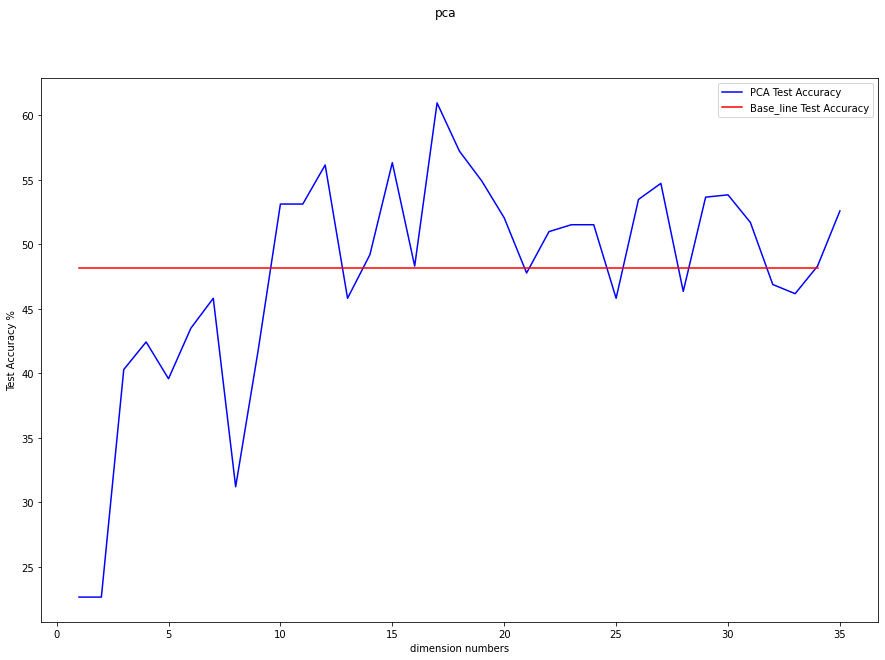

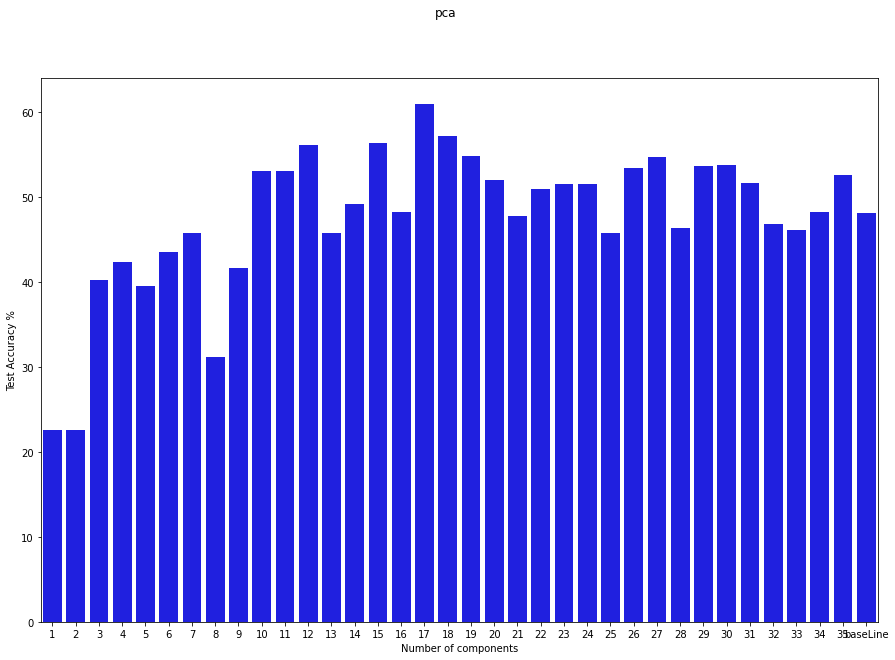

In [ ]:
best_features_pca,best_acc_Mpca=pca_methods(X_train,y_train,X_test,y_test,num_feature,base_acc)

### tsne

Epoch 1/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4484 - accuracy: 0.4593
Epoch 2/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3832 - accuracy: 0.4918
Epoch 3/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3803 - accuracy: 0.5082
Epoch 4/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3702 - accuracy: 0.5071
Epoch 5/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3712 - accuracy: 0.5155
Epoch 6/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3627 - accuracy: 0.5124
Epoch 7/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3639 - accuracy: 0.5067
Epoch 8/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3619 - accuracy: 0.5231
Epoch 9/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.3579 - accuracy: 0.5155
Epoch 10/200
2619/2619 [==============================] - 4s 1ms/step - l

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2619 samples in 0.001s...
[t-SNE] Computed neighbors for 2619 samples in 0.401s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2619
[t-SNE] Computed conditional probabilities for sample 2000 / 2619
[t-SNE] Computed conditional probabilities for sample 2619 / 2619
[t-SNE] Mean sigma: 0.347180
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.702488
[t-SNE] KL divergence after 1000 iterations: 0.211568
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 561 samples in 0.000s...
[t-SNE] Computed neighbors for 561 samples in 0.019s...
[t-SNE] Computed conditional probabilities for sample 561 / 561
[t-SNE] Mean sigma: 0.747106


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.662395
[t-SNE] KL divergence after 1000 iterations: 0.328803


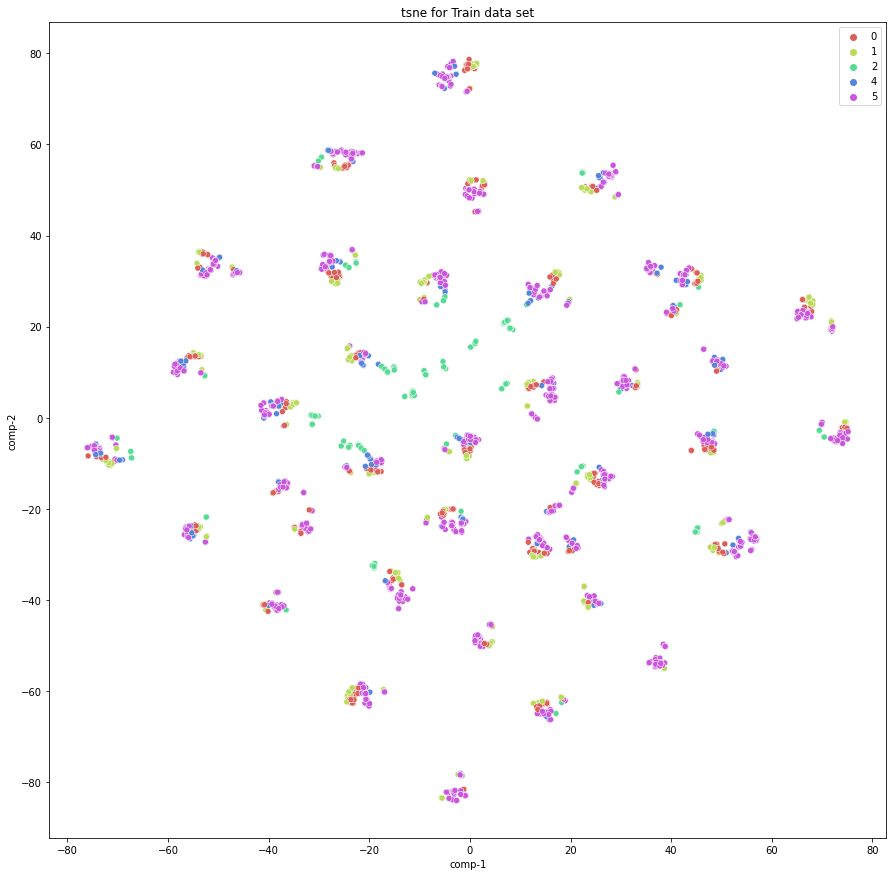

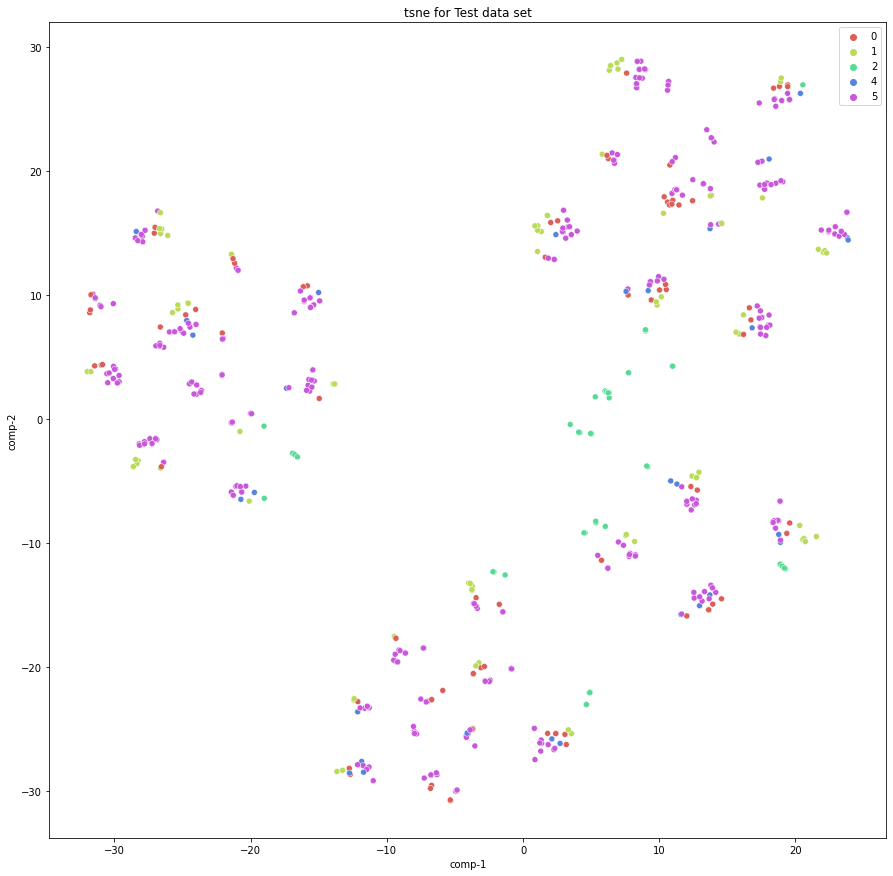

In [ ]:
pca = PCA(n_components= best_features_pca, random_state=0)
x_train_pca = pca.fit_transform(X_train)
x_test_pca = pca.transform(X_test)
x_val_pca = pca.transform(X_val)

model_pca=MLP(best_features_pca,num_class,epochs=200,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=1)

model_pca.fit(x_train_pca,y_train)

y_pred_test_PCA=model_pca.predict(x_test_pca)
y_pred_train=model_pca.predict(x_train_pca)

pca_val_acc=model_pca.acc(x_val_pca,y_val)

model_pca.tsne(x_train_pca,np.argmax(y_pred_train,axis=1),'tsne for Train data set')
model_pca.tsne(x_test_pca,np.argmax(y_pred_test_PCA,axis=1),'tsne for Test data set')

<Figure size 1080x1080 with 0 Axes>

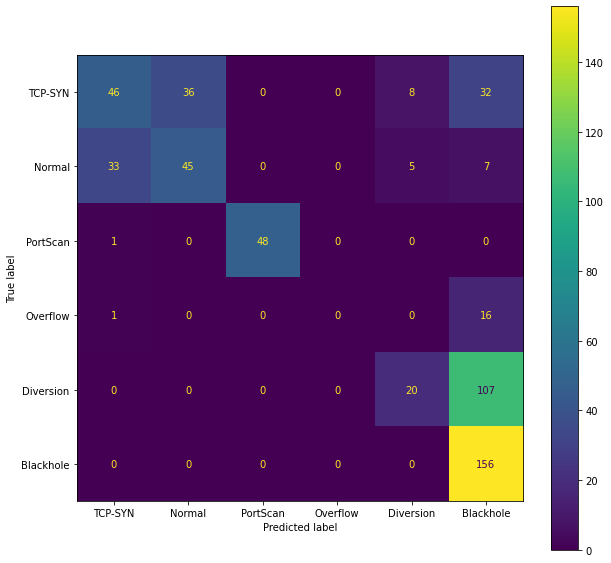

In [ ]:
model_pca.create_cm(np.argmax(y_test,axis=1), np.argmax(y_pred_test_PCA,axis=1),l)

In [ ]:
pca_val_acc

50.62388777732849

In [ ]:
pca_val_acc = 50.62388777732849

## Feature Selection

In [ ]:
def filter_methods(x_train,y_train,x_test,y_test,orig_labels,typ,num_feature,old_acc):
  opt=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= 0.001)
  if typ=='Mutual Information':
    models_acc={}
    feature_imp=mutual_info_classif(x_train,orig_labels,random_state=0)
    df=pd.Series(feature_imp)
    df.plot(kind='bar',color='teal')
    plt.show()
    feature_sorted=(-feature_imp).argsort()
    best_features=0
    m=0
    for i in range(1,num_feature+1):
      print("Run #{}".format(i))
      best_ind=feature_sorted[:i]
      mlp = keras.models.Sequential([
        Dense(10, activation='relu', input_shape=(i,)),
        Dense(6, activation='softmax')
        ])
      mlp.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
      h = mlp.fit(x_train.iloc[:,best_ind], y_train, epochs=200, batch_size=1)
      print('train acc: %.2f %% '%(h.history['accuracy'][-1]*100))
      models_acc[i] = 100*mlp.evaluate(x_test.iloc[:,best_ind],y_test)[1]
      print('Test accuracy: %.2f %%'%(models_acc[i]))
      if  models_acc[i]>m:
        best_features=best_ind
        m=models_acc[i]
    best=max(models_acc,key=models_acc.get)
    fig = plt.figure(figsize=(15, 10))
    fig.suptitle('Mutual Information features selection')
    plt.plot(list(models_acc.keys()), [models_acc[i] for i in models_acc.keys()],c='b')
    plt.plot(range(1,num_feature), [old_acc]* (num_feature-1),c='r')
    plt.xlabel("Number of features")
    plt.ylabel("Test Accuracy %")
    plt.legend(['Mutual Information Test Accuracy', 'Base_line Test Accuracy'])
    plt.show() 
    models_acc['baseLine']=old_acc
    fig = plt.figure(figsize=(15, 10))
    fig.suptitle('Mutual Information features selection')
    ax=sns.barplot(x=list(models_acc.keys()), y=[models_acc[i] for i in models_acc.keys()],color='b')
    plt.xlabel("Number of features")
    plt.ylabel("Test Accuracy %")
    #ax.set(ylim=(70, 80))
    plt.show() 
    print("The best number of features is {} and they are {} it achieves {} % ".format(best,best_features,models_acc[best]))
    return best_features,models_acc[best]

  elif typ=='ANOVA':
    models_acc={}
    for i in range(1,num_feature+1):
      print("Run #{}".format(i))
      anova = SelectKBest(f_classif, k=i) 
      anova.fit(X_train, orig_labels)
      mlp = keras.models.Sequential([
        Dense(10, activation='relu', input_shape=(i,)),
        Dense(6, activation='softmax')
        ])
      mlp.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])
      h = mlp.fit(anova.transform(x_train), y_train, epochs=200, batch_size=1)
      print('train acc: %.2f %% '%(h.history['accuracy'][-1]*100))
      models_acc[i] = 100*mlp.evaluate(anova.transform(x_test),y_test)[1]
      print('Test accuracy: %.2f %%'%(models_acc[i]))
    best=max(models_acc,key=models_acc.get)
    fig = plt.figure(figsize=(15, 10))
    fig.suptitle('Mutual Information features selection')
    plt.plot(list(models_acc.keys()), [models_acc[i] for i in models_acc.keys()],c='b')
    plt.plot(range(1,num_feature), [old_acc]* (num_feature-1),c='r')
    plt.xlabel("Number of features")
    plt.ylabel("Test Accuracy %")
    plt.legend(['ANOVA Test Accuracy', 'Base_line Test Accuracy'])    
    plt.show() 
    models_acc['baseLine']=old_acc
    fig = plt.figure(figsize=(15, 10))
    fig.suptitle('ANOVA features selection')
    ax=sns.barplot(x=list(models_acc.keys()), y=[models_acc[i] for i in models_acc.keys()],color='b')
    plt.xlabel("Number of features")
    plt.ylabel("Test Accuracy %")
    #ax.set(ylim=(70, 80))
    plt.show() 
    print("The best number of features is {} and it achieves {} % ".format(best,models_acc[best]))
    return best,models_acc[best]


Streaming output truncated to the last 5000 lines.
Epoch 127/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3342 - accuracy: 0.5231
Epoch 128/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3342 - accuracy: 0.5231
Epoch 129/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3380 - accuracy: 0.5155
Epoch 130/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3353 - accuracy: 0.5109
Epoch 131/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3362 - accuracy: 0.5116
Epoch 132/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3367 - accuracy: 0.5254
Epoch 133/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3359 - accuracy: 0.5155
Epoch 134/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3338 - accuracy: 0.5067
Epoch 135/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3364 - accuracy: 0.5307
Epoc

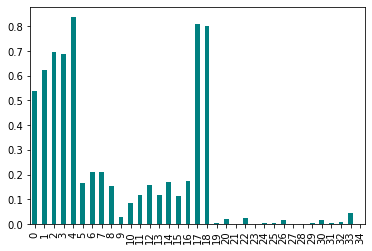

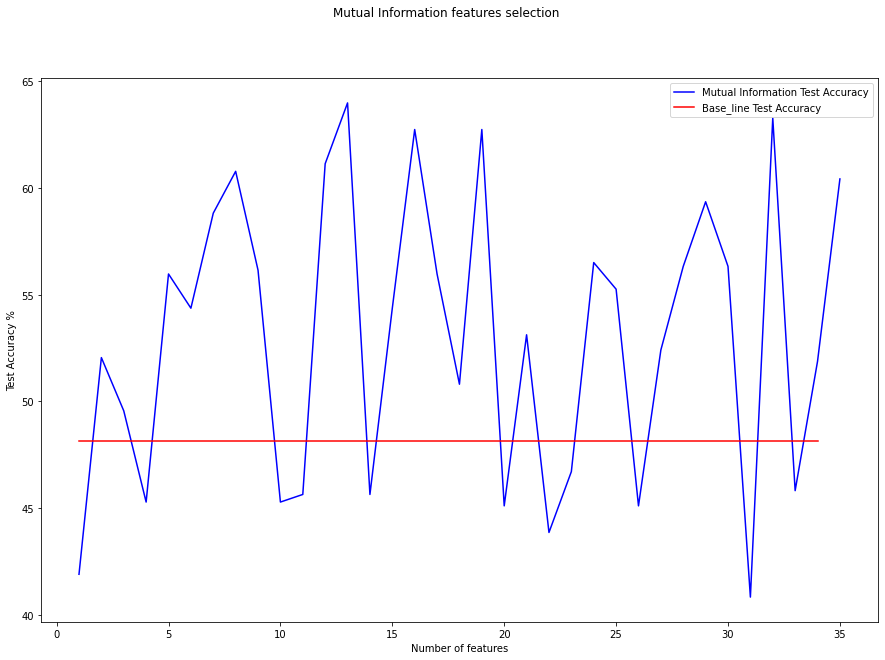

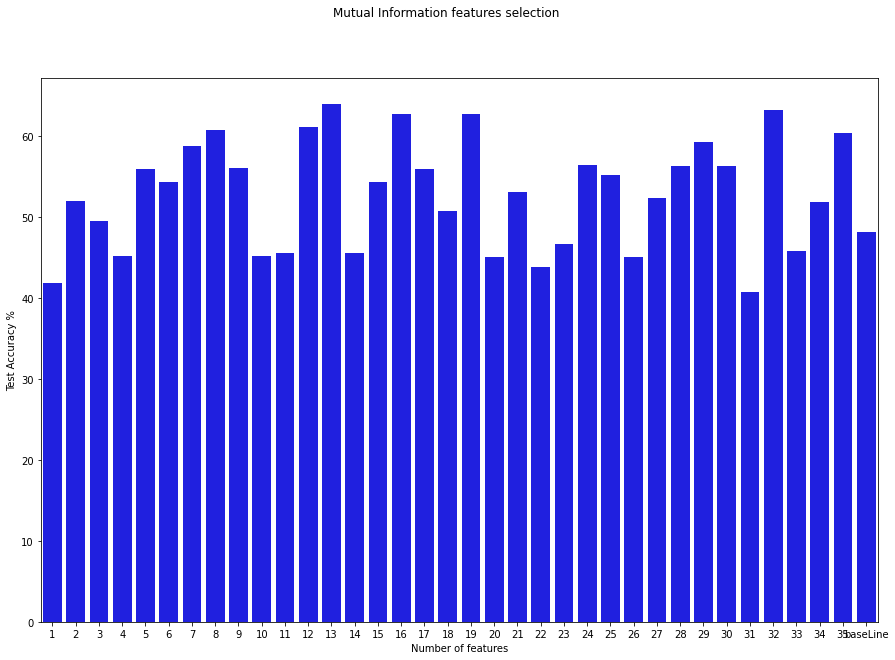

In [ ]:
best_features_MI,best_acc_MI=filter_methods(X_train,y_train,X_test,y_test,df_train.iloc[:,-1],'Mutual Information',num_feature,base_acc)

Epoch 1/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.4709 - accuracy: 0.5395
Epoch 2/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.3134 - accuracy: 0.5808
Epoch 3/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2983 - accuracy: 0.5640
Epoch 4/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2965 - accuracy: 0.5731
Epoch 5/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2988 - accuracy: 0.5850
Epoch 6/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2961 - accuracy: 0.5685
Epoch 7/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2989 - accuracy: 0.5716
Epoch 8/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2979 - accuracy: 0.5777
Epoch 9/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.2999 - accuracy: 0.5777
Epoch 10/200
2619/2619 [==============================] - 3s 1ms/step - l

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2619 samples in 0.005s...
[t-SNE] Computed neighbors for 2619 samples in 0.188s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2619
[t-SNE] Computed conditional probabilities for sample 2000 / 2619
[t-SNE] Computed conditional probabilities for sample 2619 / 2619
[t-SNE] Mean sigma: 0.007919
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.297119
[t-SNE] KL divergence after 1000 iterations: 0.443301
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 561 samples in 0.002s...
[t-SNE] Computed neighbors for 561 samples in 0.018s...
[t-SNE] Computed conditional probabilities for sample 561 / 561
[t-SNE] Mean sigma: 0.019718


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.887871
[t-SNE] KL divergence after 1000 iterations: 0.292074


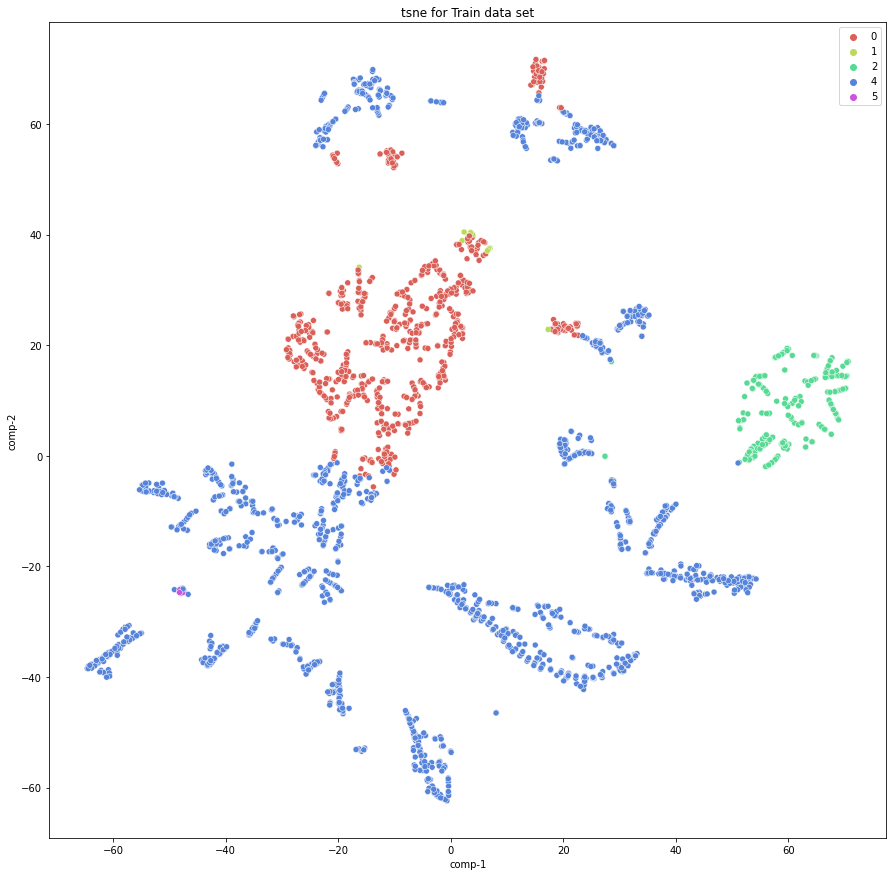

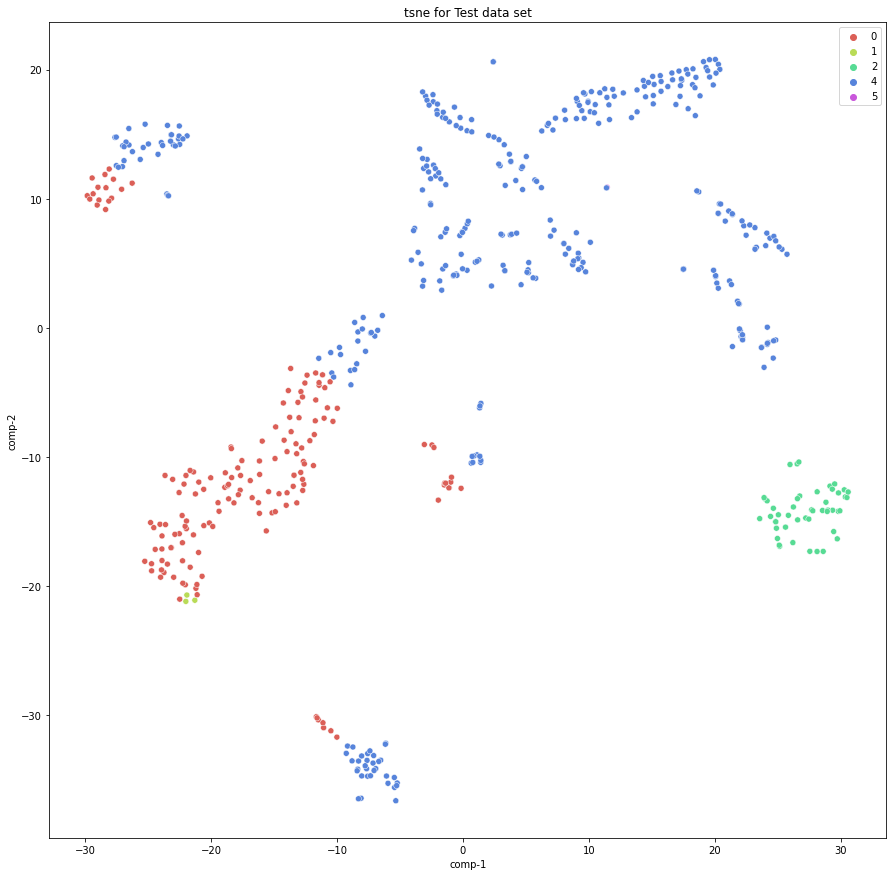

In [ ]:
admw=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= 0.001)
model_mi=MLP(len(best_features_MI),num_class,epochs=200,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=1)
model_mi.fit(X_train.iloc[:,best_features_MI],y_train)


y_pred_test_MI=model_mi.predict(X_test.iloc[:,best_features_MI])
y_pred_train=model_mi.predict(X_train.iloc[:,best_features_MI])

MI_val_acc=model_mi.acc(X_val.iloc[:,best_features_MI],y_val)

model_mi.tsne(X_train.iloc[:,best_features_MI],np.argmax(y_pred_train,axis=1),'tsne for Train data set')
model_mi.tsne(X_test.iloc[:,best_features_MI],np.argmax(y_pred_test_MI,axis=1),'tsne for Test data set')

<Figure size 1080x1080 with 0 Axes>

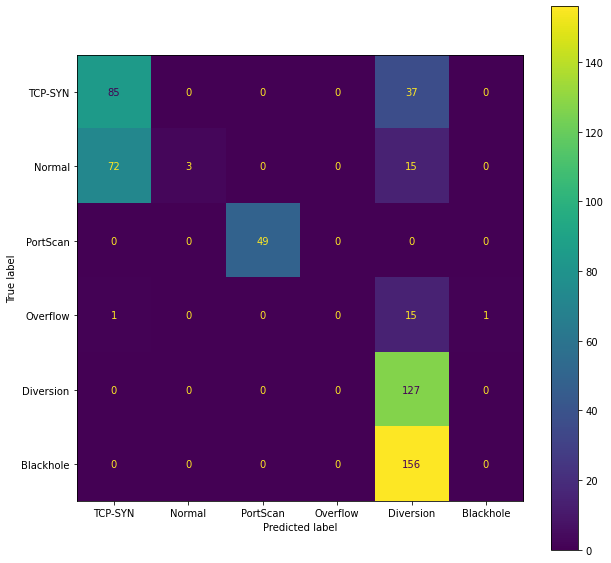

In [ ]:
model_mi.create_cm(np.argmax(y_test,axis=1), np.argmax(y_pred_test_MI,axis=1),l)

In [ ]:
MI_val_acc

51.69340372085571

In [ ]:
MI_val_acc = 51.69340372085571

In [ ]:
base_acc = 48.128342628479004

Streaming output truncated to the last 5000 lines.
Epoch 127/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4356 - accuracy: 0.4326
Epoch 128/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4320 - accuracy: 0.4353
Epoch 129/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4354 - accuracy: 0.4483
Epoch 130/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4361 - accuracy: 0.4368
Epoch 131/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4345 - accuracy: 0.4490
Epoch 132/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4326 - accuracy: 0.4349
Epoch 133/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4356 - accuracy: 0.4383
Epoch 134/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4346 - accuracy: 0.4422
Epoch 135/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4364 - accuracy: 0.4479
Epoc

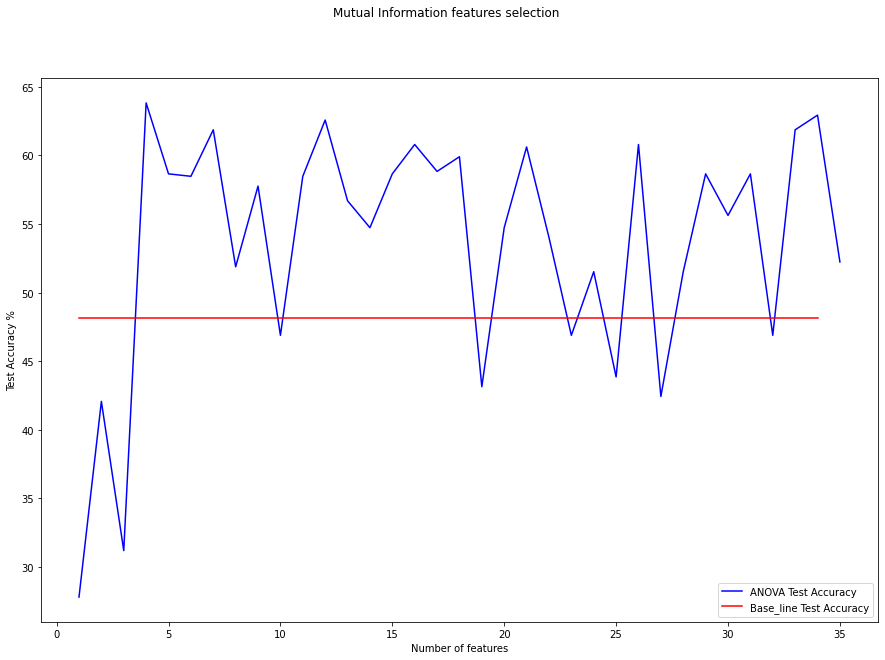

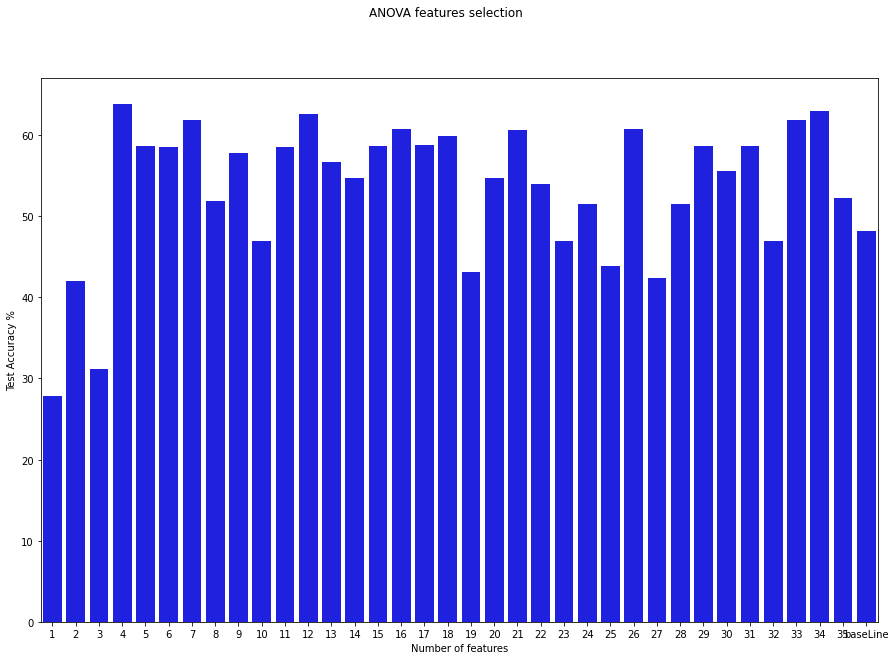

In [ ]:
best_features_AV,best_acc_AV=filter_methods(X_train,y_train,X_test,y_test,df_train.iloc[:,-1],'ANOVA',num_feature,base_acc)

Epoch 1/200
2619/2619 [==============================] - 4s 1ms/step - loss: 1.5929 - accuracy: 0.4842
Epoch 2/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4485 - accuracy: 0.5850
Epoch 3/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4199 - accuracy: 0.5525
Epoch 4/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4233 - accuracy: 0.5678
Epoch 5/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4254 - accuracy: 0.5643
Epoch 6/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4201 - accuracy: 0.5777
Epoch 7/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4259 - accuracy: 0.5682
Epoch 8/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4218 - accuracy: 0.5624
Epoch 9/200
2619/2619 [==============================] - 3s 1ms/step - loss: 1.4225 - accuracy: 0.5788
Epoch 10/200
2619/2619 [==============================] - 3s 1ms/step - l

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2619 samples in 0.003s...
[t-SNE] Computed neighbors for 2619 samples in 0.083s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2619
[t-SNE] Computed conditional probabilities for sample 2000 / 2619
[t-SNE] Computed conditional probabilities for sample 2619 / 2619
[t-SNE] Mean sigma: 0.002007
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.422478
[t-SNE] KL divergence after 1000 iterations: 0.291977
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 561 samples in 0.002s...
[t-SNE] Computed neighbors for 561 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 561 / 561
[t-SNE] Mean sigma: 0.005583


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.484741
[t-SNE] KL divergence after 1000 iterations: 0.180421


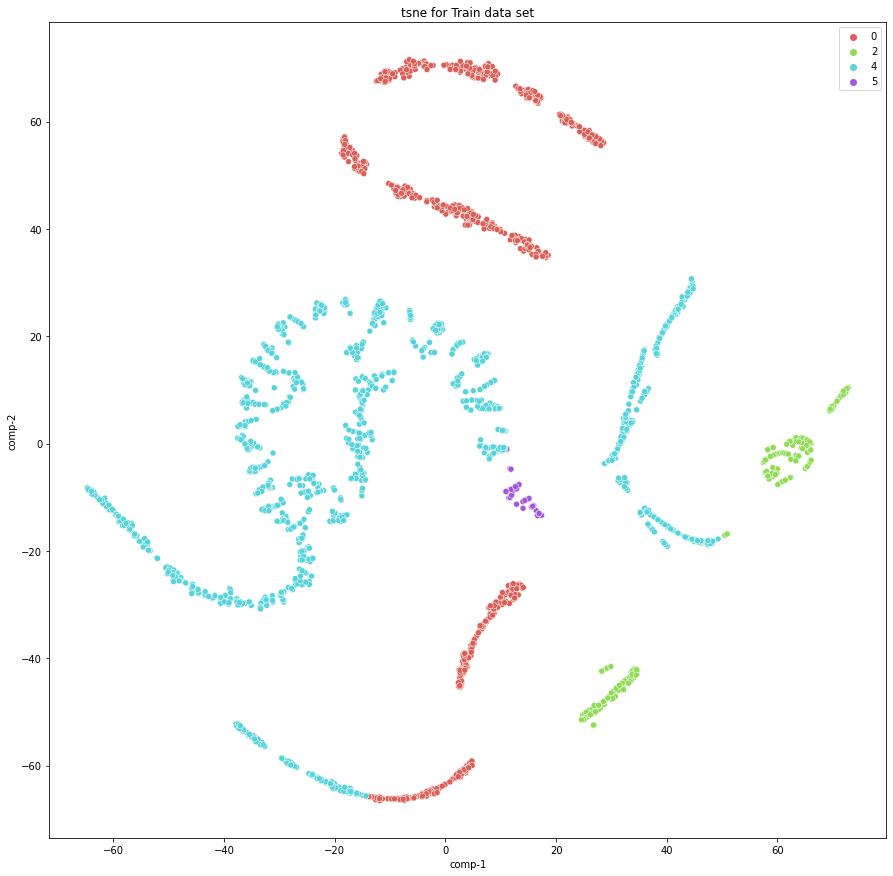

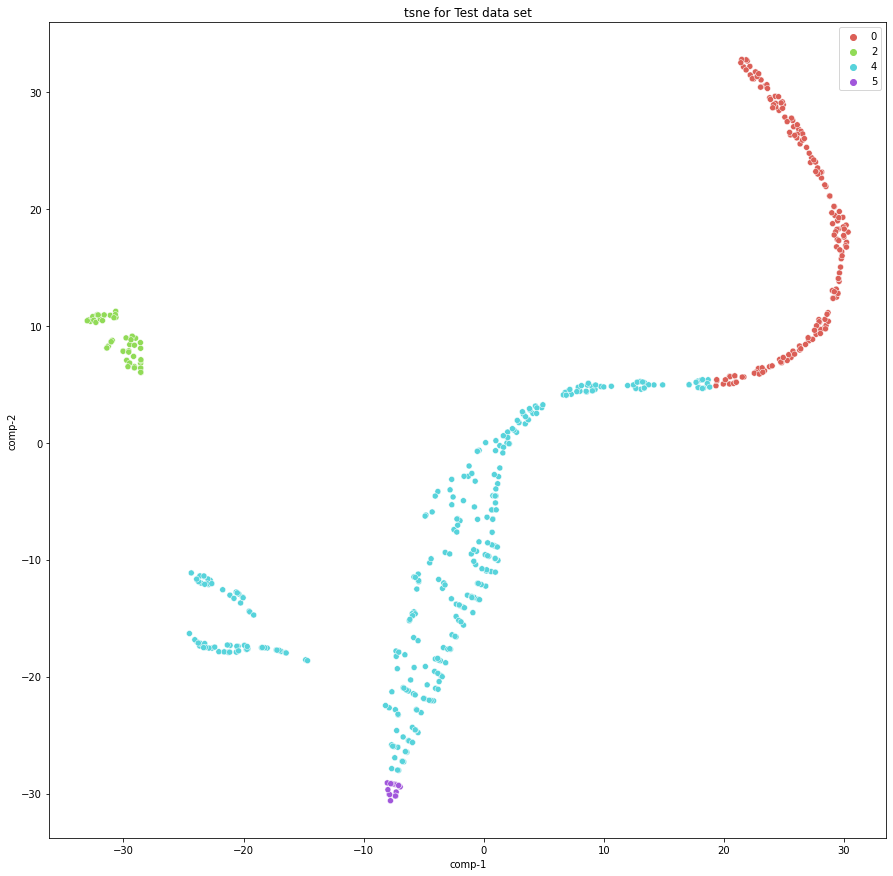

In [ ]:
anova = SelectKBest(f_classif, k=best_features_AV) 
ano_train=anova.fit_transform(X_train, np.argmax(y_train,axis=1))
ano_test=anova.transform(X_test)
ano_val=anova.transform(X_val)

admw=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= 0.001)
model_av=MLP(best_features_AV,num_class,epochs=200,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=1)

model_av.fit(ano_train,y_train)

y_pred_test_AV=model_av.predict(ano_test)
y_pred_train=model_av.predict(ano_train)

AV_val_acc=model_av.acc(ano_val,y_val)

model_av.tsne(ano_train,np.argmax(y_pred_train,axis=1),'tsne for Train data set')
model_av.tsne(ano_test,np.argmax(y_pred_test_AV,axis=1),'tsne for Test data set')

<Figure size 1080x1080 with 0 Axes>

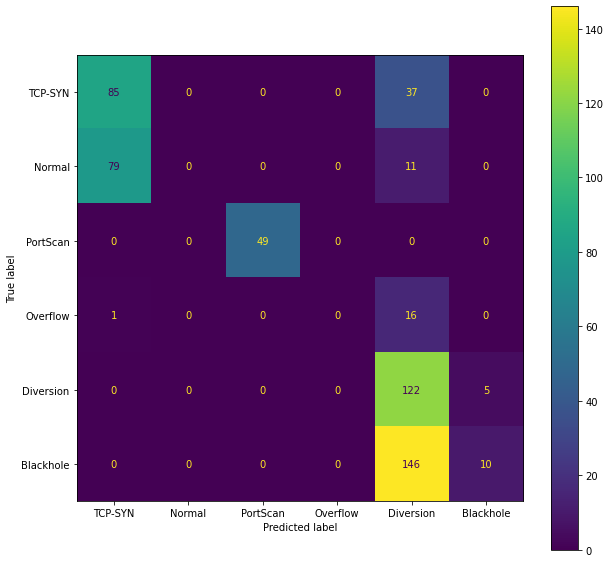

In [ ]:
model_av.create_cm(np.argmax(y_test,axis=1), np.argmax(y_pred_test_AV,axis=1),l)

In [ ]:
AV_val_acc

51.871657371520996

In [ ]:
print(' ANOVA validation Accuracy',AV_val_acc)
print(' Mutual validation Information Accuracy',MI_val_acc)
print(' PCA validation Accuracy',pca_val_acc)

 ANOVA validation Accuracy 51.871657371520996
 Mutual validation Information Accuracy 51.69340372085571
 PCA validation Accuracy 50.62388777732849


## update data

In [ ]:
anova = SelectKBest(f_classif, k=4) 
X_train_f=anova.fit_transform(X_train, np.argmax(y_train,axis=1))
X_test_f=anova.transform(X_test)
X_val_f=anova.transform(X_val)

<a id="9"></a> <br>

<hr style="border: solid 3px Brown;">
<a id="10[link text](https://)"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Q3) Vary the MLP parameters</span></center>


<a id="11"></a> <br>
### Q3.1) Batch size

Streaming output truncated to the last 5000 lines.
82/82 [==============================] - 1s 1ms/step - loss: 1.4344 - accuracy: 0.5922
Epoch 2/500
82/82 [==============================] - 0s 1ms/step - loss: 1.1845 - accuracy: 0.6571
Epoch 3/500
82/82 [==============================] - 0s 1ms/step - loss: 1.0949 - accuracy: 0.6510
Epoch 4/500
82/82 [==============================] - 0s 1ms/step - loss: 1.0483 - accuracy: 0.6243
Epoch 5/500
82/82 [==============================] - 0s 1ms/step - loss: 1.0206 - accuracy: 0.6350
Epoch 6/500
82/82 [==============================] - 0s 1ms/step - loss: 1.0025 - accuracy: 0.6342
Epoch 7/500
82/82 [==============================] - 0s 1ms/step - loss: 0.9909 - accuracy: 0.6315
Epoch 8/500
82/82 [==============================] - 0s 1ms/step - loss: 0.9819 - accuracy: 0.6331
Epoch 9/500
82/82 [==============================] - 0s 1ms/step - loss: 0.9765 - accuracy: 0.6289
Epoch 10/500
82/82 [==============================] - 0s 1ms/step - lo

,Accuracy,Train,Test,Validation
0,minimum Accuracy,62.008399,64.171124,63.636363
1,maxmum Accuracy,62.695688,64.884138,63.992870
2,average Accuracy,62.397863,64.491980,63.814616


Streaming output truncated to the last 5000 lines.
41/41 [==============================] - 0s 1ms/step - loss: 1.6432 - accuracy: 0.5082
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3889 - accuracy: 0.5349
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2367 - accuracy: 0.6037
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1454 - accuracy: 0.5682
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0894 - accuracy: 0.6235
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0526 - accuracy: 0.6250
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0274 - accuracy: 0.6239
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0095 - accuracy: 0.6296
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9965 - accuracy: 0.6273
Epoch 10/500
41/41 [==============================] - 0s 1ms/step - lo

,Accuracy,Train,Test,Validation
0,minimum Accuracy,61.855668,64.527631,63.814616
1,maxmum Accuracy,62.695688,64.705884,63.814616
2,average Accuracy,62.199312,64.598932,63.814616


Streaming output truncated to the last 5000 lines.
21/21 [==============================] - 0s 2ms/step - loss: 1.7021 - accuracy: 0.3242
Epoch 2/500
21/21 [==============================] - 0s 1ms/step - loss: 1.5648 - accuracy: 0.3589
Epoch 3/500
21/21 [==============================] - 0s 1ms/step - loss: 1.4574 - accuracy: 0.4876
Epoch 4/500
21/21 [==============================] - 0s 1ms/step - loss: 1.3640 - accuracy: 0.5055
Epoch 5/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2845 - accuracy: 0.5181
Epoch 6/500
21/21 [==============================] - 0s 1ms/step - loss: 1.2196 - accuracy: 0.5220
Epoch 7/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1672 - accuracy: 0.5739
Epoch 8/500
21/21 [==============================] - 0s 1ms/step - loss: 1.1259 - accuracy: 0.6292
Epoch 9/500
21/21 [==============================] - 0s 2ms/step - loss: 1.0929 - accuracy: 0.6315
Epoch 10/500
21/21 [==============================] - 0s 2ms/step - lo

,Accuracy,Train,Test,Validation
0,minimum Accuracy,62.237495,64.349377,63.636363
1,maxmum Accuracy,62.733871,65.062386,63.814616
2,average Accuracy,62.436045,64.598931,63.743315


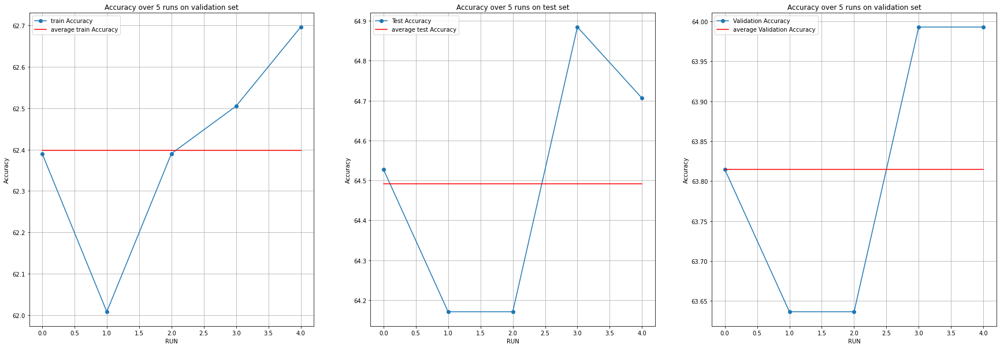

<Figure size 1080x1080 with 0 Axes>

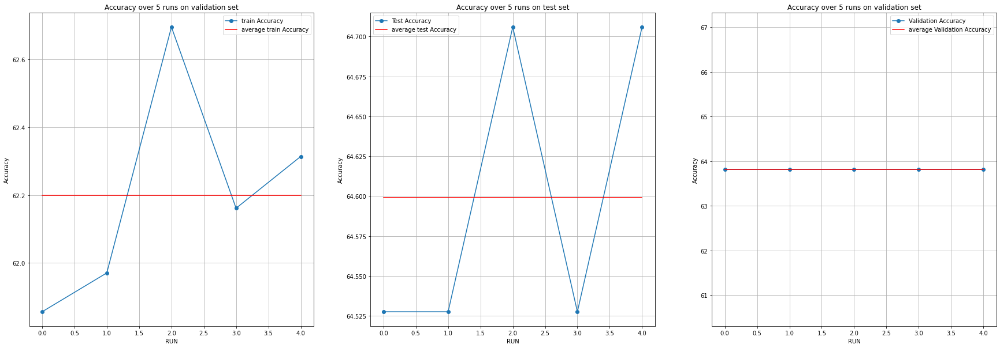

<Figure size 1080x1080 with 0 Axes>

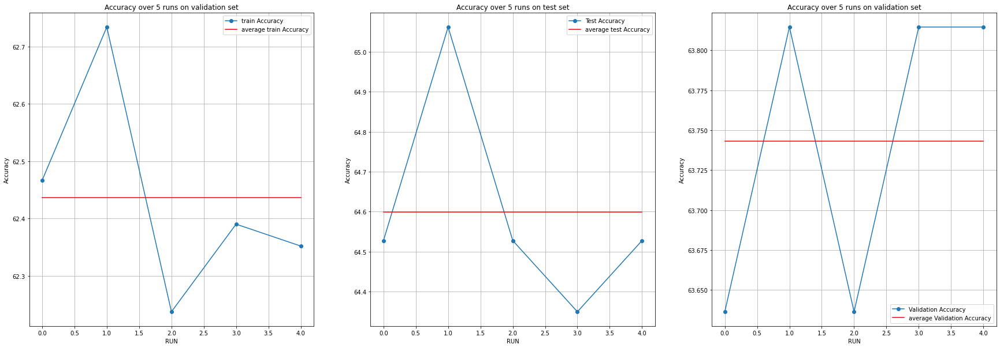

<Figure size 1080x1080 with 0 Axes>

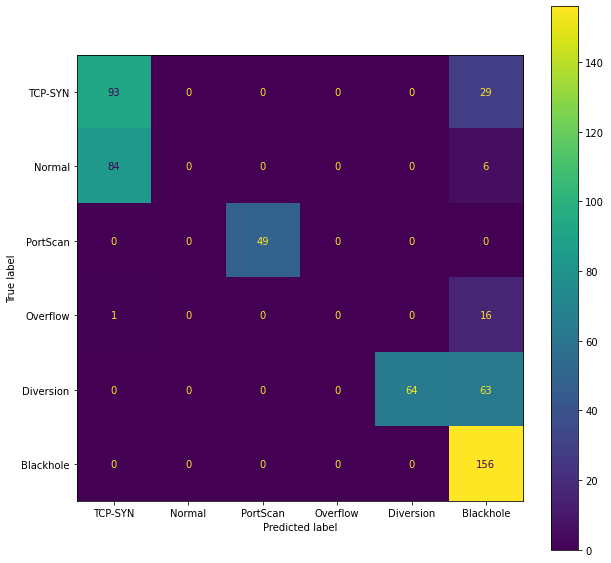

In [ ]:
mean_acccurcies=[]
batches_ls=[32,64,128]
batch_hist = []
for i in batches_ls:
  model=MLP(4,num_class,epochs=500,num_hidden_layer=1,neurons_each_layer=10,opt=admw,batch_size=i,act_f='relu')

  df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)

  mean_acccurcies.append(df.iloc[2,3])
  batch_hist.append(df)




In [ ]:
batch_hist[0]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,62.008399,64.171124,63.636363
1,maxmum Accuracy,62.695688,64.884138,63.992870
2,average Accuracy,62.397863,64.491980,63.814616


In [ ]:
batch_hist[1]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,61.855668,64.527631,63.814616
1,maxmum Accuracy,62.695688,64.705884,63.814616
2,average Accuracy,62.199312,64.598932,63.814616


In [ ]:
batch_hist[2]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,62.237495,64.349377,63.636363
1,maxmum Accuracy,62.733871,65.062386,63.814616
2,average Accuracy,62.436045,64.598931,63.743315


In [ ]:
best_bs=64

In [ ]:
print('the best batch size is {} and it achived {} % '.format(best_bs,max(mean_acccurcies)))

the best batch size is 64 and it achived 63.814616203308105 % 


<a id="12"></a> <br>
### Q3.2) Hidden layers vs. neurons/layer

Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 1ms/step - loss: 1.7833 - accuracy: 0.2795
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.7372 - accuracy: 0.3891
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6975 - accuracy: 0.3822
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6594 - accuracy: 0.3723
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6183 - accuracy: 0.3979
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5697 - accuracy: 0.4570
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5225 - accuracy: 0.4838
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4771 - accuracy: 0.4895
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4350 - accuracy: 0.4937
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,62.046582,64.527631,63.814616
1,maxmum Accuracy,62.924778,65.062386,64.171124
2,average Accuracy,62.649865,64.741534,64.028521


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 0s 1ms/step - loss: 1.7458 - accuracy: 0.3299
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6665 - accuracy: 0.4895
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5874 - accuracy: 0.4143
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5080 - accuracy: 0.4662
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4321 - accuracy: 0.4964
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3601 - accuracy: 0.5059
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2960 - accuracy: 0.5105
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2403 - accuracy: 0.4952
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1942 - accuracy: 0.5025
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,63.039327,64.884138,64.527631
1,maxmum Accuracy,65.368462,66.844922,67.023170
2,average Accuracy,63.604429,65.418895,65.098040


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 0s 1ms/step - loss: 1.7573 - accuracy: 0.3253
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6483 - accuracy: 0.4941
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5525 - accuracy: 0.5262
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4641 - accuracy: 0.5212
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3863 - accuracy: 0.5166
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3185 - accuracy: 0.5158
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2608 - accuracy: 0.5010
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2123 - accuracy: 0.6075
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1718 - accuracy: 0.6243
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,64.184803,66.488415,65.418893
1,maxmum Accuracy,66.704851,69.340461,67.914438
2,average Accuracy,65.589920,68.057040,66.916220


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 1ms/step - loss: 1.7509 - accuracy: 0.2447
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6582 - accuracy: 0.4284
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5669 - accuracy: 0.5048
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4707 - accuracy: 0.5514
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3758 - accuracy: 0.6086
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2911 - accuracy: 0.6457
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2201 - accuracy: 0.6300
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1627 - accuracy: 0.6231
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1170 - accuracy: 0.6228
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,65.597558,67.557931,66.844922
1,maxmum Accuracy,67.124856,69.875222,68.627453
2,average Accuracy,66.689576,69.197860,68.057042


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 1ms/step - loss: 1.7463 - accuracy: 0.2207
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6831 - accuracy: 0.3249
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6212 - accuracy: 0.3627
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5597 - accuracy: 0.4540
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4994 - accuracy: 0.4929
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4409 - accuracy: 0.5239
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3749 - accuracy: 0.5143
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3018 - accuracy: 0.5044
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2275 - accuracy: 0.5097
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,64.757544,67.557931,65.775400
1,maxmum Accuracy,66.170293,68.270946,67.914438
2,average Accuracy,65.330279,67.771835,66.559715


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7327 - accuracy: 0.4208
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6028 - accuracy: 0.4868
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4505 - accuracy: 0.5002
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3085 - accuracy: 0.5659
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1928 - accuracy: 0.6113
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1034 - accuracy: 0.6052
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0324 - accuracy: 0.6071
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9797 - accuracy: 0.6182
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9430 - accuracy: 0.6292
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.544866,69.875222,68.270946
1,maxmum Accuracy,68.232149,71.301246,69.162208
2,average Accuracy,67.850325,70.481284,68.841356


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7376 - accuracy: 0.3868
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5997 - accuracy: 0.5120
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4266 - accuracy: 0.5086
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.2313 - accuracy: 0.5128
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0681 - accuracy: 0.5197
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9702 - accuracy: 0.5968
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9171 - accuracy: 0.6460
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8848 - accuracy: 0.6518
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8637 - accuracy: 0.6457
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,65.788472,68.092692,66.844922
1,maxmum Accuracy,68.957615,71.657753,70.053476
2,average Accuracy,67.819778,69.875222,69.090909


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7098 - accuracy: 0.5483
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.5370 - accuracy: 0.5815
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3215 - accuracy: 0.5185
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1172 - accuracy: 0.5113
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9805 - accuracy: 0.6258
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9066 - accuracy: 0.6399
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8672 - accuracy: 0.6403
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8413 - accuracy: 0.6453
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8244 - accuracy: 0.6556
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.964870,69.340461,69.696969
1,maxmum Accuracy,69.263077,71.836007,69.875222
2,average Accuracy,68.461244,70.231729,69.803921


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7622 - accuracy: 0.4040
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6952 - accuracy: 0.4143
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.5900 - accuracy: 0.4181
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.4491 - accuracy: 0.4414
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 1.2934 - accuracy: 0.5200
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 1.1546 - accuracy: 0.5468
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0552 - accuracy: 0.5433
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9882 - accuracy: 0.5762
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9436 - accuracy: 0.5903
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,65.941197,68.449199,66.844922
1,maxmum Accuracy,67.659414,69.696969,68.805707
2,average Accuracy,67.086674,69.269161,68.199645


Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7510 - accuracy: 0.3498
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.6016 - accuracy: 0.4078
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3205 - accuracy: 0.4082
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0411 - accuracy: 0.5258
Epoch 5/500
41/41 [==============================] - 0s 1ms/step - loss: 0.9003 - accuracy: 0.6254
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8440 - accuracy: 0.6464
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8158 - accuracy: 0.6529
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7926 - accuracy: 0.6690
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7789 - accuracy: 0.6564
Epoch 10/500
41/41 [==============================] - 0s 1

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.103091,71.836007,71.301246
1,maxmum Accuracy,71.974033,75.401068,74.153298
2,average Accuracy,70.920198,73.547237,72.727273


run with 4hidden layers and30neurons
Epoch 1/500


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



41/41 [==============================] - 1s 2ms/step - loss: 1.6885 - accuracy: 0.4013
Epoch 2/500
41/41 [==============================] - 0s 1ms/step - loss: 1.3977 - accuracy: 0.5139
Epoch 3/500
41/41 [==============================] - 0s 1ms/step - loss: 1.0258 - accuracy: 0.5330
Epoch 4/500
41/41 [==============================] - 0s 1ms/step - loss: 0.8603 - accuracy: 0.6105
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8055 - accuracy: 0.6636
Epoch 6/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7752 - accuracy: 0.6644
Epoch 7/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7597 - accuracy: 0.6728
Epoch 8/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7475 - accuracy: 0.6705
Epoch 9/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7418 - accuracy: 0.6697
Epoch 10/500
41/41 [==============================] - 0s 1ms/step - loss: 0.7372 - accuracy: 0.6781
Epoch 11/500
41/41 [=

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.141274,71.836007,72.014260
1,maxmum Accuracy,72.279495,75.935829,74.509805
2,average Accuracy,70.767468,73.440285,73.012478


run with 4hidden layers and40neurons
Epoch 1/500


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



41/41 [==============================] - 1s 2ms/step - loss: 1.6617 - accuracy: 0.4429
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.3013 - accuracy: 0.5212
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8975 - accuracy: 0.6449
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8008 - accuracy: 0.6571
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7641 - accuracy: 0.6560
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7527 - accuracy: 0.6686
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7388 - accuracy: 0.6690
Epoch 8/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7325 - accuracy: 0.6648
Epoch 9/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7250 - accuracy: 0.6766
Epoch 10/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7213 - accuracy: 0.6781
Epoch 11/500
41/41 [=

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.797635,72.549021,71.301246
1,maxmum Accuracy,72.203130,75.222814,74.866313
2,average Accuracy,71.233294,74.046346,73.547238


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7591 - accuracy: 0.2486
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6516 - accuracy: 0.2486
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.4561 - accuracy: 0.3528
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 1.2737 - accuracy: 0.4311
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 1.1425 - accuracy: 0.4689
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 1.0841 - accuracy: 0.4811
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 1.0498 - accuracy: 0.5162
Epoch 8/500
41/41 [==============================] - 0s 2ms/step - loss: 1.0229 - accuracy: 0.5311
Epoch 9/500
41/41 [==============================] - 0s 2ms/step - loss: 1.0019 - accuracy: 0.5544
Epoch 10/500
41/41 [==============================] - 0s 2

,Accuracy,Train,Test,Validation
0,minimum Accuracy,66.132110,68.627453,67.557931
1,maxmum Accuracy,69.263077,71.657753,70.766491
2,average Accuracy,67.804505,70.017825,68.770053


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7538 - accuracy: 0.2841
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.5357 - accuracy: 0.3116
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.2048 - accuracy: 0.4402
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9695 - accuracy: 0.5724
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8515 - accuracy: 0.6243
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7937 - accuracy: 0.6464
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7556 - accuracy: 0.6663
Epoch 8/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7400 - accuracy: 0.6770
Epoch 9/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7299 - accuracy: 0.6670
Epoch 10/500
41/41 [==============================] - 0s 2

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.217639,70.944744,71.479499
1,maxmum Accuracy,72.355860,75.222814,73.796791
2,average Accuracy,71.179839,73.404634,72.549019


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.7319 - accuracy: 0.4532
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.1311 - accuracy: 0.5430
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8146 - accuracy: 0.6163
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7609 - accuracy: 0.6659
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7437 - accuracy: 0.6598
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7247 - accuracy: 0.6693
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7139 - accuracy: 0.6796
Epoch 8/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7138 - accuracy: 0.6682
Epoch 9/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7098 - accuracy: 0.6774
Epoch 10/500
41/41 [==============================] - 0s 2

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.301260,68.627453,70.053476
1,maxmum Accuracy,72.355860,75.401068,74.153298
2,average Accuracy,70.523101,72.513369,71.836008


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Streaming output truncated to the last 5000 lines.
Epoch 1/500
41/41 [==============================] - 1s 2ms/step - loss: 1.6231 - accuracy: 0.3792
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9076 - accuracy: 0.6052
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7652 - accuracy: 0.6663
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7364 - accuracy: 0.6766
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7211 - accuracy: 0.6774
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7189 - accuracy: 0.6636
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7139 - accuracy: 0.6732
Epoch 8/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7106 - accuracy: 0.6716
Epoch 9/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7014 - accuracy: 0.6816
Epoch 10/500
41/41 [==============================] - 0s 2

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.759452,70.231730,69.696969
1,maxmum Accuracy,72.126764,75.401068,73.975044
2,average Accuracy,71.072929,73.048129,72.655971


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



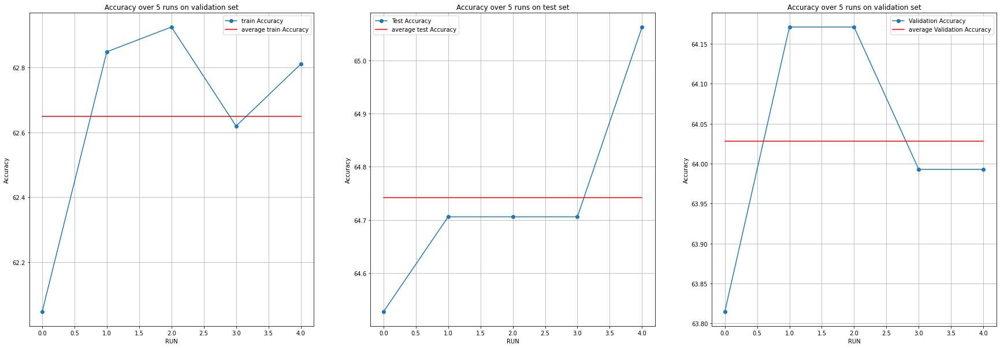

<Figure size 1080x1080 with 0 Axes>

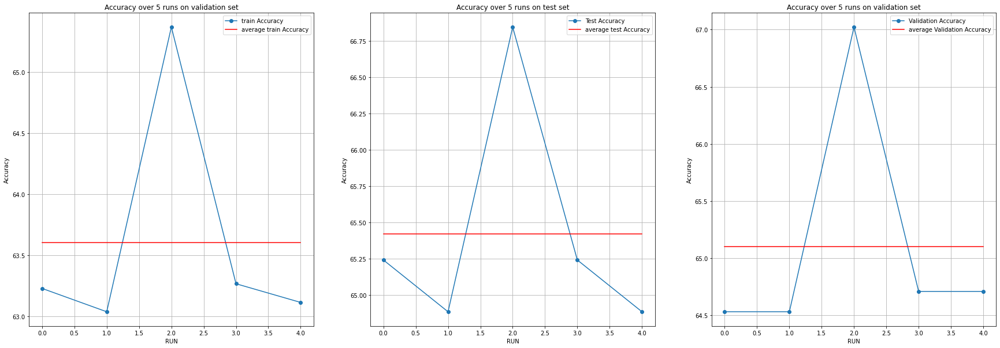

<Figure size 1080x1080 with 0 Axes>

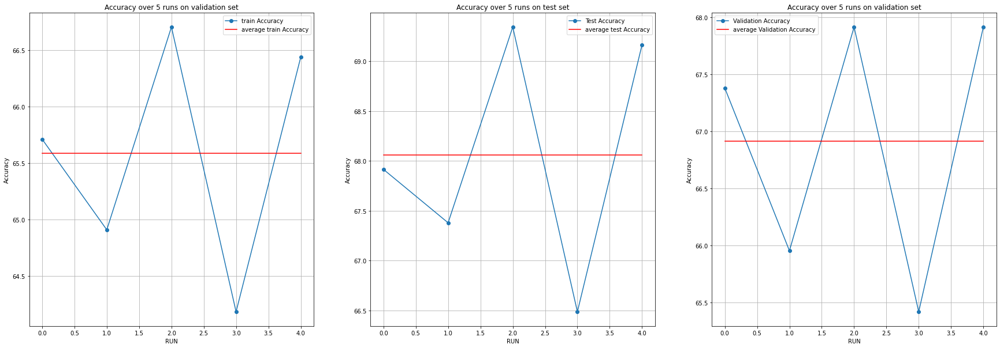

<Figure size 1080x1080 with 0 Axes>

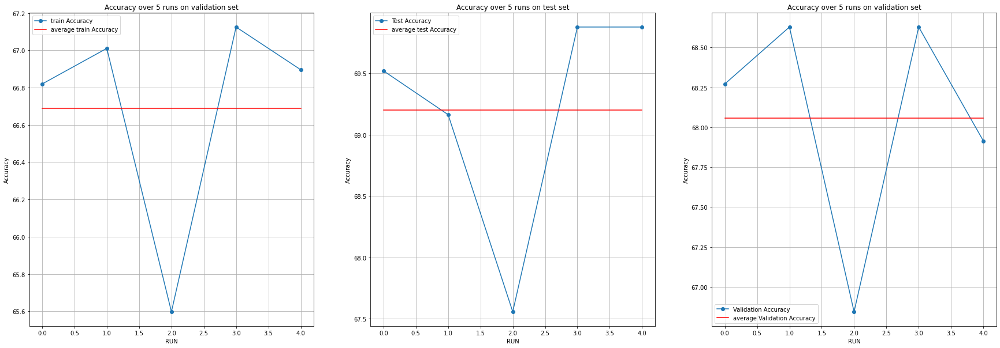

<Figure size 1080x1080 with 0 Axes>

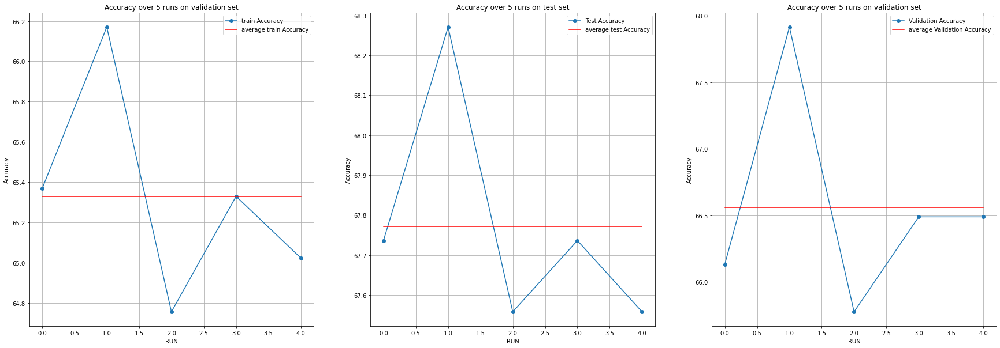

<Figure size 1080x1080 with 0 Axes>

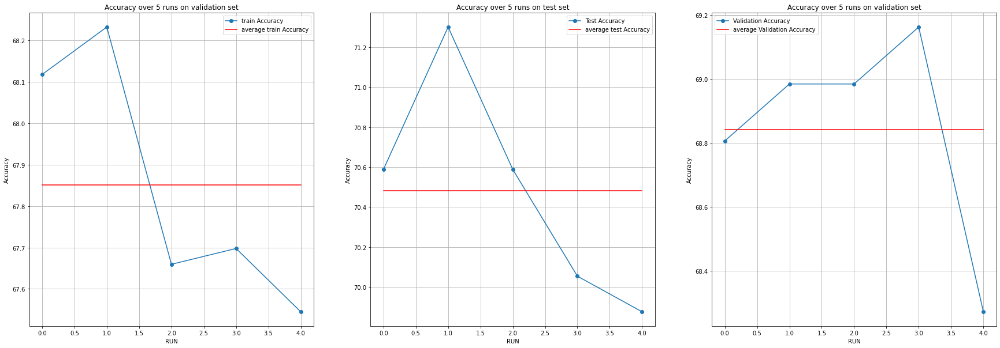

<Figure size 1080x1080 with 0 Axes>

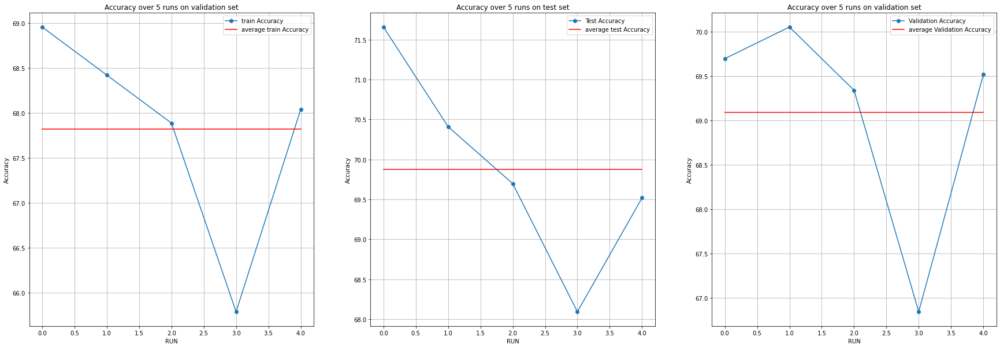

<Figure size 1080x1080 with 0 Axes>

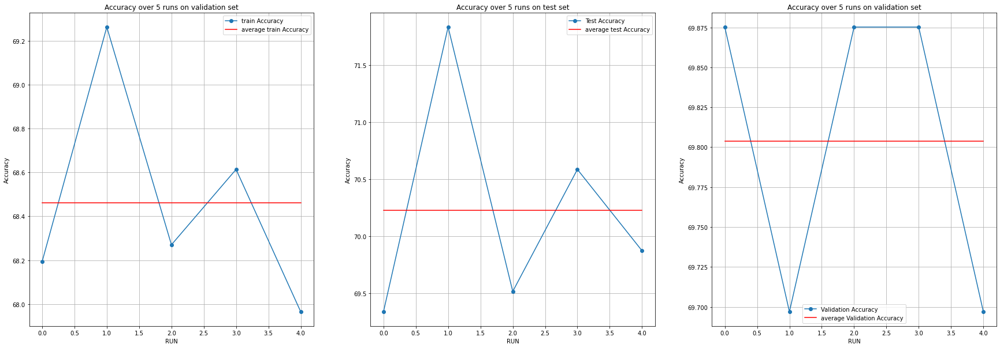

<Figure size 1080x1080 with 0 Axes>

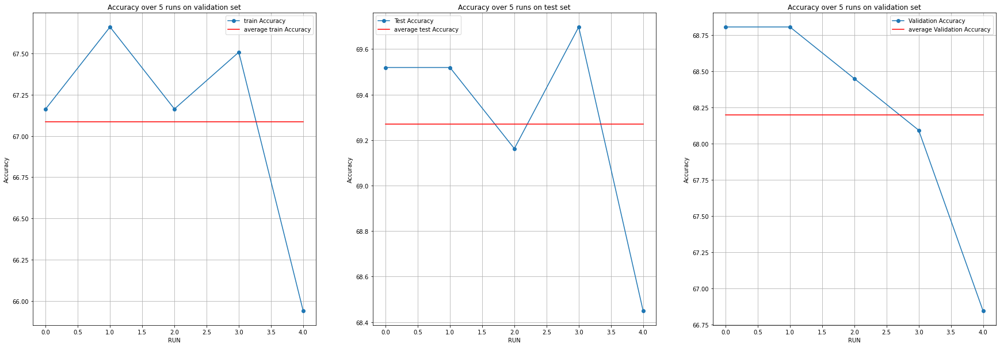

<Figure size 1080x1080 with 0 Axes>

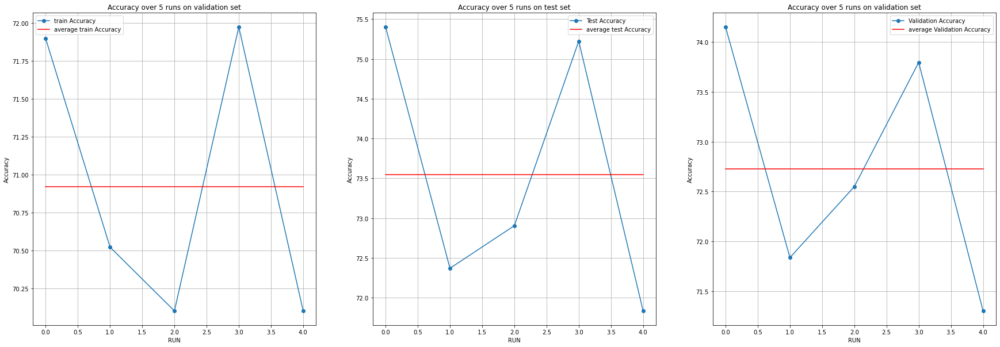

<Figure size 1080x1080 with 0 Axes>

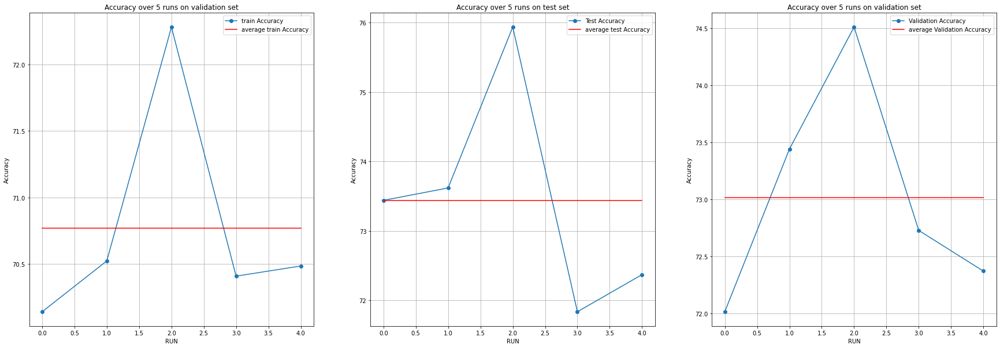

<Figure size 1080x1080 with 0 Axes>

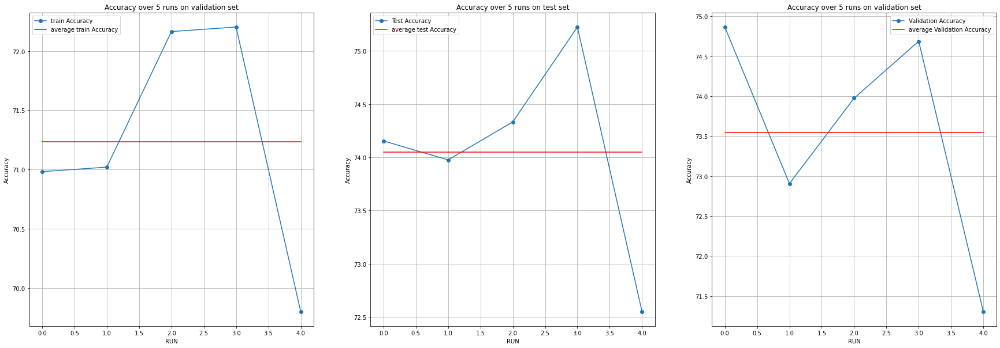

<Figure size 1080x1080 with 0 Axes>

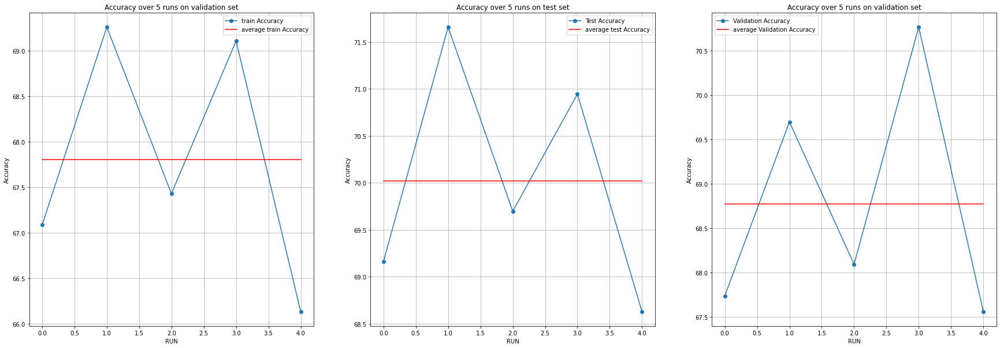

<Figure size 1080x1080 with 0 Axes>

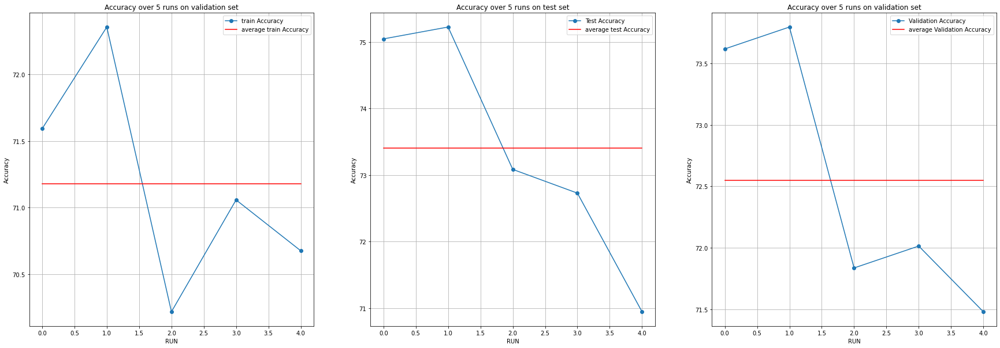

<Figure size 1080x1080 with 0 Axes>

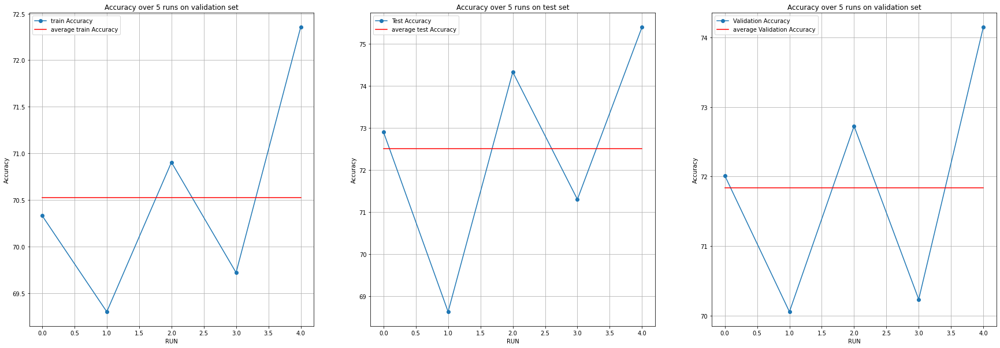

<Figure size 1080x1080 with 0 Axes>

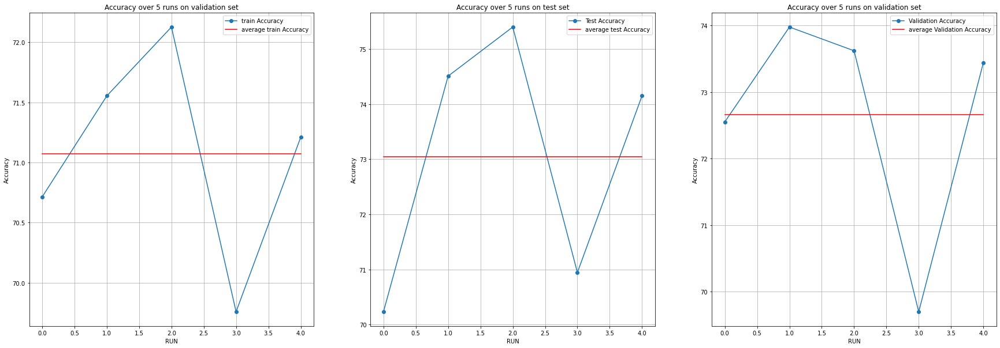

<Figure size 1080x1080 with 0 Axes>

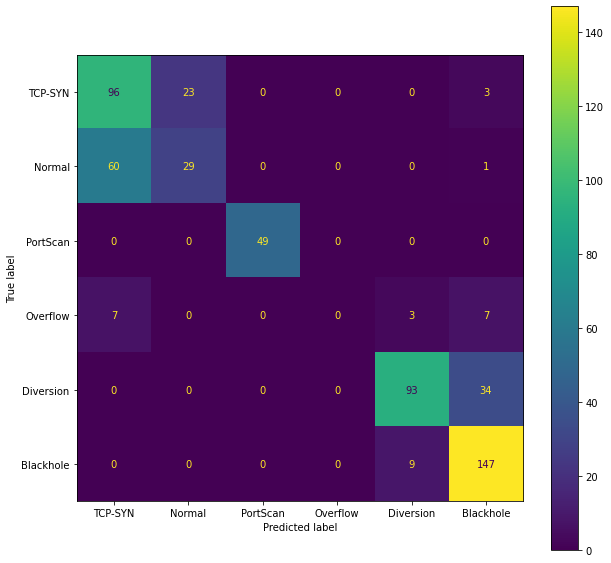

In [ ]:
mean_acccurcies=[]
hiden_layers_ls=[1,2,4,8]
ner_ls=[10,20,30,40]
layers_hist = []
for i in hiden_layers_ls:
  nl=[]
  for j in ner_ls:
    print('run with '+str(i)+'hidden layers and'+str(j)+'neurons')
    admw=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= 0.001)
    model=MLP(4,num_class,epochs=500,num_hidden_layer=i,neurons_each_layer=j,opt=admw,batch_size=best_bs)
    df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)
    layers_hist.append(df)
    nl.append(df.iloc[2,3])
  mean_acccurcies.append(nl)

In [ ]:
layers_hist[0]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,62.046582,64.527631,63.814616
1,maxmum Accuracy,62.924778,65.062386,64.171124
2,average Accuracy,62.649865,64.741534,64.028521


In [ ]:
layers_hist[1]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,63.039327,64.884138,64.527631
1,maxmum Accuracy,65.368462,66.844922,67.023170
2,average Accuracy,63.604429,65.418895,65.098040


In [ ]:
layers_hist[2]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,64.184803,66.488415,65.418893
1,maxmum Accuracy,66.704851,69.340461,67.914438
2,average Accuracy,65.589920,68.057040,66.916220


In [ ]:
layers_hist[3]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,65.597558,67.557931,66.844922
1,maxmum Accuracy,67.124856,69.875222,68.627453
2,average Accuracy,66.689576,69.197860,68.057042


In [ ]:
layers_hist[4]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,64.757544,67.557931,65.775400
1,maxmum Accuracy,66.170293,68.270946,67.914438
2,average Accuracy,65.330279,67.771835,66.559715


In [ ]:
layers_hist[5]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.544866,69.875222,68.270946
1,maxmum Accuracy,68.232149,71.301246,69.162208
2,average Accuracy,67.850325,70.481284,68.841356


In [ ]:
layers_hist[6]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,65.788472,68.092692,66.844922
1,maxmum Accuracy,68.957615,71.657753,70.053476
2,average Accuracy,67.819778,69.875222,69.090909


In [ ]:
layers_hist[7]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.964870,69.340461,69.696969
1,maxmum Accuracy,69.263077,71.836007,69.875222
2,average Accuracy,68.461244,70.231729,69.803921


In [ ]:
layers_hist[8]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,65.941197,68.449199,66.844922
1,maxmum Accuracy,67.659414,69.696969,68.805707
2,average Accuracy,67.086674,69.269161,68.199645


In [ ]:
layers_hist[9]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.103091,71.836007,71.301246
1,maxmum Accuracy,71.974033,75.401068,74.153298
2,average Accuracy,70.920198,73.547237,72.727273


In [ ]:
layers_hist[10]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.141274,71.836007,72.014260
1,maxmum Accuracy,72.279495,75.935829,74.509805
2,average Accuracy,70.767468,73.440285,73.012478


In [ ]:
layers_hist[11]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.797635,72.549021,71.301246
1,maxmum Accuracy,72.203130,75.222814,74.866313
2,average Accuracy,71.233294,74.046346,73.547238


In [ ]:
layers_hist[12]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,66.132110,68.627453,67.557931
1,maxmum Accuracy,69.263077,71.657753,70.766491
2,average Accuracy,67.804505,70.017825,68.770053


In [ ]:
layers_hist[13]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.217639,70.944744,71.479499
1,maxmum Accuracy,72.355860,75.222814,73.796791
2,average Accuracy,71.179839,73.404634,72.549019


In [ ]:
layers_hist[14]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.301260,68.627453,70.053476
1,maxmum Accuracy,72.355860,75.401068,74.153298
2,average Accuracy,70.523101,72.513369,71.836008


In [ ]:
layers_hist[15]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.759452,70.231730,69.696969
1,maxmum Accuracy,72.126764,75.401068,73.975044
2,average Accuracy,71.072929,73.048129,72.655971


In [ ]:
counter1=0
max_i=0
max_j=0
m=0
for i in mean_acccurcies:
  counter2=0
  for j in i:
    if j>m:
      max_i=counter1
      max_j=counter2
      m=j
    counter2+=1
  counter1+=1

In [ ]:
best_h=hiden_layers_ls[max_i]
best_n=ner_ls[max_j]


In [ ]:
best_h

4

In [ ]:
best_n

40

In [ ]:
mean_acccurcies[max_i][max_j]

73.54723811149597

In [ ]:
print('the best model in {} hidden layers and {} neurons and achieved {} % validation accuracy'.format(best_h,best_n,mean_acccurcies[max_i][max_j]))

the best model in 4 hidden layers and 40 neurons and achieved 73.54723811149597 % validation accuracy


In [ ]:
mean_acccurcies_test=[]
counter=0
nl=[]
for df in layers_hist:
  nl.append(df.iloc[2,2])
  counter+=1
  if counter%4==0:
    mean_acccurcies_test.append(nl)
    nl=[]

In [ ]:
mean_acccurcies_test

[[64.74153399467468, 65.41889548301697, 68.05703997612, 69.19785976409912],
 [67.77183532714844, 70.48128366470337, 69.8752224445343, 70.23172855377197],
 [69.26916122436523, 73.54723691940308, 73.4402847290039, 74.04634594917297],
 [70.01782536506653, 73.40463399887085, 72.51336932182312, 73.04812908172607],
 []]

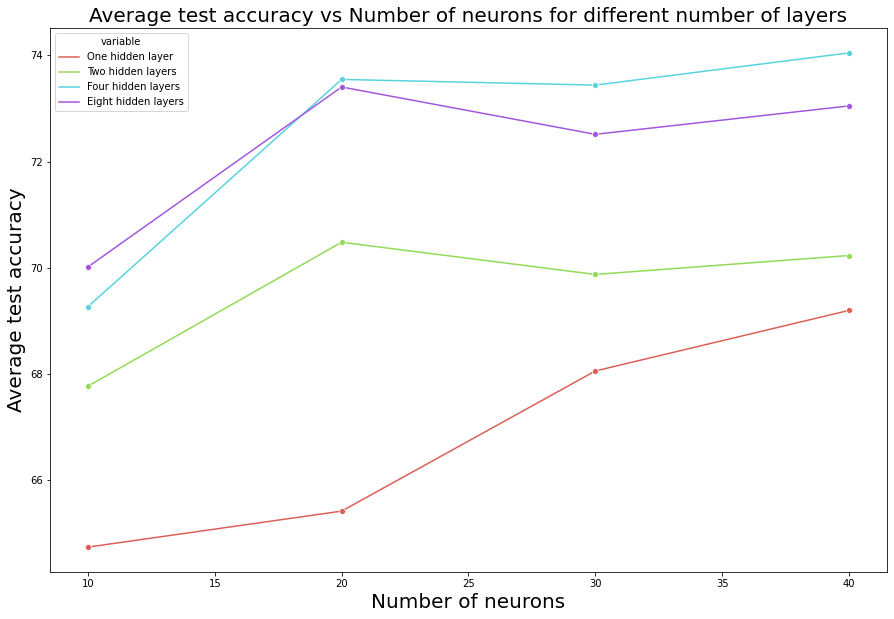

In [ ]:
df_acc=pd.DataFrame({'Number of neurons':[10,20,30,40],'One hidden layer':mean_acccurcies_test[0],'Two hidden layers':mean_acccurcies_test[1],'Four hidden layers':mean_acccurcies_test[2],'Eight hidden layers':mean_acccurcies_test[3]})
plt.figure(figsize=(15,10))
sns.color_palette("Set2")
p = sns.lineplot(x='Number of neurons', y='value', hue='variable', 
             data=pd.melt(df_acc, 'Number of neurons'), marker='o',palette="hls")
p.set_ylabel("Average test accuracy", fontsize = 20)
p.set_xlabel("Number of neurons", fontsize = 20)
p.set_title("Average test accuracy vs Number of neurons for different number of layers", fontsize=20)
plt.show()

<a id="13"></a> <br>
### Q3.3) Learning rate and different optimizers

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.1374 - accuracy: 0.4948 - val_loss: 0.9359 - val_accuracy: 0.6239
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7631 - accuracy: 0.6480 - val_loss: 0.6429 - val_accuracy: 0.7184
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7351 - accuracy: 0.6525 - val_loss: 0.6521 - val_accuracy: 0.7201
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7140 - accuracy: 0.6735 - val_loss: 0.6624 - val_accuracy: 0.7130
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7509 - accuracy: 0.6289 - val_loss: 0.8504 - val_accuracy: 0.5651
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7620 - accuracy: 0.6376 - val_loss: 0.6703 - val_accuracy: 0.6827
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7333 - accuracy: 0.6732 - val_loss: 0.6580 - val_accuracy: 0.7201
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,24.856816,22.638147,21.925133
1,maxmum Accuracy,54.715538,51.515150,57.575756
2,average Accuracy,30.943108,31.515151,29.696969


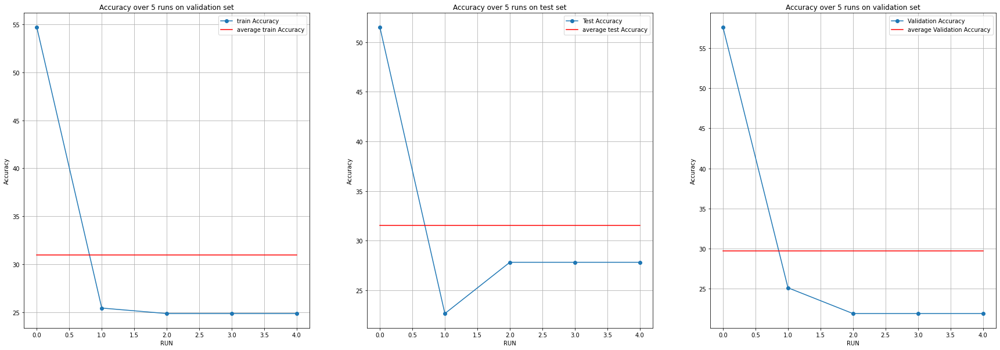

<Figure size 1080x1080 with 0 Axes>

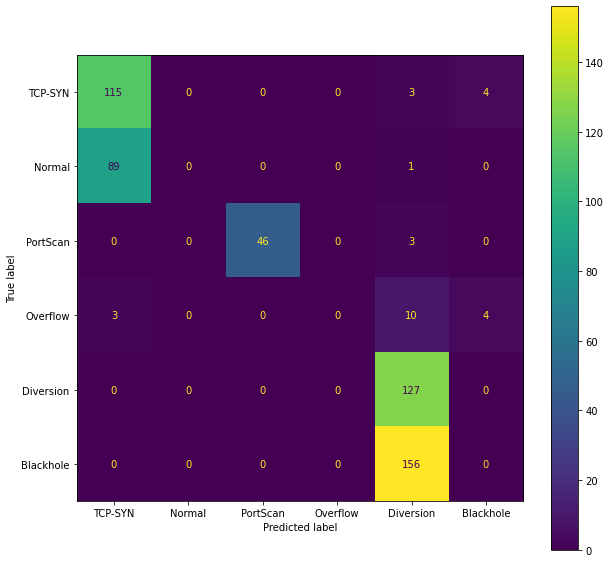

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 0.9923 - accuracy: 0.5995 - val_loss: 0.7183 - val_accuracy: 0.6827
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7237 - accuracy: 0.6640 - val_loss: 0.7260 - val_accuracy: 0.6791
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7330 - accuracy: 0.6598 - val_loss: 0.7069 - val_accuracy: 0.6809
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7060 - accuracy: 0.6667 - val_loss: 0.6752 - val_accuracy: 0.6595
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7206 - accuracy: 0.6621 - val_loss: 0.6613 - val_accuracy: 0.6863
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.6868 - accuracy: 0.6762 - val_loss: 0.6571 - val_accuracy: 0.7077
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.6807 - accuracy: 0.6884 - val_loss: 0.6642 - val_accuracy: 0.6970
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,64.222986,62.745100,64.349377
1,maxmum Accuracy,73.424971,73.618537,72.905529
2,average Accuracy,69.400533,70.053476,70.481285


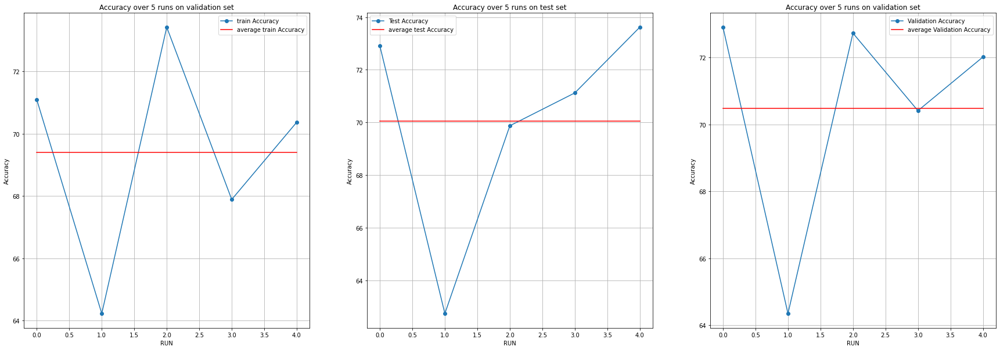

<Figure size 1080x1080 with 0 Axes>

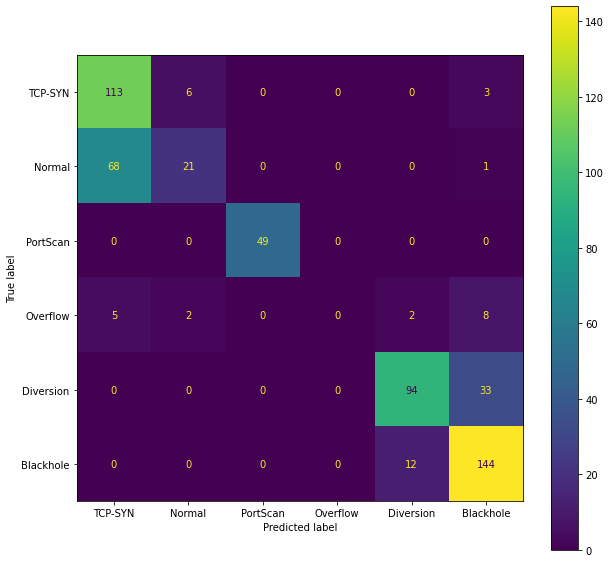

Epoch 1/500
41/41 [==============================] - 1s 8ms/step - loss: 1.6379 - accuracy: 0.4517 - val_loss: 1.4474 - val_accuracy: 0.3779
Epoch 2/500
41/41 [==============================] - 0s 3ms/step - loss: 1.2203 - accuracy: 0.5475 - val_loss: 0.9934 - val_accuracy: 0.6061
Epoch 3/500
41/41 [==============================] - 0s 3ms/step - loss: 0.9113 - accuracy: 0.6075 - val_loss: 0.8267 - val_accuracy: 0.6310
Epoch 4/500
41/41 [==============================] - 0s 3ms/step - loss: 0.8183 - accuracy: 0.6399 - val_loss: 0.7682 - val_accuracy: 0.6595
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7722 - accuracy: 0.6552 - val_loss: 0.7318 - val_accuracy: 0.6809
Epoch 6/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7528 - accuracy: 0.6632 - val_loss: 0.7111 - val_accuracy: 0.6791
Epoch 7/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7402 - accuracy: 0.6625 - val_loss: 0.7038 - val_accuracy: 0.6827
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.835818,72.905529,70.944744
1,maxmum Accuracy,72.317678,75.579321,74.688059
2,average Accuracy,71.248568,74.367201,73.226383


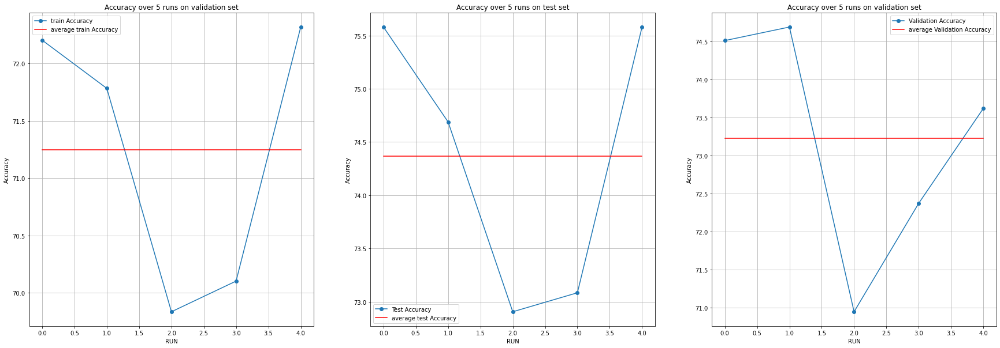

<Figure size 1080x1080 with 0 Axes>

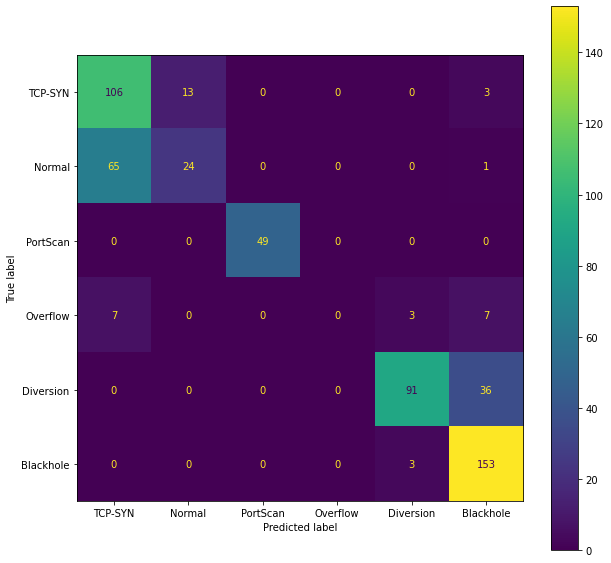

 20%|██        | 1/5 [02:16<09:06, 136.72s/it]

Epoch 1/500
41/41 [==============================] - 1s 6ms/step - loss: 1.6012 - accuracy: 0.3979 - val_loss: 1.3720 - val_accuracy: 0.4938
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.1033 - accuracy: 0.5330 - val_loss: 0.9116 - val_accuracy: 0.5455
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8623 - accuracy: 0.6136 - val_loss: 0.8100 - val_accuracy: 0.5882
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8370 - accuracy: 0.6201 - val_loss: 0.8214 - val_accuracy: 0.6631
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8065 - accuracy: 0.6273 - val_loss: 0.7212 - val_accuracy: 0.6809
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7904 - accuracy: 0.6346 - val_loss: 0.7467 - val_accuracy: 0.6631
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7812 - accuracy: 0.6499 - val_loss: 0.7899 - val_accuracy: 0.5793
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,66.704851,68.270946,70.409983
1,maxmum Accuracy,72.164947,76.470590,74.331552
2,average Accuracy,70.271095,73.440286,72.549020


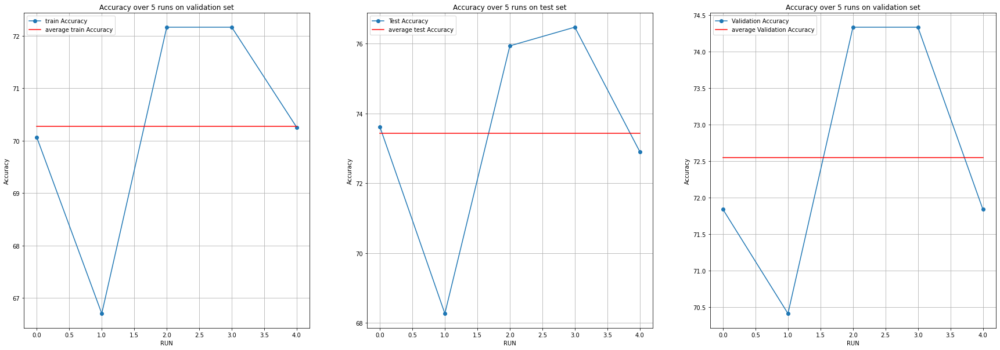

<Figure size 1080x1080 with 0 Axes>

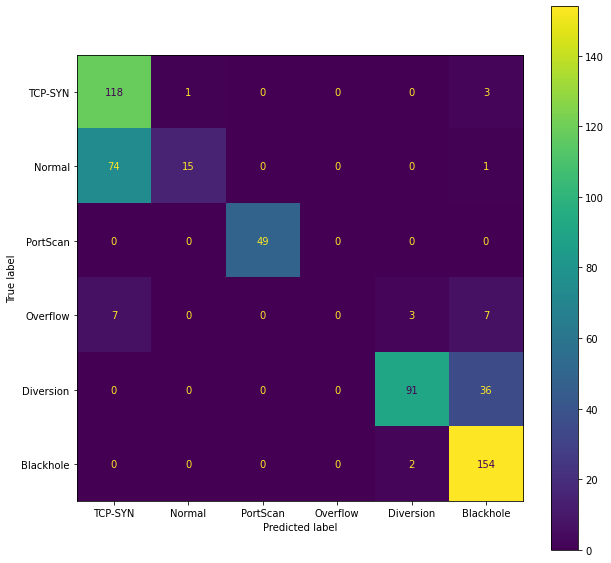

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.7654 - accuracy: 0.2489 - val_loss: 1.7425 - val_accuracy: 0.2193
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7227 - accuracy: 0.2486 - val_loss: 1.7070 - val_accuracy: 0.2193
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6859 - accuracy: 0.2486 - val_loss: 1.6728 - val_accuracy: 0.2193
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6537 - accuracy: 0.2486 - val_loss: 1.6450 - val_accuracy: 0.2193
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6268 - accuracy: 0.2486 - val_loss: 1.6208 - val_accuracy: 0.2193
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6030 - accuracy: 0.2486 - val_loss: 1.5980 - val_accuracy: 0.2193
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 1.5792 - accuracy: 0.2558 - val_loss: 1.5737 - val_accuracy: 0.2977
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,68.308514,70.053476,70.231730
1,maxmum Accuracy,69.568539,71.836007,70.766491
2,average Accuracy,69.110347,71.408199,70.445634


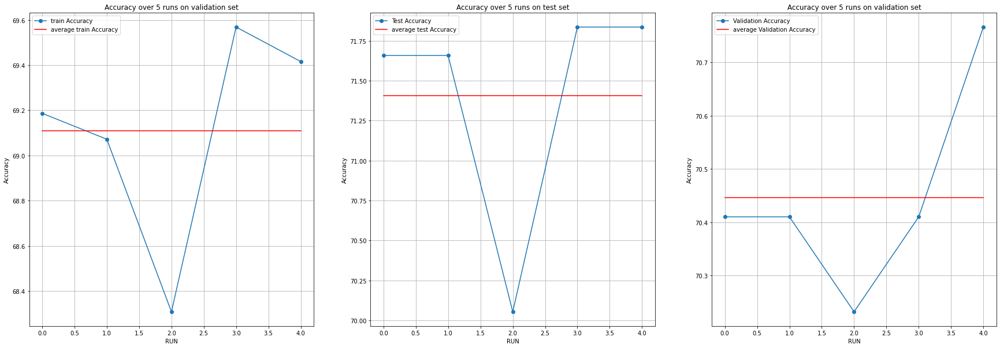

<Figure size 1080x1080 with 0 Axes>

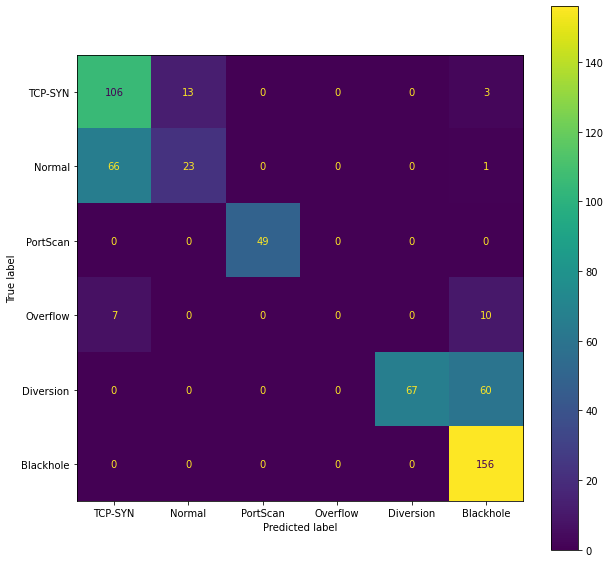

Epoch 1/500
41/41 [==============================] - 1s 6ms/step - loss: 1.8078 - accuracy: 0.2058 - val_loss: 1.8029 - val_accuracy: 0.1854
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.8015 - accuracy: 0.2085 - val_loss: 1.7962 - val_accuracy: 0.2602
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7955 - accuracy: 0.2917 - val_loss: 1.7906 - val_accuracy: 0.2816
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7905 - accuracy: 0.2913 - val_loss: 1.7859 - val_accuracy: 0.2923
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7859 - accuracy: 0.2955 - val_loss: 1.7816 - val_accuracy: 0.3084
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7818 - accuracy: 0.3360 - val_loss: 1.7777 - val_accuracy: 0.3512
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7779 - accuracy: 0.3478 - val_loss: 1.7740 - val_accuracy: 0.3743
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,25.429553,22.638147,25.133690
1,maxmum Accuracy,62.275678,64.527631,63.992870
2,average Accuracy,39.931272,39.001783,39.679145


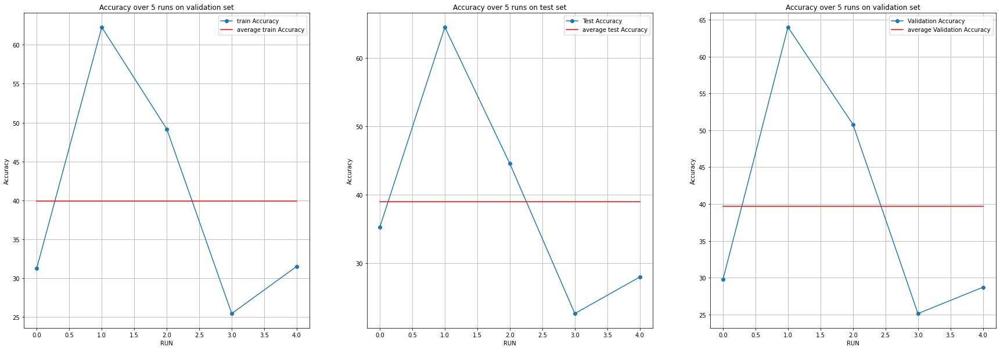

<Figure size 1080x1080 with 0 Axes>

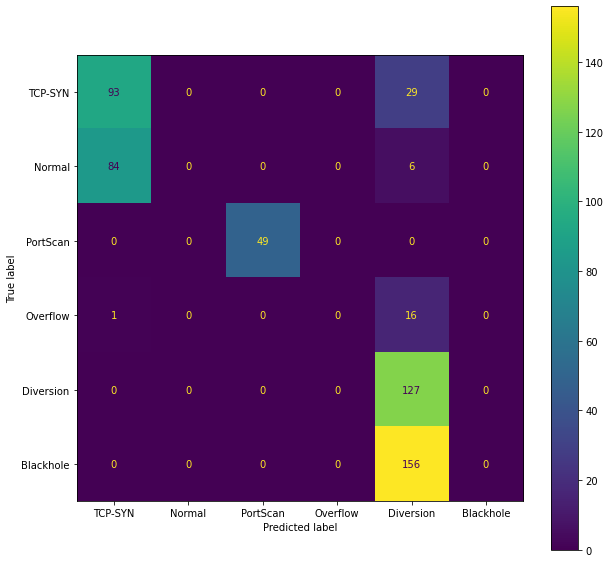

 40%|████      | 2/5 [05:24<08:19, 166.57s/it]

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.5537 - accuracy: 0.4028 - val_loss: 1.2238 - val_accuracy: 0.5258
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9673 - accuracy: 0.5792 - val_loss: 0.9544 - val_accuracy: 0.5775
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8312 - accuracy: 0.6212 - val_loss: 0.7884 - val_accuracy: 0.5098
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8273 - accuracy: 0.5983 - val_loss: 0.7353 - val_accuracy: 0.6346
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7820 - accuracy: 0.6354 - val_loss: 0.7236 - val_accuracy: 0.6310
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8058 - accuracy: 0.6319 - val_loss: 0.7475 - val_accuracy: 0.6702
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7786 - accuracy: 0.6388 - val_loss: 0.7362 - val_accuracy: 0.6863
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.186711,71.479499,71.122992
1,maxmum Accuracy,72.928602,75.222814,74.688059
2,average Accuracy,71.202749,73.832442,72.834225


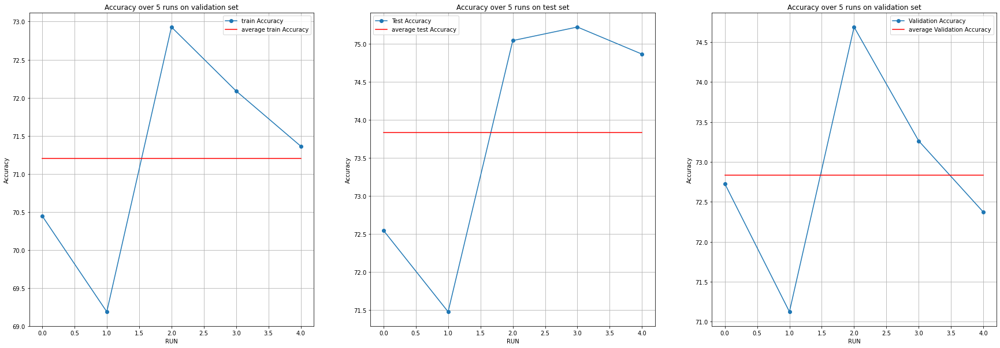

<Figure size 1080x1080 with 0 Axes>

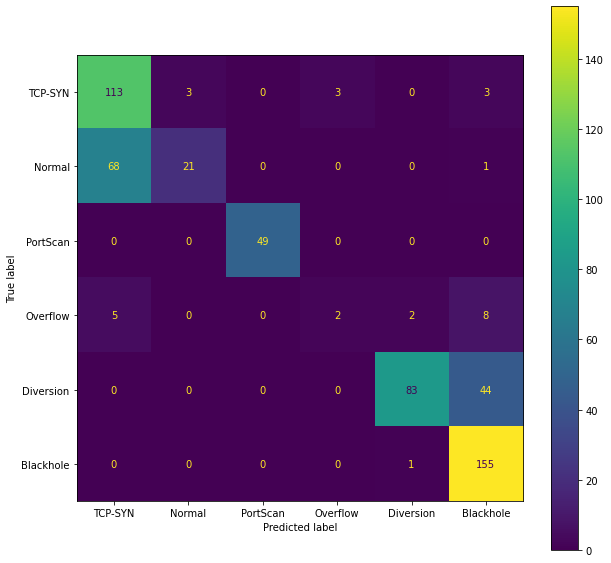

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.7391 - accuracy: 0.3123 - val_loss: 1.6955 - val_accuracy: 0.2923
Epoch 2/500
41/41 [==============================] - 0s 3ms/step - loss: 1.6545 - accuracy: 0.3104 - val_loss: 1.6256 - val_accuracy: 0.2977
Epoch 3/500
41/41 [==============================] - 0s 3ms/step - loss: 1.5866 - accuracy: 0.3517 - val_loss: 1.5634 - val_accuracy: 0.3405
Epoch 4/500
41/41 [==============================] - 0s 3ms/step - loss: 1.5194 - accuracy: 0.4086 - val_loss: 1.4984 - val_accuracy: 0.4260
Epoch 5/500
41/41 [==============================] - 0s 3ms/step - loss: 1.4458 - accuracy: 0.4612 - val_loss: 1.4239 - val_accuracy: 0.4795
Epoch 6/500
41/41 [==============================] - 0s 3ms/step - loss: 1.3673 - accuracy: 0.4803 - val_loss: 1.3455 - val_accuracy: 0.5134
Epoch 7/500
41/41 [==============================] - 0s 3ms/step - loss: 1.2886 - accuracy: 0.4926 - val_loss: 1.2620 - val_accuracy: 0.5134
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.263077,71.657753,70.409983
1,maxmum Accuracy,71.744943,75.579321,73.440284
2,average Accuracy,70.240549,73.119429,71.515150


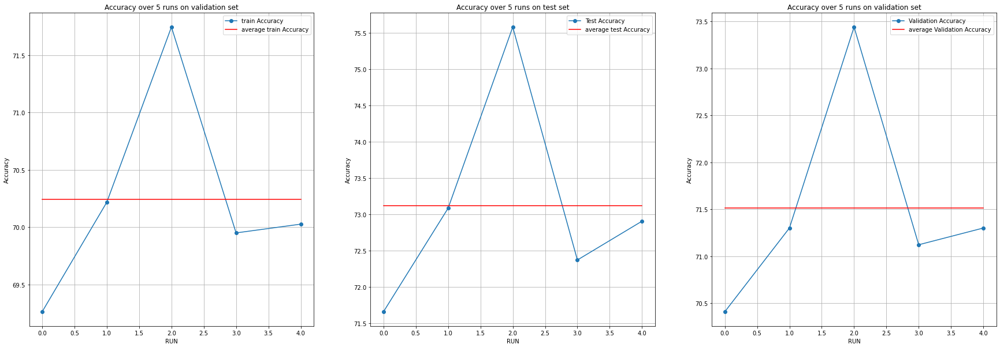

<Figure size 1080x1080 with 0 Axes>

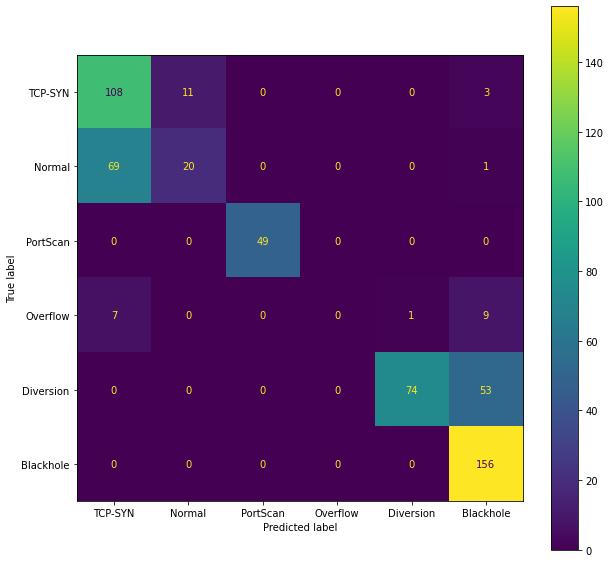

Epoch 1/500
41/41 [==============================] - 1s 6ms/step - loss: 1.7869 - accuracy: 0.3738 - val_loss: 1.7824 - val_accuracy: 0.4563
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7793 - accuracy: 0.4681 - val_loss: 1.7749 - val_accuracy: 0.5098
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7721 - accuracy: 0.4624 - val_loss: 1.7678 - val_accuracy: 0.3636
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7651 - accuracy: 0.3704 - val_loss: 1.7611 - val_accuracy: 0.3547
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7585 - accuracy: 0.3349 - val_loss: 1.7547 - val_accuracy: 0.3316
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7523 - accuracy: 0.3123 - val_loss: 1.7487 - val_accuracy: 0.3084
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7464 - accuracy: 0.2875 - val_loss: 1.7430 - val_accuracy: 0.2870
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,37.724322,35.828876,39.393941
1,maxmum Accuracy,68.117601,70.231730,68.983960
2,average Accuracy,56.876670,58.217468,57.290553


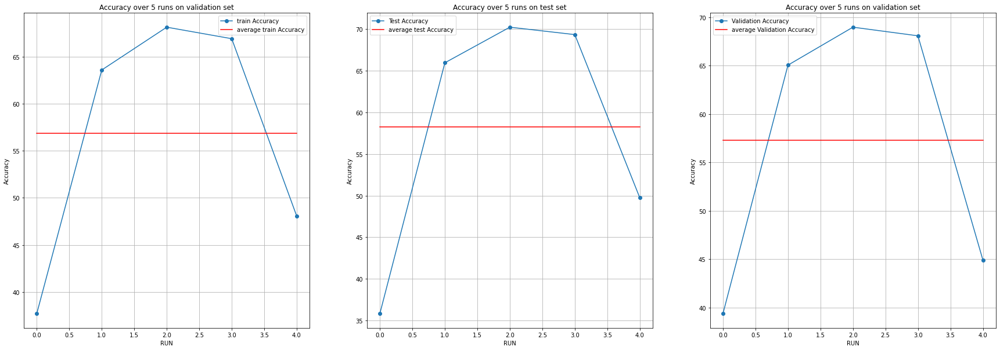

<Figure size 1080x1080 with 0 Axes>

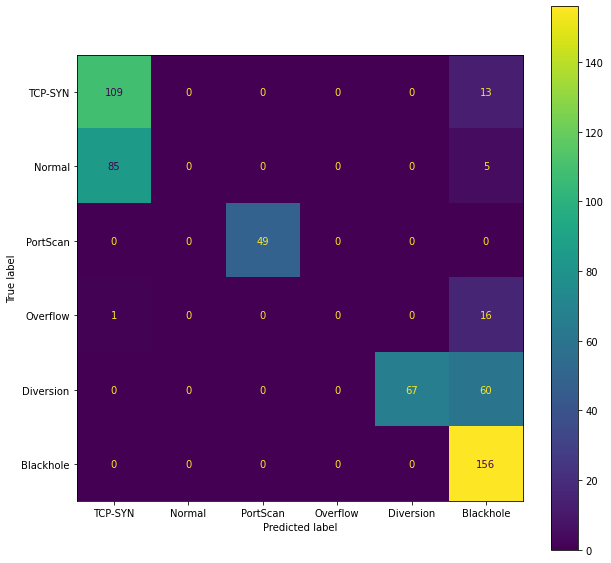

 60%|██████    | 3/5 [09:04<06:22, 191.28s/it]

Epoch 1/500
41/41 [==============================] - 1s 6ms/step - loss: 1.2814 - accuracy: 0.4204 - val_loss: 0.9443 - val_accuracy: 0.5722
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8689 - accuracy: 0.5678 - val_loss: 0.8420 - val_accuracy: 0.6203
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8478 - accuracy: 0.6033 - val_loss: 0.8042 - val_accuracy: 0.6114
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7996 - accuracy: 0.6102 - val_loss: 0.7206 - val_accuracy: 0.7005
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7689 - accuracy: 0.6441 - val_loss: 0.8135 - val_accuracy: 0.5900
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7568 - accuracy: 0.6506 - val_loss: 0.6609 - val_accuracy: 0.7059
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8012 - accuracy: 0.6331 - val_loss: 0.7711 - val_accuracy: 0.5009
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.239404,70.231730,68.627453
1,maxmum Accuracy,71.744943,74.509805,73.796791
2,average Accuracy,69.583811,72.014261,71.764706


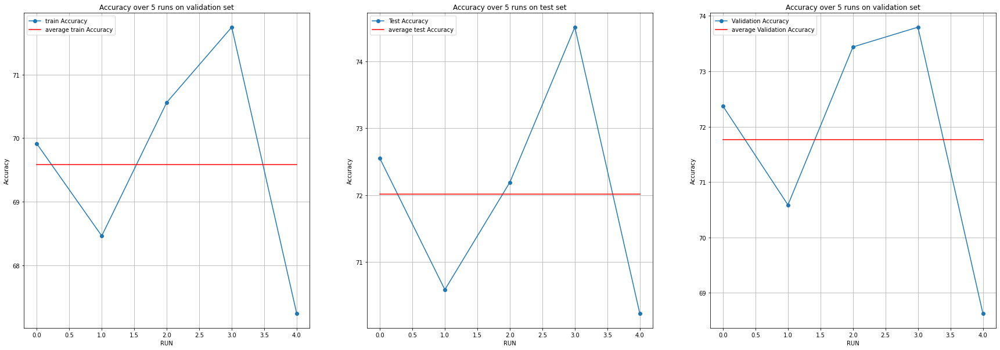

<Figure size 1080x1080 with 0 Axes>

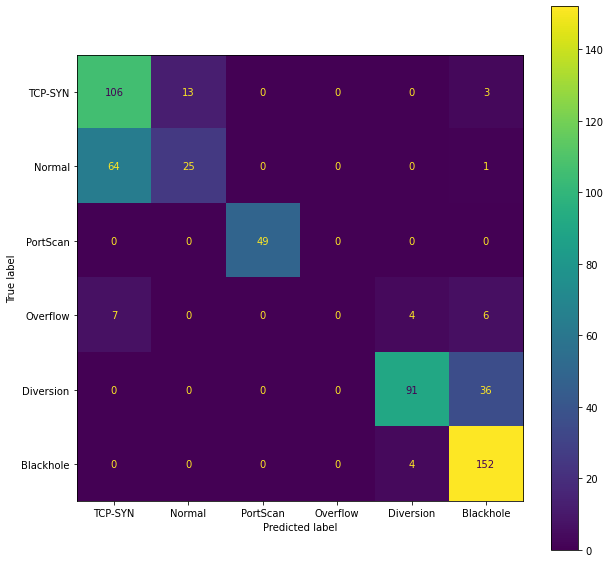

Epoch 1/500
41/41 [==============================] - 1s 6ms/step - loss: 1.7139 - accuracy: 0.2940 - val_loss: 1.6315 - val_accuracy: 0.2371
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.5411 - accuracy: 0.3646 - val_loss: 1.4367 - val_accuracy: 0.5169
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.2991 - accuracy: 0.5380 - val_loss: 1.1780 - val_accuracy: 0.5544
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 1.0583 - accuracy: 0.6178 - val_loss: 0.9423 - val_accuracy: 0.6631
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9051 - accuracy: 0.6384 - val_loss: 0.8410 - val_accuracy: 0.6934
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8393 - accuracy: 0.6522 - val_loss: 0.7876 - val_accuracy: 0.6809
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7978 - accuracy: 0.6575 - val_loss: 0.8347 - val_accuracy: 0.6221
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.530356,71.836007,69.696969
1,maxmum Accuracy,72.279495,75.935829,73.796791
2,average Accuracy,70.675830,73.404635,72.263814


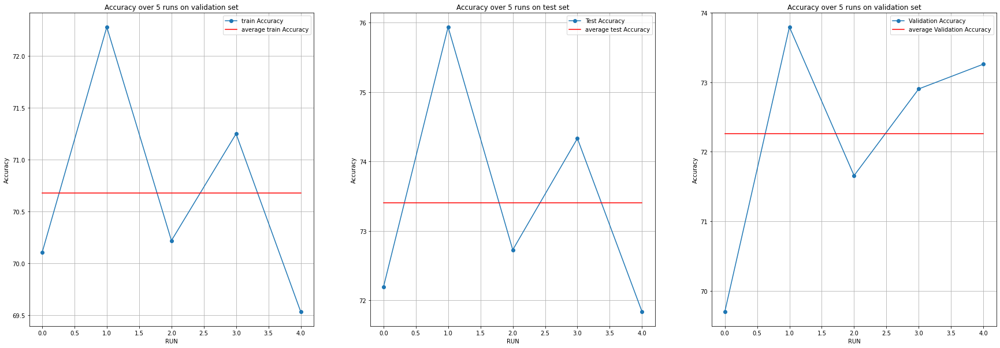

<Figure size 1080x1080 with 0 Axes>

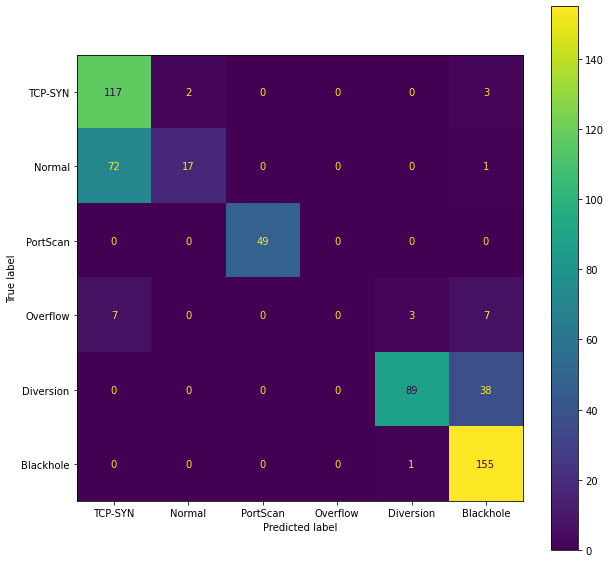

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.7772 - accuracy: 0.2734 - val_loss: 1.7574 - val_accuracy: 0.3226
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.7332 - accuracy: 0.4066 - val_loss: 1.7181 - val_accuracy: 0.4135
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6983 - accuracy: 0.3975 - val_loss: 1.6883 - val_accuracy: 0.3458
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6685 - accuracy: 0.3727 - val_loss: 1.6611 - val_accuracy: 0.3422
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6399 - accuracy: 0.3830 - val_loss: 1.6334 - val_accuracy: 0.3601
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 1.6104 - accuracy: 0.3940 - val_loss: 1.6045 - val_accuracy: 0.3975
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 1.5793 - accuracy: 0.4303 - val_loss: 1.5736 - val_accuracy: 0.4349
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.201221,68.805707,68.270946
1,maxmum Accuracy,69.453990,71.836007,70.766491
2,average Accuracy,68.514700,70.409982,69.803922


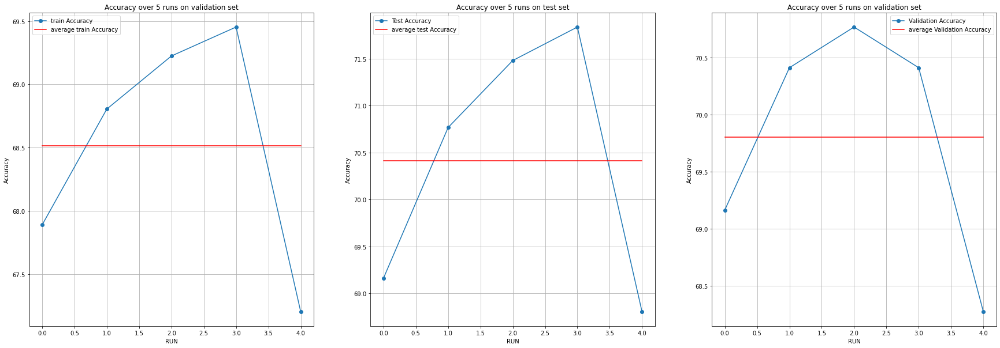

<Figure size 1080x1080 with 0 Axes>

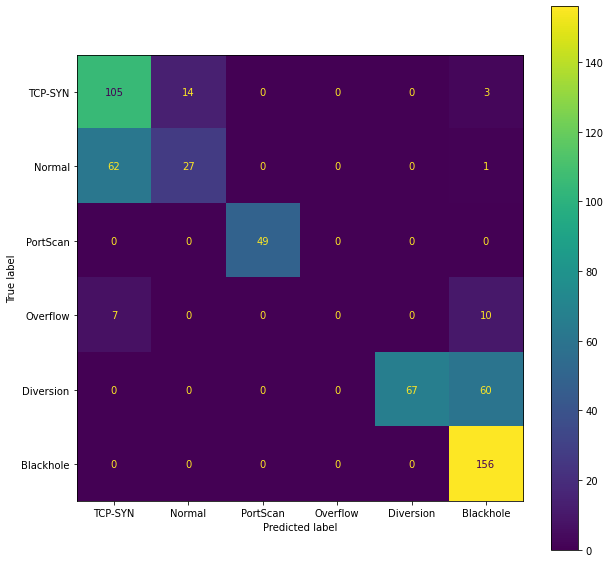

 80%|████████  | 4/5 [12:21<03:13, 193.20s/it]

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 4.4098 - accuracy: 0.2799 - val_loss: 1.5213 - val_accuracy: 0.4064
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.4151 - accuracy: 0.3734 - val_loss: 1.3923 - val_accuracy: 0.2977
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.3281 - accuracy: 0.4483 - val_loss: 1.1751 - val_accuracy: 0.4242
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9051 - accuracy: 0.6037 - val_loss: 0.9163 - val_accuracy: 0.5971
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8960 - accuracy: 0.6304 - val_loss: 0.9284 - val_accuracy: 0.6096
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8291 - accuracy: 0.6315 - val_loss: 0.7250 - val_accuracy: 0.6542
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9229 - accuracy: 0.6277 - val_loss: 0.7377 - val_accuracy: 0.6809
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,49.789995,47.237077,48.663101
1,maxmum Accuracy,67.124856,69.696969,68.449199
2,average Accuracy,60.229094,61.853833,60.891266


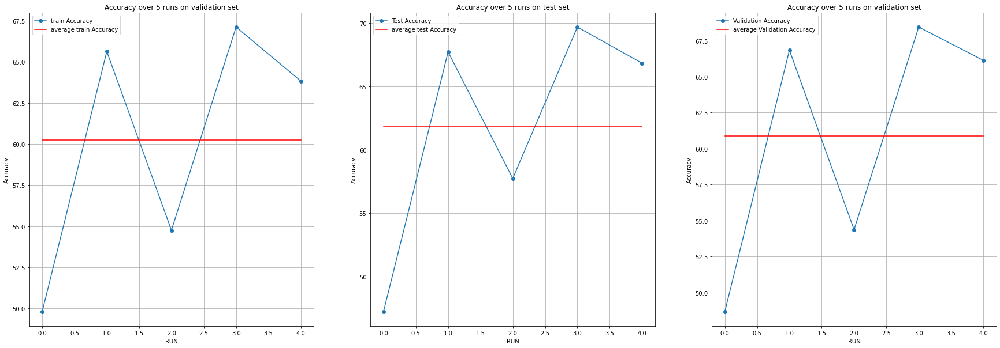

<Figure size 1080x1080 with 0 Axes>

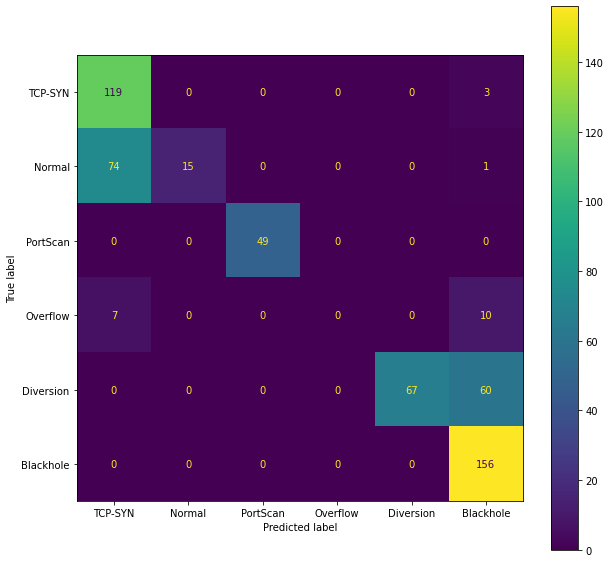

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 0.9951 - accuracy: 0.5563 - val_loss: 0.7547 - val_accuracy: 0.6453
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7814 - accuracy: 0.6411 - val_loss: 0.6894 - val_accuracy: 0.7005
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7509 - accuracy: 0.6636 - val_loss: 0.6919 - val_accuracy: 0.6631
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7203 - accuracy: 0.6678 - val_loss: 0.6540 - val_accuracy: 0.7148
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7195 - accuracy: 0.6712 - val_loss: 0.6653 - val_accuracy: 0.7041
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7149 - accuracy: 0.6739 - val_loss: 0.6461 - val_accuracy: 0.7094
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7079 - accuracy: 0.6751 - val_loss: 0.6389 - val_accuracy: 0.7237
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,74.264985,72.549021,73.796791
1,maxmum Accuracy,76.785034,77.005345,76.648843
2,average Accuracy,75.441008,75.365419,75.329769


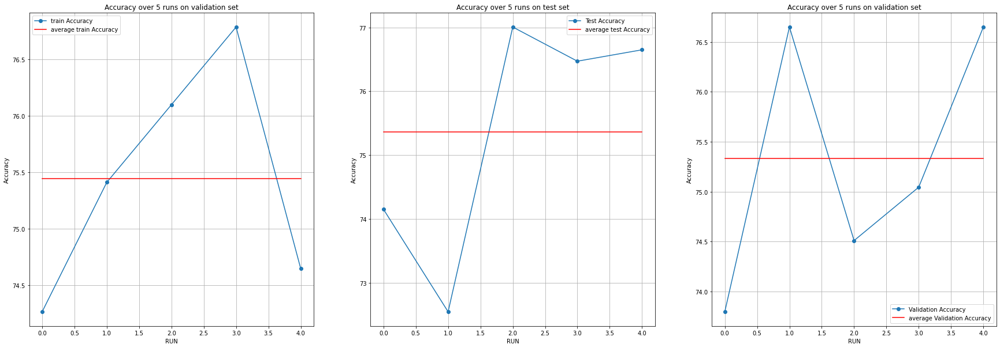

<Figure size 1080x1080 with 0 Axes>

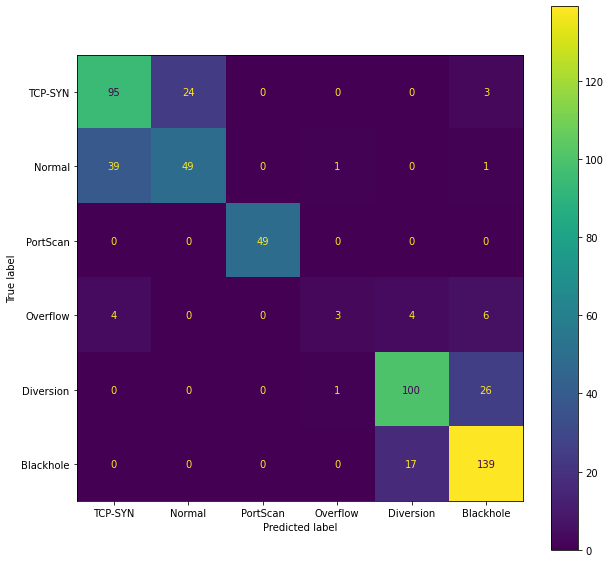

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.6029 - accuracy: 0.4926 - val_loss: 1.3802 - val_accuracy: 0.5526
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.1828 - accuracy: 0.5857 - val_loss: 0.9955 - val_accuracy: 0.6471
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9094 - accuracy: 0.6159 - val_loss: 0.8241 - val_accuracy: 0.6667
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8096 - accuracy: 0.6438 - val_loss: 0.7575 - val_accuracy: 0.6578
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7638 - accuracy: 0.6575 - val_loss: 0.7178 - val_accuracy: 0.6756
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7414 - accuracy: 0.6556 - val_loss: 0.6996 - val_accuracy: 0.7023
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7288 - accuracy: 0.6613 - val_loss: 0.6831 - val_accuracy: 0.7005
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,71.554029,72.014260,71.657753
1,maxmum Accuracy,73.195875,74.866313,73.440284
2,average Accuracy,72.401680,73.440286,72.513369


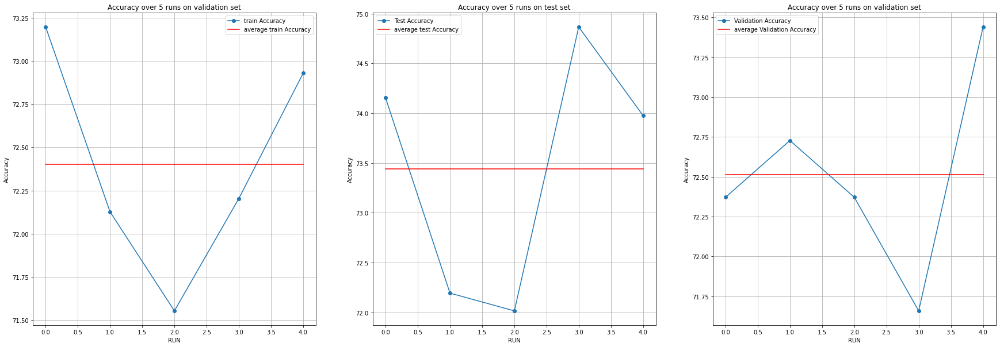

<Figure size 1080x1080 with 0 Axes>

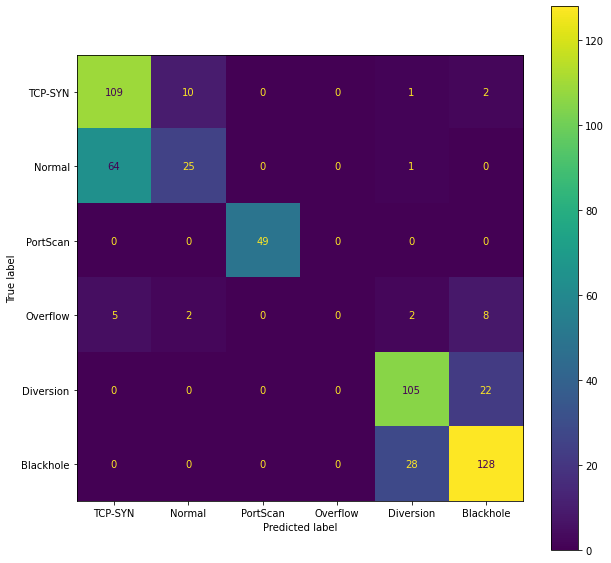

100%|██████████| 5/5 [14:50<00:00, 178.10s/it]


In [ ]:
mean_acccurcies_opt=[]
learn_rates=[0.1,0.01,0.001]
optimizers_ls=[0,1,2,3,4]
opt_hist=[]

for i in tqdm(optimizers_ls):
  nl=[]
  for j in learn_rates:
    if i==0:
      optmizer=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= j)
    elif i==1:
      optmizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=0.1)
    elif i==2:
      optmizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=0.5)   
    elif i==3:
      optmizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=0.9) 
    elif i==4:
      optmizer = tf.keras.optimizers.RMSprop(learning_rate=j)
    else:
      optmizer=None
    model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=best_n,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)

    df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)

    nl.append(df.iloc[2,3])
    opt_hist.append(df)
  mean_acccurcies_opt.append(nl)




In [ ]:
opt_hist[0]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,24.856816,22.638147,21.925133
1,maxmum Accuracy,54.715538,51.515150,57.575756
2,average Accuracy,30.943108,31.515151,29.696969


In [ ]:
opt_hist[1]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,64.222986,62.745100,64.349377
1,maxmum Accuracy,73.424971,73.618537,72.905529
2,average Accuracy,69.400533,70.053476,70.481285


In [ ]:
opt_hist[2]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.835818,72.905529,70.944744
1,maxmum Accuracy,72.317678,75.579321,74.688059
2,average Accuracy,71.248568,74.367201,73.226383


In [ ]:
opt_hist[3]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,66.704851,68.270946,70.409983
1,maxmum Accuracy,72.164947,76.470590,74.331552
2,average Accuracy,70.271095,73.440286,72.549020


In [ ]:
opt_hist[4]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,68.308514,70.053476,70.231730
1,maxmum Accuracy,69.568539,71.836007,70.766491
2,average Accuracy,69.110347,71.408199,70.445634


In [ ]:
opt_hist[5]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,25.429553,22.638147,25.133690
1,maxmum Accuracy,62.275678,64.527631,63.992870
2,average Accuracy,39.931272,39.001783,39.679145


In [ ]:
opt_hist[6]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.186711,71.479499,71.122992
1,maxmum Accuracy,72.928602,75.222814,74.688059
2,average Accuracy,71.202749,73.832442,72.834225


In [ ]:
opt_hist[7]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.263077,71.657753,70.409983
1,maxmum Accuracy,71.744943,75.579321,73.440284
2,average Accuracy,70.240549,73.119429,71.515150


In [ ]:
opt_hist[8]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,37.724322,35.828876,39.393941
1,maxmum Accuracy,68.117601,70.231730,68.983960
2,average Accuracy,56.876670,58.217468,57.290553


In [ ]:
opt_hist[9]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.239404,70.231730,68.627453
1,maxmum Accuracy,71.744943,74.509805,73.796791
2,average Accuracy,69.583811,72.014261,71.764706


In [ ]:
opt_hist[10]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.530356,71.836007,69.696969
1,maxmum Accuracy,72.279495,75.935829,73.796791
2,average Accuracy,70.675830,73.404635,72.263814


In [ ]:
opt_hist[11]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,67.201221,68.805707,68.270946
1,maxmum Accuracy,69.453990,71.836007,70.766491
2,average Accuracy,68.514700,70.409982,69.803922


In [ ]:
opt_hist[12]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,49.789995,47.237077,48.663101
1,maxmum Accuracy,67.124856,69.696969,68.449199
2,average Accuracy,60.229094,61.853833,60.891266


In [ ]:
opt_hist[13]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,74.264985,72.549021,73.796791
1,maxmum Accuracy,76.785034,77.005345,76.648843
2,average Accuracy,75.441008,75.365419,75.329769


In [ ]:
opt_hist[14]

,Accuracy,Train,Test,Validation
0,minimum Accuracy,71.554029,72.014260,71.657753
1,maxmum Accuracy,73.195875,74.866313,73.440284
2,average Accuracy,72.401680,73.440286,72.513369


In [ ]:
mean_acccurcies_opt

[[29.696969389915466, 70.48128485679626, 73.22638273239136],
 [72.54902005195618, 70.44563412666321, 39.679144620895386],
 [72.83422470092773, 71.51515007019043, 57.290552854537964],
 [71.76470637321472, 72.26381421089172, 69.80392217636108],
 [60.89126646518707, 75.32976865768433, 72.51336932182312]]

In [ ]:
mean_acccurcies_opt_test=[]
counter=0
nl=[]
for df in opt_hist:
  nl.append(df.iloc[2,2])
  counter+=1
  if counter%3==0:
    mean_acccurcies_opt_test.append(nl)
    nl=[]

In [ ]:
mean_acccurcies_opt_test

[[31.5151509642601, 70.05347609519958, 74.36720132827759],
 [73.4402859210968, 71.40819907188416, 39.00178283452988],
 [73.83244156837463, 73.11942934989929, 58.21746826171875],
 [72.01426148414612, 73.40463519096375, 70.40998220443726],
 [61.853832602500916, 75.36541938781738, 73.4402859210968]]

In [ ]:
counter1=0
max_i=0
max_j=0
m=0
for i in mean_acccurcies_opt:
  counter2=0
  for j in i:
    if j>m:
      max_i=counter1
      max_j=counter2
      m=j
    counter2+=1
  counter1+=1

In [ ]:
m

75.32976865768433

In [ ]:
max_i

4

In [ ]:
max_j

1

In [ ]:
j=learn_rates[max_j]
if max_i==0:
  optmizer=tfa.optimizers.AdamW(weight_decay=0.001,learning_rate= j)
  opt_name = "AdamW"
elif max_i==1:
  optmizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=0.1)
  opt_name = "SGD with momentum 0.1"
elif max_i==2:
  optmizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=0.5)   
  opt_name = "SGD with momentum 0.5"
elif max_i==3:
  optmizer = tf.keras.optimizers.SGD(learning_rate=j, momentum=0.9) 
  opt_name = "SGD with momentum 0.9"
elif max_i==4:
  optmizer = tf.keras.optimizers.RMSprop(learning_rate=j)
  opt_name = "RMSprop"
else:
  optmizer=None

In [ ]:
print('The best model is {} optimizer and with {} learning rate and it achieved {} % validation accuracy'.format(opt_name,j,mean_acccurcies_opt[max_i][max_j]))

The best model is RMSprop optimizer and with 0.01 learning rate and it achieved 75.32976865768433 % validation accuracy


In [ ]:
counter1=0
max_i=0
max_j=0
m=0
for i in mean_acccurcies_opt_test:
  counter2=0
  for j in i:
    if j>m:
      max_i=counter1
      max_j=counter2
      m=j
    counter2+=1
  counter1+=1

In [ ]:
m

75.36541938781738

In [ ]:
max_i

4

In [ ]:
max_j

1

<a id="14"></a> <br>
### Q3.4) Activation functions

In [ ]:
act_ls=['relu','LeakyRelu','sigmoid','tanh']

In [ ]:
mean_acccurcies_act=[]
act_hist = []

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.0097 - accuracy: 0.5170 - val_loss: 0.7501 - val_accuracy: 0.6702
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7890 - accuracy: 0.6407 - val_loss: 0.7048 - val_accuracy: 0.6488
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7496 - accuracy: 0.6499 - val_loss: 0.6669 - val_accuracy: 0.6595
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7330 - accuracy: 0.6613 - val_loss: 0.8078 - val_accuracy: 0.6096
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7268 - accuracy: 0.6670 - val_loss: 0.6611 - val_accuracy: 0.6791
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7048 - accuracy: 0.6674 - val_loss: 0.6604 - val_accuracy: 0.7166
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7070 - accuracy: 0.6751 - val_loss: 0.6358 - val_accuracy: 0.6934
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,74.799544,75.935829,74.688059
1,maxmum Accuracy,77.090490,80.392158,76.827097
2,average Accuracy,76.303933,77.789662,75.793227


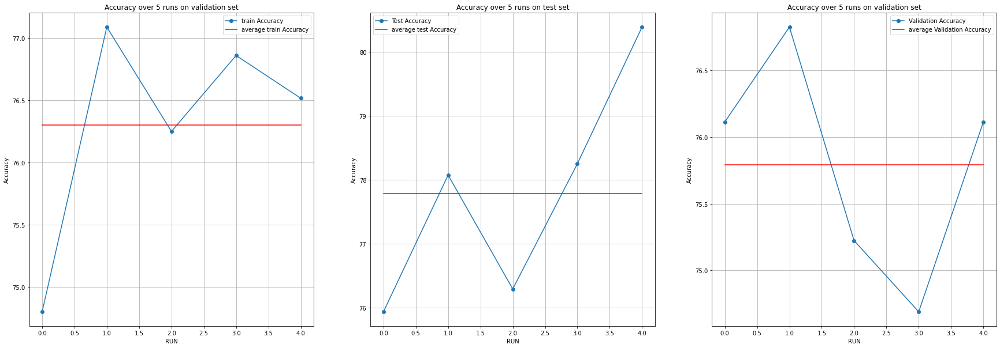

<Figure size 1080x1080 with 0 Axes>

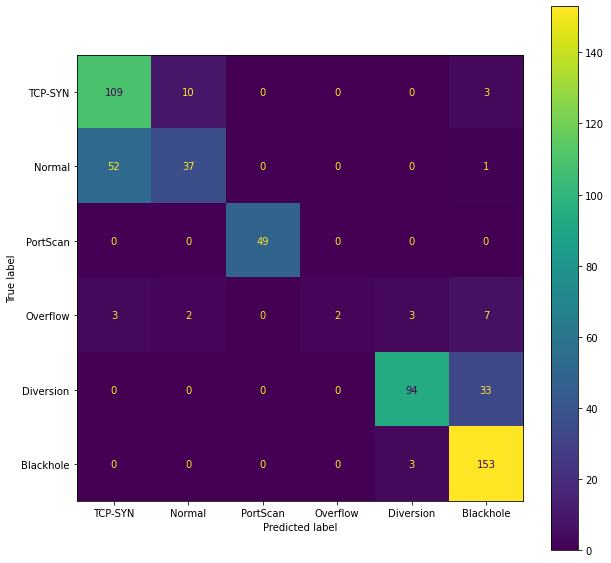

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=best_n,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)
mean_acccurcies_act.append(df.iloc[2,3])
act_hist.append(df)

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 0.9724 - accuracy: 0.5670 - val_loss: 0.7820 - val_accuracy: 0.6684
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8033 - accuracy: 0.6350 - val_loss: 0.6959 - val_accuracy: 0.6791
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7982 - accuracy: 0.6239 - val_loss: 0.7010 - val_accuracy: 0.6720
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7649 - accuracy: 0.6525 - val_loss: 0.6900 - val_accuracy: 0.6827
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7755 - accuracy: 0.6544 - val_loss: 0.7310 - val_accuracy: 0.6061
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7280 - accuracy: 0.6556 - val_loss: 0.6816 - val_accuracy: 0.6898
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7941 - accuracy: 0.6487 - val_loss: 0.7015 - val_accuracy: 0.6738
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,68.690342,68.983960,66.488415
1,maxmum Accuracy,74.875909,77.005345,75.222814
2,average Accuracy,72.859870,74.046346,72.584670


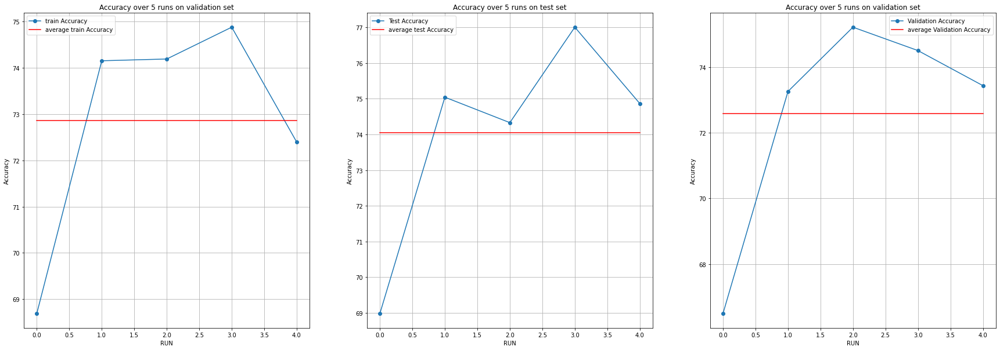

<Figure size 1080x1080 with 0 Axes>

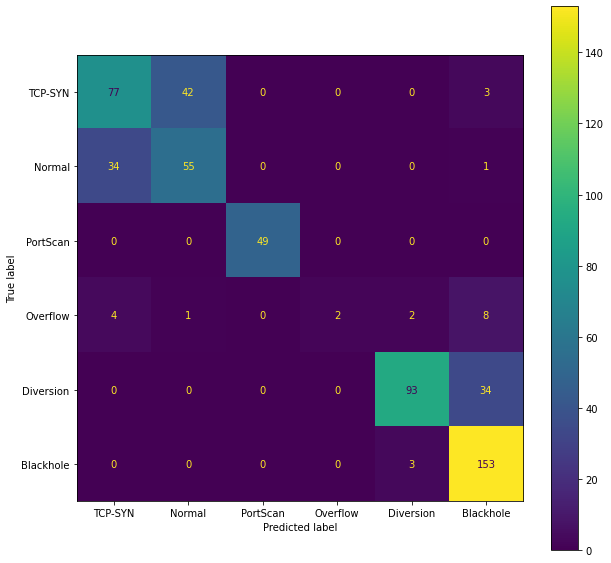

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=best_n,opt=optmizer,batch_size=best_bs,act_f='LeakyRelu',stop_early=True)
df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)
mean_acccurcies_act.append(df.iloc[2,3])
act_hist.append(df)

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.6730 - accuracy: 0.2360 - val_loss: 1.5870 - val_accuracy: 0.3030
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 1.3644 - accuracy: 0.3688 - val_loss: 1.2289 - val_accuracy: 0.4617
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 1.0861 - accuracy: 0.5086 - val_loss: 1.0858 - val_accuracy: 0.4973
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.9315 - accuracy: 0.5781 - val_loss: 0.9366 - val_accuracy: 0.4795
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8791 - accuracy: 0.6029 - val_loss: 1.1700 - val_accuracy: 0.5062
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8619 - accuracy: 0.5888 - val_loss: 0.7345 - val_accuracy: 0.6684
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8141 - accuracy: 0.6075 - val_loss: 0.7382 - val_accuracy: 0.6649
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.721270,71.657753,72.192514
1,maxmum Accuracy,73.310423,77.005345,74.331552
2,average Accuracy,71.920581,74.010694,73.368984


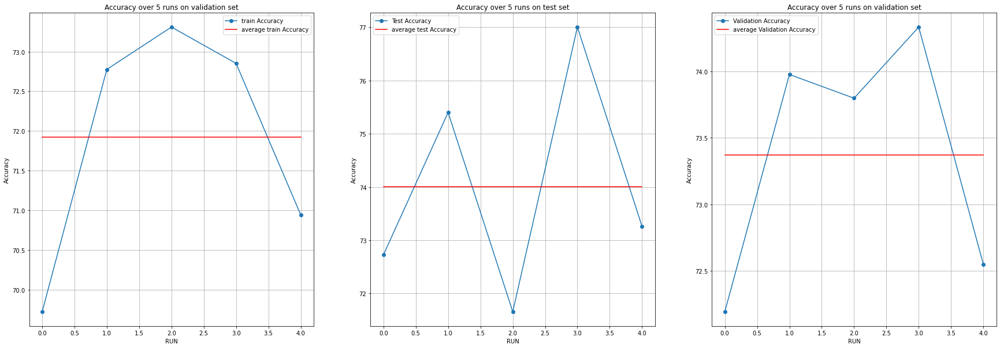

<Figure size 1080x1080 with 0 Axes>

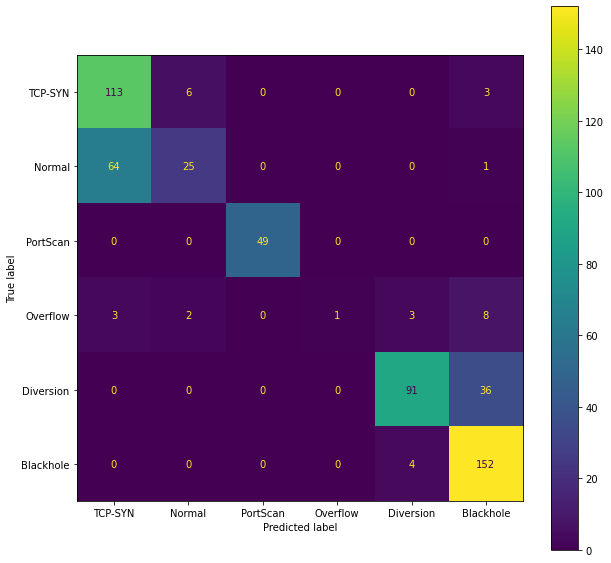

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=best_n,opt=optmizer,batch_size=best_bs,act_f='sigmoid',stop_early=True)
df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)
mean_acccurcies_act.append(df.iloc[2,3])
act_hist.append(df)

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 0.9642 - accuracy: 0.5521 - val_loss: 1.0322 - val_accuracy: 0.5312
Epoch 2/500
41/41 [==============================] - 0s 2ms/step - loss: 0.8135 - accuracy: 0.6037 - val_loss: 0.8385 - val_accuracy: 0.5668
Epoch 3/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7873 - accuracy: 0.6189 - val_loss: 0.7225 - val_accuracy: 0.6346
Epoch 4/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7403 - accuracy: 0.6537 - val_loss: 0.6554 - val_accuracy: 0.7023
Epoch 5/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7467 - accuracy: 0.6445 - val_loss: 0.7126 - val_accuracy: 0.6310
Epoch 6/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7240 - accuracy: 0.6712 - val_loss: 0.6560 - val_accuracy: 0.7112
Epoch 7/500
41/41 [==============================] - 0s 2ms/step - loss: 0.7138 - accuracy: 0.6678 - val_loss: 0.6840 - val_accuracy: 0.6257
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,73.501337,72.727275,72.370768
1,maxmum Accuracy,76.212293,77.183598,75.757575
2,average Accuracy,75.173731,75.115864,74.581105


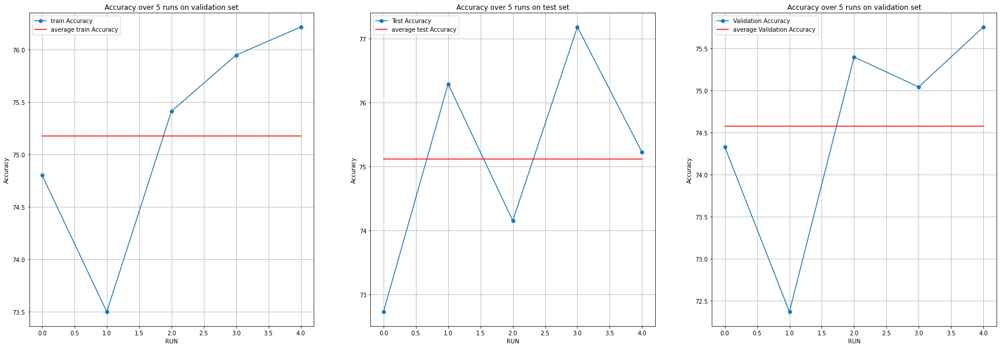

<Figure size 1080x1080 with 0 Axes>

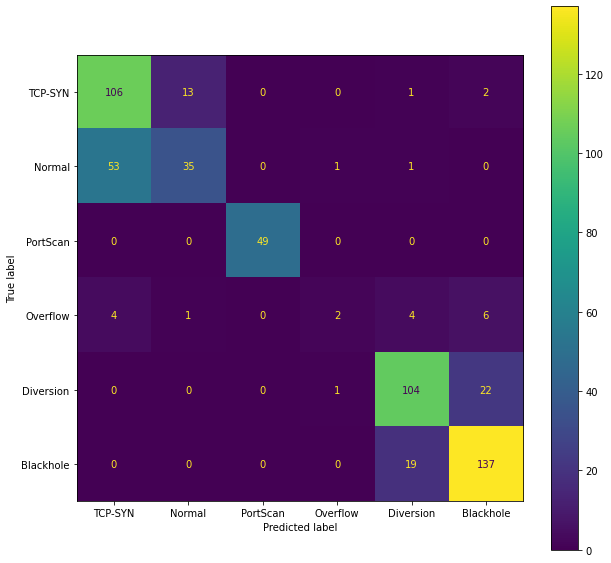

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=best_n,opt=optmizer,batch_size=best_bs,act_f='tanh',stop_early=True)
df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)
mean_acccurcies_act.append(df.iloc[2,3])
act_hist.append(df)

In [ ]:
mean_acccurcies_act

[75.79322695732117, 72.58466958999634, 73.36898446083069, 74.58110451698303]

In [ ]:
print('The best activation function is {} and it achieved {}% average validation accuracy'.format(act_ls[np.argmax(mean_acccurcies_act)],max(mean_acccurcies_act)))

The best activation function is relu and it achieved 75.79322695732117% validation accuracy


In [ ]:
mean_acccurcies_act_test=[]
for df in act_hist:
  mean_acccurcies_act_test.append(df.iloc[2,2])


In [ ]:
mean_acccurcies_act_test

[77.78966188430786, 74.04634594917297, 74.01069402694702, 75.11586427688599]

In [ ]:
print('The best activation function is {} and it achieved {}% average test accuracy'.format(act_ls[np.argmax(mean_acccurcies_act_test)],max(mean_acccurcies_act_test)))

The best activation function is relu and it achieved 77.78966188430786% average test accuracy


<a id="15"></a> <br>
### Q3.5) Bonus question

#### Oversampling

In [ ]:
oversample = SMOTE()
X_train_f_s, y_train_s = oversample.fit_resample(X_train_f, np.argmax(y_train,axis=1))

In [ ]:
y_train_s=tf.keras.utils.to_categorical(
    y_train_s, num_classes=num_class, dtype='float32'
)

Epoch 1/500
63/63 [==============================] - 1s 6ms/step - loss: 0.9859 - accuracy: 0.5415 - val_loss: 0.7629 - val_accuracy: 0.6791
Epoch 2/500
63/63 [==============================] - 0s 2ms/step - loss: 0.8289 - accuracy: 0.6189 - val_loss: 0.7597 - val_accuracy: 0.5954
Epoch 3/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7924 - accuracy: 0.6354 - val_loss: 0.7630 - val_accuracy: 0.6292
Epoch 4/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7747 - accuracy: 0.6389 - val_loss: 0.7695 - val_accuracy: 0.6417
Epoch 5/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7541 - accuracy: 0.6471 - val_loss: 0.6690 - val_accuracy: 0.6488
Epoch 6/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7582 - accuracy: 0.6529 - val_loss: 0.7627 - val_accuracy: 0.6061
Epoch 7/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7543 - accuracy: 0.6514 - val_loss: 0.7121 - val_accuracy: 0.6417
Epoch 8/500
6

,Accuracy,Train,Test,Validation
0,minimum Accuracy,63.338339,62.923354,59.893048
1,maxmum Accuracy,73.673671,76.470590,72.727275
2,average Accuracy,70.320320,69.126559,66.844920


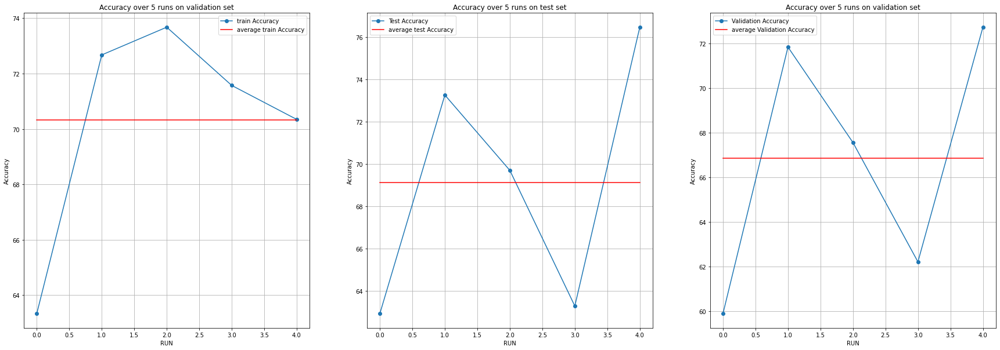

<Figure size 1080x1080 with 0 Axes>

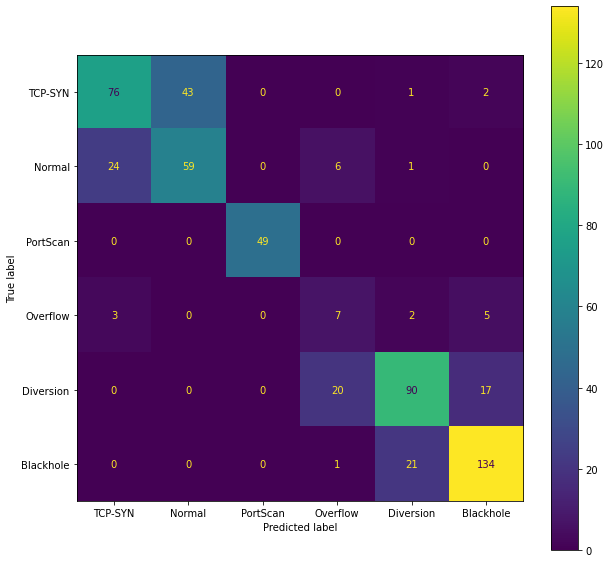

In [ ]:
model_s=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=best_n,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model_s.over_multi_run(5,X_train_f_s,y_train_s,X_test_f,y_test,X_val_f,y_val,l)

#### Tunning number of hidden neurons

In [ ]:
mean_acccurcies_tuned=[]
ner_ls=[40,80,120,160,200]
tuned_hist = []

Epoch 1/500
63/63 [==============================] - 1s 5ms/step - loss: 0.9899 - accuracy: 0.5390 - val_loss: 0.8921 - val_accuracy: 0.6007
Epoch 2/500
63/63 [==============================] - 0s 2ms/step - loss: 0.8247 - accuracy: 0.6251 - val_loss: 0.8204 - val_accuracy: 0.6667
Epoch 3/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7977 - accuracy: 0.6261 - val_loss: 0.7531 - val_accuracy: 0.6399
Epoch 4/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7810 - accuracy: 0.6409 - val_loss: 0.9667 - val_accuracy: 0.5365
Epoch 5/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7603 - accuracy: 0.6469 - val_loss: 0.7279 - val_accuracy: 0.6471
Epoch 6/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7713 - accuracy: 0.6547 - val_loss: 0.7300 - val_accuracy: 0.6399
Epoch 7/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7325 - accuracy: 0.6579 - val_loss: 0.6771 - val_accuracy: 0.6934
Epoch 8/500
6

,Accuracy,Train,Test,Validation
0,minimum Accuracy,70.770770,65.775400,62.388593
1,maxmum Accuracy,74.949950,73.975044,72.370768
2,average Accuracy,73.223222,69.447415,67.807487


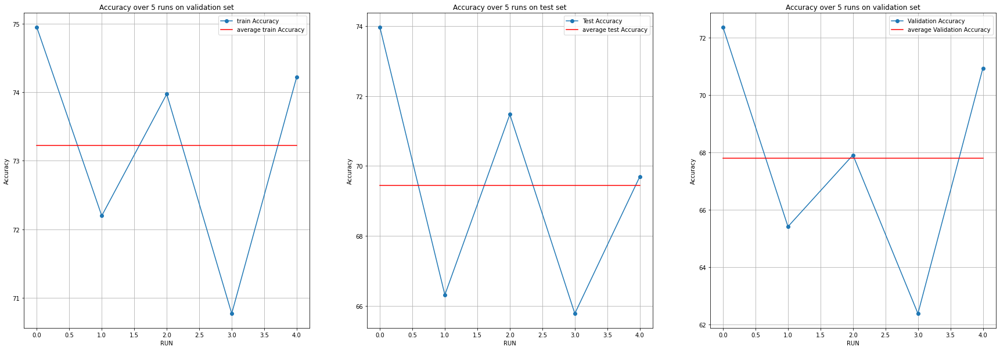

<Figure size 1080x1080 with 0 Axes>

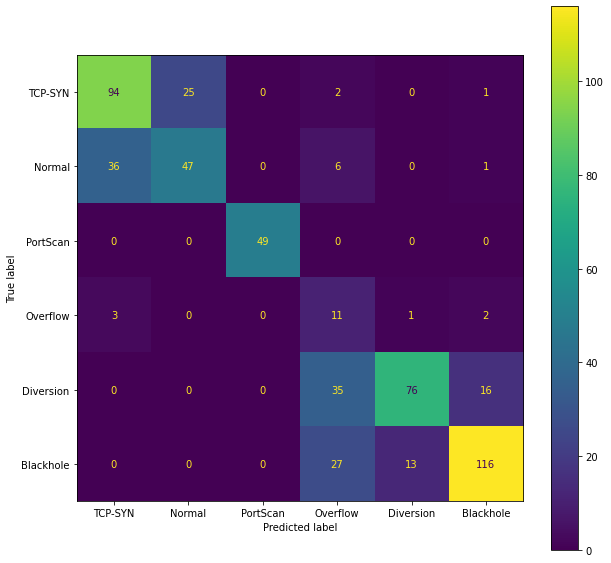

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=40,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f_s,y_train_s,X_test_f,y_test,X_val_f,y_val,l)
tuned_hist.append(df)
mean_acccurcies_tuned.append(df.iloc[2,3])


Epoch 1/500
63/63 [==============================] - 1s 5ms/step - loss: 1.0684 - accuracy: 0.5083 - val_loss: 0.8438 - val_accuracy: 0.5936
Epoch 2/500
63/63 [==============================] - 0s 2ms/step - loss: 0.8677 - accuracy: 0.6021 - val_loss: 0.9466 - val_accuracy: 0.5045
Epoch 3/500
63/63 [==============================] - 0s 2ms/step - loss: 0.8052 - accuracy: 0.6254 - val_loss: 0.8407 - val_accuracy: 0.5704
Epoch 4/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7915 - accuracy: 0.6351 - val_loss: 0.7780 - val_accuracy: 0.6560
Epoch 5/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7760 - accuracy: 0.6406 - val_loss: 0.7363 - val_accuracy: 0.6774
Epoch 6/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7637 - accuracy: 0.6461 - val_loss: 0.8246 - val_accuracy: 0.6346
Epoch 7/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7798 - accuracy: 0.6532 - val_loss: 0.6915 - val_accuracy: 0.6720
Epoch 8/500
6

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.744742,68.449199,65.775400
1,maxmum Accuracy,75.750750,73.262030,70.766491
2,average Accuracy,72.697698,70.445633,68.484850


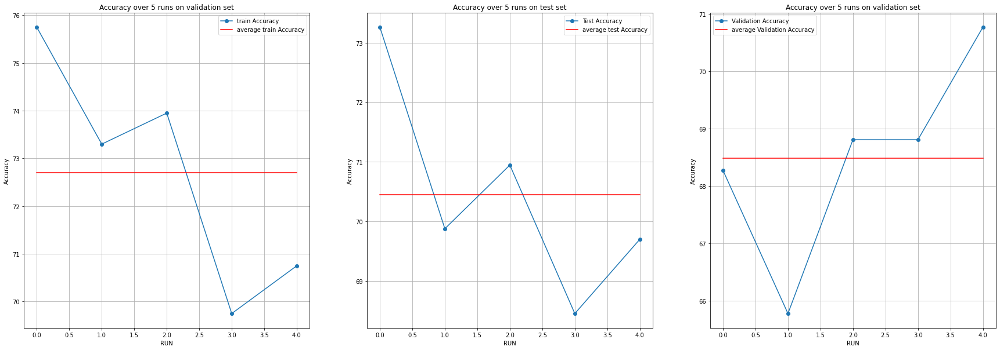

<Figure size 1080x1080 with 0 Axes>

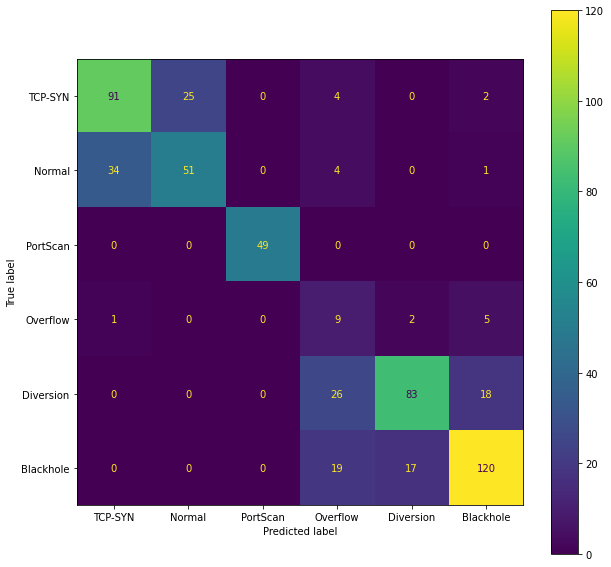

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=80,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f_s,y_train_s,X_test_f,y_test,X_val_f,y_val,l)
tuned_hist.append(df)
mean_acccurcies_tuned.append(df.iloc[2,3])

Epoch 1/500
63/63 [==============================] - 1s 5ms/step - loss: 1.0717 - accuracy: 0.5093 - val_loss: 1.0481 - val_accuracy: 0.5579
Epoch 2/500
63/63 [==============================] - 0s 2ms/step - loss: 0.8640 - accuracy: 0.5991 - val_loss: 0.9125 - val_accuracy: 0.5365
Epoch 3/500
63/63 [==============================] - 0s 2ms/step - loss: 0.8183 - accuracy: 0.6196 - val_loss: 0.7680 - val_accuracy: 0.6310
Epoch 4/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7912 - accuracy: 0.6306 - val_loss: 0.7658 - val_accuracy: 0.6720
Epoch 5/500
63/63 [==============================] - 0s 3ms/step - loss: 0.8021 - accuracy: 0.6369 - val_loss: 0.8248 - val_accuracy: 0.6150
Epoch 6/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7647 - accuracy: 0.6444 - val_loss: 0.7227 - val_accuracy: 0.6524
Epoch 7/500
63/63 [==============================] - 0s 2ms/step - loss: 0.7486 - accuracy: 0.6552 - val_loss: 1.9223 - val_accuracy: 0.5169
Epoch 8/500
6

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.369370,63.814616,62.388593
1,maxmum Accuracy,72.397399,70.053476,69.162208
2,average Accuracy,71.511512,67.130125,66.203208


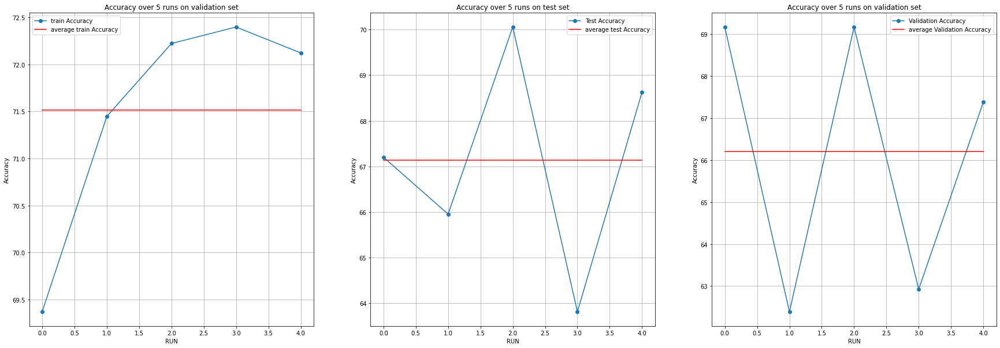

<Figure size 1080x1080 with 0 Axes>

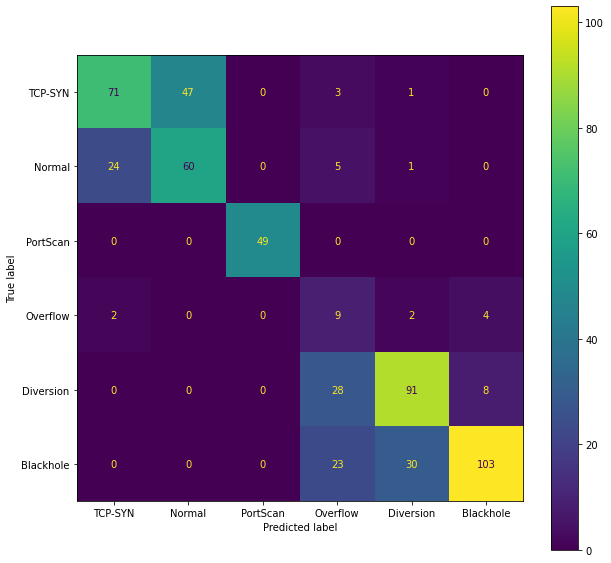

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=120,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f_s,y_train_s,X_test_f,y_test,X_val_f,y_val,l)
tuned_hist.append(df)
mean_acccurcies_tuned.append(df.iloc[2,3])

Epoch 1/500
63/63 [==============================] - 1s 6ms/step - loss: 1.1493 - accuracy: 0.4927 - val_loss: 0.9177 - val_accuracy: 0.5900
Epoch 2/500
63/63 [==============================] - 0s 3ms/step - loss: 0.8814 - accuracy: 0.5921 - val_loss: 0.8948 - val_accuracy: 0.6025
Epoch 3/500
63/63 [==============================] - 0s 3ms/step - loss: 0.8630 - accuracy: 0.6294 - val_loss: 0.7799 - val_accuracy: 0.5989
Epoch 4/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7940 - accuracy: 0.6331 - val_loss: 0.7300 - val_accuracy: 0.6221
Epoch 5/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7983 - accuracy: 0.6346 - val_loss: 0.7323 - val_accuracy: 0.6774
Epoch 6/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7946 - accuracy: 0.6444 - val_loss: 0.7713 - val_accuracy: 0.6061
Epoch 7/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7515 - accuracy: 0.6569 - val_loss: 0.6862 - val_accuracy: 0.6970
Epoch 8/500
6

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.094092,64.171124,63.636363
1,maxmum Accuracy,74.949950,72.370768,70.409983
2,average Accuracy,71.791791,68.948307,67.522281


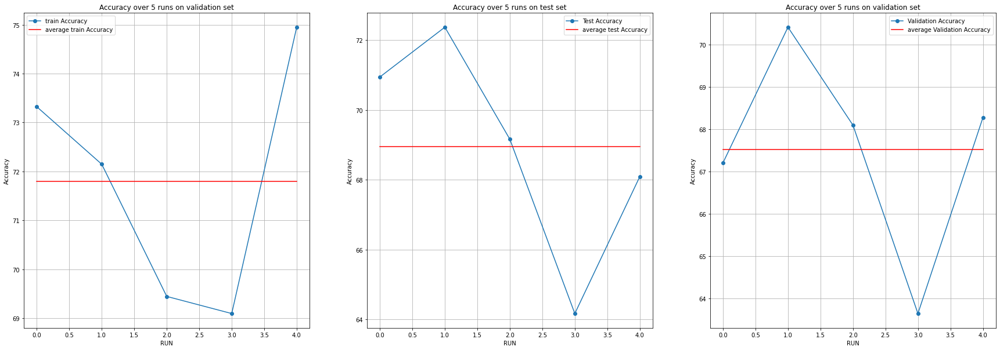

<Figure size 1080x1080 with 0 Axes>

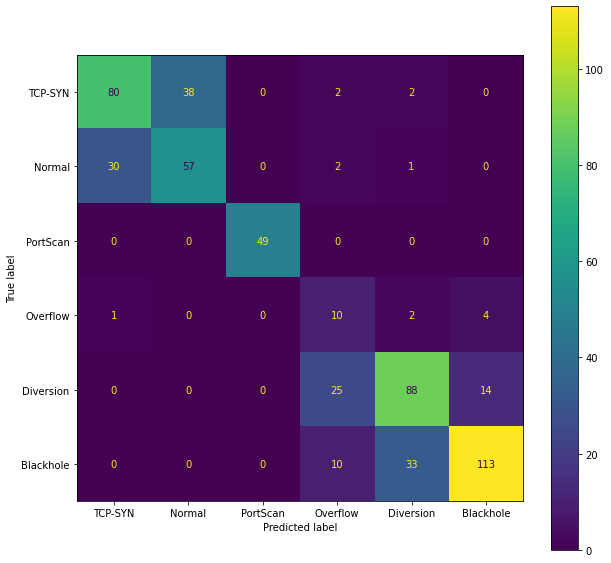

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=160,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f_s,y_train_s,X_test_f,y_test,X_val_f,y_val,l)
tuned_hist.append(df)
mean_acccurcies_tuned.append(df.iloc[2,3])

Epoch 1/500
63/63 [==============================] - 1s 6ms/step - loss: 1.1570 - accuracy: 0.4882 - val_loss: 0.9036 - val_accuracy: 0.6168
Epoch 2/500
63/63 [==============================] - 0s 3ms/step - loss: 0.8785 - accuracy: 0.5803 - val_loss: 1.1671 - val_accuracy: 0.3975
Epoch 3/500
63/63 [==============================] - 0s 3ms/step - loss: 1.0178 - accuracy: 0.6151 - val_loss: 0.8668 - val_accuracy: 0.6096
Epoch 4/500
63/63 [==============================] - 0s 3ms/step - loss: 0.8132 - accuracy: 0.6281 - val_loss: 0.7952 - val_accuracy: 0.6791
Epoch 5/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7918 - accuracy: 0.6324 - val_loss: 0.8193 - val_accuracy: 0.6257
Epoch 6/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7783 - accuracy: 0.6416 - val_loss: 0.7767 - val_accuracy: 0.6257
Epoch 7/500
63/63 [==============================] - 0s 3ms/step - loss: 0.7764 - accuracy: 0.6522 - val_loss: 0.7254 - val_accuracy: 0.6381
Epoch 8/500
6

,Accuracy,Train,Test,Validation
0,minimum Accuracy,69.944942,67.379677,67.379677
1,maxmum Accuracy,74.374372,73.975044,72.727275
2,average Accuracy,72.587587,70.837789,69.162210


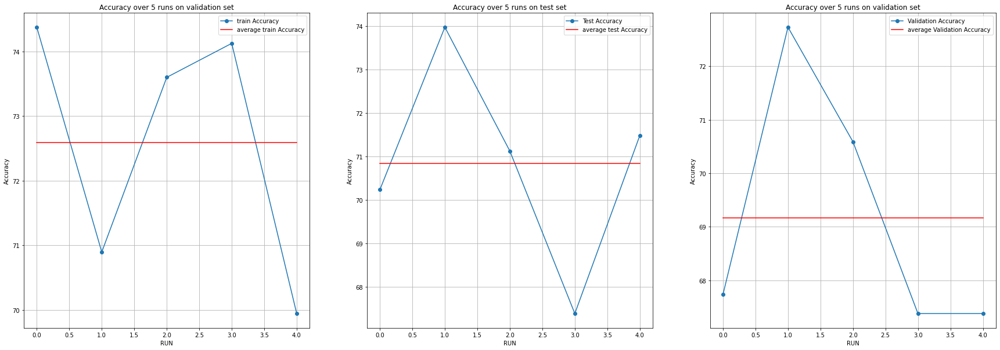

<Figure size 1080x1080 with 0 Axes>

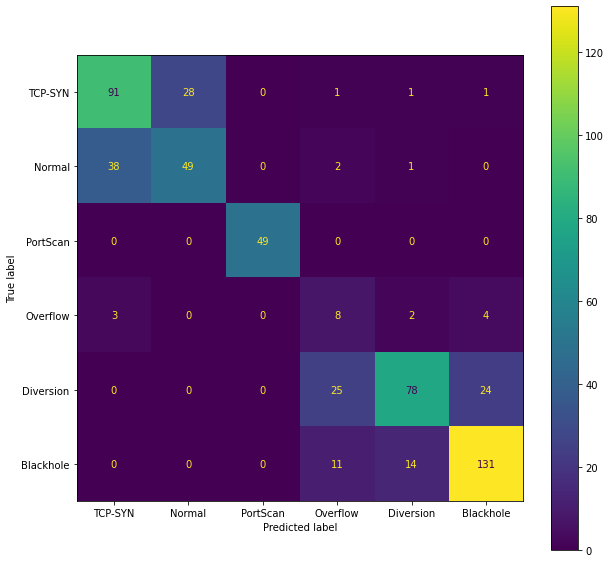

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=200,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f_s,y_train_s,X_test_f,y_test,X_val_f,y_val,l)
tuned_hist.append(df)
mean_acccurcies_tuned.append(df.iloc[2,3])

#### Tuner

In [ ]:
!pip install keras-tuner -q
import keras_tuner

     |████████████████████████████████| 135 kB 6.9 MB/s 


In [ ]:
def build_model(hp):
    model = keras.Sequential()
    model.add(layers.Flatten())

    for i in range(hp.Int("num_layers",  min_value=4, max_value=4)):
        model.add(
            layers.Dense(
                # Tune number of units separately.
                units=hp.Int(f"units_{i}", min_value=32, max_value=256, step=32),
                activation=hp.Choice("activation", ["relu"]),
            )
        )
    model.add(layers.Dense(6, activation="softmax"))
    learning_rate = hp.Float("lr", min_value=1e-4, max_value=1e-2, sampling="log")
    model.compile(
        optimizer=keras.optimizers.RMSprop(learning_rate=learning_rate),
        loss="categorical_crossentropy",
        metrics=["accuracy"],
    )
    return model


build_model(keras_tuner.HyperParameters())

In [ ]:
tuner = keras_tuner.RandomSearch(
    hypermodel=build_model,
    objective="val_accuracy",
    max_trials=5,
    executions_per_trial=2,
    overwrite=True,
    directory="my_dir",
    project_name="ML",
)

In [ ]:
tuner.search_space_summary()

Search space summary
Default search space size: 7
num_layers (Int)
{'default': None, 'conditions': [], 'min_value': 4, 'max_value': 4, 'step': 1, 'sampling': None}
units_0 (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 256, 'step': 32, 'sampling': None}
activation (Choice)
{'default': 'relu', 'conditions': [], 'values': ['relu'], 'ordered': False}
units_1 (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 256, 'step': 32, 'sampling': None}
units_2 (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 256, 'step': 32, 'sampling': None}
units_3 (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 256, 'step': 32, 'sampling': None}
lr (Float)
{'default': 0.0001, 'conditions': [], 'min_value': 0.0001, 'max_value': 0.01, 'step': None, 'sampling': 'log'}


In [ ]:
tuner.search(X_train_f,y_train,epochs=100, validation_data=(X_val_f,y_val))

Trial 5 Complete [00h 00m 36s]
val_accuracy: 0.7540107071399689

Best val_accuracy So Far: 0.7789661288261414
Total elapsed time: 00h 03m 30s
INFO:tensorflow:Oracle triggered exit


In [ ]:
models = tuner.get_best_models(num_models=2)
best_model = models[0]
# Build the model.
# Needed for `Sequential` without specified `input_shape`.
best_model.build(input_shape=(None, 4))
best_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 4)                 0         
                                                                 
 dense (Dense)               (None, 160)               800       
                                                                 
 dense_1 (Dense)             (None, 96)                15456     
                                                                 
 dense_2 (Dense)             (None, 160)               15520     
                                                                 
 dense_3 (Dense)             (None, 96)                15456     
                                                                 
 dense_4 (Dense)             (None, 6)                 582       
                                                                 
Total params: 47,814
Trainable params: 47,814
Non-traina

Epoch 1/500
41/41 [==============================] - 1s 7ms/step - loss: 1.0857 - accuracy: 0.5193 - val_loss: 0.8155 - val_accuracy: 0.6684
Epoch 2/500
41/41 [==============================] - 0s 3ms/step - loss: 0.8105 - accuracy: 0.6197 - val_loss: 0.7205 - val_accuracy: 0.6310
Epoch 3/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7919 - accuracy: 0.6380 - val_loss: 0.6885 - val_accuracy: 0.7166
Epoch 4/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7318 - accuracy: 0.6598 - val_loss: 0.6551 - val_accuracy: 0.7166
Epoch 5/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7265 - accuracy: 0.6552 - val_loss: 0.7002 - val_accuracy: 0.6791
Epoch 6/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7244 - accuracy: 0.6701 - val_loss: 0.6525 - val_accuracy: 0.7023
Epoch 7/500
41/41 [==============================] - 0s 3ms/step - loss: 0.7100 - accuracy: 0.6735 - val_loss: 0.7192 - val_accuracy: 0.7077
Epoch 8/500
4

,Accuracy,Train,Test,Validation
0,minimum Accuracy,74.608630,75.935829,74.153298
1,maxmum Accuracy,77.205038,79.500890,75.935829
2,average Accuracy,76.342115,77.967914,74.973263


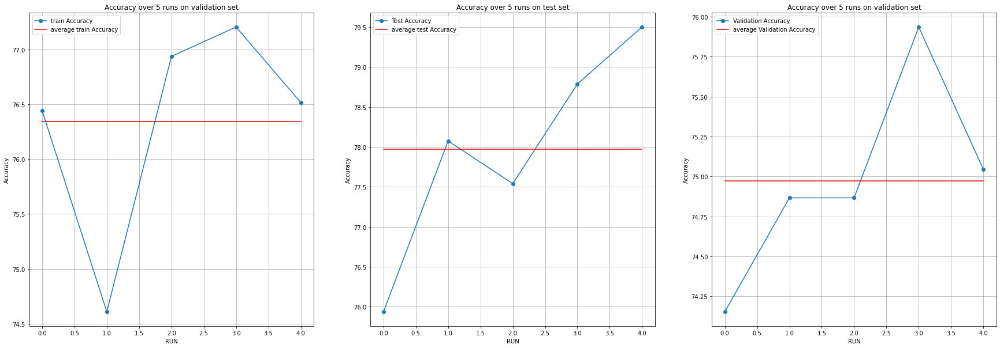

<Figure size 1080x1080 with 0 Axes>

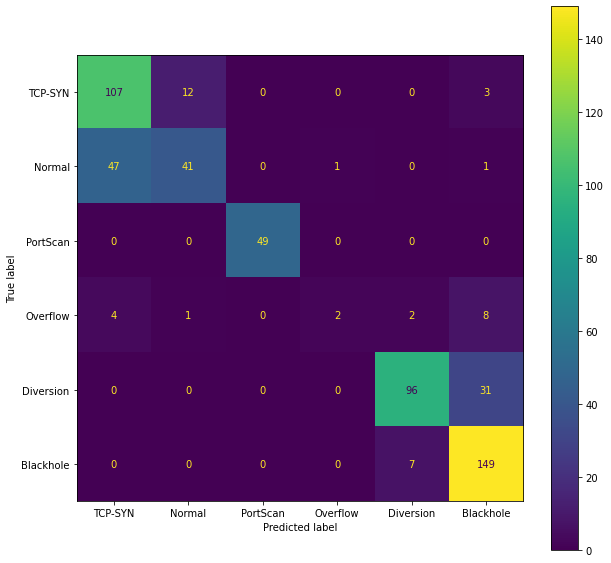

In [ ]:
model=MLP(4,num_class,epochs=500,num_hidden_layer=best_h,neurons_each_layer=96,opt=optmizer,batch_size=best_bs,act_f='relu',stop_early=True)
df=model.over_multi_run(5,X_train_f,y_train,X_test_f,y_test,X_val_f,y_val,l)

<hr style="border: solid 3px Brown;">
<a id="16"></a> <br>

## <center><span style="font-family:Arial; font-style: italic;">Conclusion</span></center>
